# Import files

If you run this notebook on google colab you need to upload python scripts on the left panel.
To that end click on the left "Files" (or "Fichiers" in French) and drag and drop :
- python scripts from "Code" folder of github repository.
- csv files or xls files from "data" folder.
- Tensorflow model (files with .data or .index extensions) in the "Results" folder if you want to use neural network while avoiding the training step.
- csv files in "Results" folder if you want load Results presented in our paper.


In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import sklearn as skl


import bootstrapping
import dataSetConstruction
import backtest
import BS
import loadData
import plotTools
import SSVI
import neuralNetwork


import importlib

Instructions for updating:
non-resource variables are not supported in the long term


# Load data

In order to reproduce our paper experiments, execute cells from part "Load preformatted data". 

Each source of data produces the following objects : 
- bootstrap manages discounting and dividend.
- dataSet contains the training set.
- dataSetTest contains the testing set.
- $S0$ the spot value of the underlying 

#### DAX Data

For each day you need to load six csv files :
- *underlying.csv* for the stock value.
- *locvol.csv* for the local volatility calibrated with tree pricing and tikhonov volatility (see Crépey (2002)).
- *dividend.csv* for dividend extracted from put-call parity.
- *discount.csv* for zero-coupon curve. 
- *dataTrain.csv* for prices and/or implied volatility used in training set.
- *dataTest.csv* for prices and/or implied volatility used in testing set.
- "8_8_2001__filterdax.dat" for tikohnov local volatility.

In [2]:
workingFolder = "./"#"./data/09082001/"

Bootstrap discounting


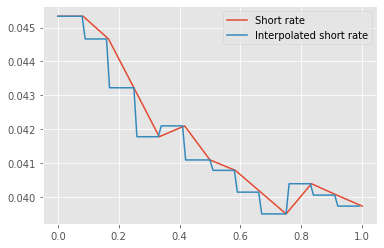

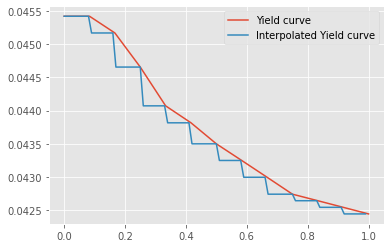

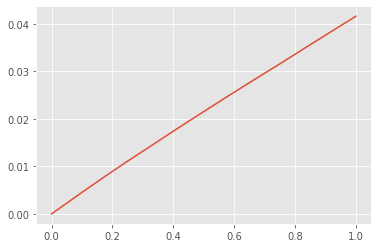

Bootstrap dividend


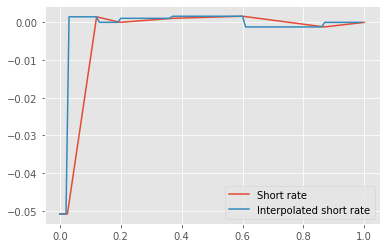

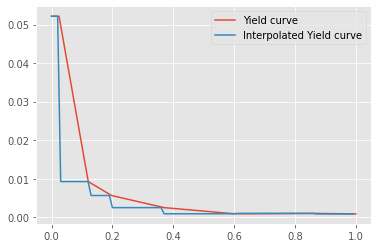

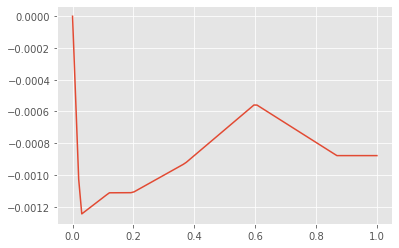

In [3]:
#Read csv files as dataFrames
trainingSet, testingSet, bootstrap, S0 = loadData.loadDataFromCSV(workingFolder,
                                                                  "8_8_2001__filterdax")

#### From Dat files (DAX data)
For a day x you must load :
- "x.dat.modelparam.dat"
- "x.dat.impliedvol.dat"
- "x.dat.calibr.out.dat"
- "x.dat"

In [ ]:
trainingSet, testingSet, bootstrap, S0 = loadData.loadDataFromDat(workingFolder,
                                                                  "9_8_2001__filterdax")

In [ ]:
importlib.reload(loadData)

In [ ]:
pd.options.mode.chained_assignment = 'raise'

#### SPX Data

File required : 
- yieldCurve.dat.
- Option_SPX_18_Mai_2019Feuille2.xlsm

In [ ]:
workingFolder = "./"#"./data/"
fileName = "Option_SPX_18_Mai_2019Feuille2.xlsm"
asOfDate = "2019-05-18"
trainingSet, testingSet, bootstrap, S0 = loadData.loadCBOTData(workingFolder, fileName, asOfDate)

In [ ]:
importlib.reload(loadData)

####  Eurostoxx data

File required : Data_EuroStoxx50_20190110_all_for_Marc.xlsx

In [ ]:
workingFolder = "./data/"
asOfDate = "2019-01-10"
filename = "Data_EuroStoxx50_20190110_all_for_Marc.xlsx"
trainingSet, testingSet, bootstrap, S0 = loadData.loadESXData(workingFolder, filename, asOfDate)

In [ ]:
bootstrap.discountShortRate(10)

#### Load preformatted data

File required : 
- testingDataSet.csv
- trainingDataSet.csv
- dfCurve.csv

In [ ]:
workingFolder = "./"#"./data/"
trainingSet, testingSet, bootstrap, S0 = loadData.loadFormattedData(workingFolder)

# Formatting data

### Bootstrapping Rate Curve methodology


We assume a piecewise constant discount short rate $r$ and a piecewise constant dividend short rate $q$.

We estimate the "zero coupon dividend" $D(T) = e^{-\int_{0}^{T} q_s ds}$ by regressing it against maturity :
$$e^{-\int_{0}^{T} q_s ds} = \frac{C(T,K) - P(T,K) + K e^{-\int_{0}^{T} r_s ds}}{S_0}$$


Then we have $\hat{q}_t = - \frac{ \log{D(\overline{T})} - \log{D(\underline{T})} }{ \overline{T} - \underline{T} }$ with $\overline{T}$ the smallest discretized maturity greater than $T$ and $\underline{T}$ the grestest discretized maturity inferior than $T$.

bootstrap object has several members :
- **riskFreeIntegral** corresponds to $I_T = \int_{0}^{T} r_u du$.
- **riskFreeSpline**  corresponds to $r_u$ evaluated on a subgrid. Interpolated as step function from zero coupons
- **divSpreadIntegral** corresponds to $I_T = \int_{0}^{T} q_u du$, can be negative.
- **divSpline**  corresponds to $q_u$ evaluated on a subgrid, can be negative.

These curve should satisfy the call-put parity.

#### Change of variable

Neural network on modified prices with modified strike as input such that discounting and dividend don't intervene in Dupire formula calculation.


- In presence of dividend rate $d$ and risk free rate $r$ Dupire formula is :   $$\sigma^2(T,K) = 2 \frac{ \partial_T P(T,K) + (r-q) K \partial_K P(T,K) + qP(T,K)}{K² \partial_{K}^2 P(T,K)}$$ 
with Strike $K$, Maturity $T$, dividend rate $q$ and risk-free rate $r$, $P$ our pricing function. 
- We apply the following change of variable : $$ w(T,k) = \exp{(\int_{0}^{T} q_t dt)} P(T,K)$$ with $K = k \exp{(\int_{0}^{T} (r_t - q_t) dt)} $.
- Then Dupire equation becomes :  $\sigma^2(T,K) = 2 \frac{ \partial_T w(T,k)}{k² \partial_{k}^2 w(T,k)}$. 
- If we learn the mapping $v$ with a neural network then we obtain quickly by adjoint differentiation $\partial_T w$ and $\partial_{k²}^2 w$ and therefore $\sigma$.
- $k$ corresponds to "ChangedStrike" column.
- $\exp{(\int_{0}^{T} q_t dt)}$ corresponds to "DividendFactor" column.


In [ ]:
#dataSetConstruction.checkCallPutParity(pd.concat([trainingSet, testingSet]), 
#                                       S0, 
#                                       bootstrap)

In [4]:
dataSet = trainingSet #Training set
dataSetTest = testingSet #Testing set
dataSet.head()

Price     Delta  ...  impliedTotalVariance    locvol
Strike Maturity                      ...                                
3600   0.000     2014.510  1.000000  ...              0.000000  0.280101
       0.000        0.000 -0.000000  ...              0.000000  0.280101
       0.370        0.619 -0.002239  ...              0.027981  0.231215
       0.600        4.413 -0.010084  ...              0.045046  0.235289
       0.868       10.910 -0.019355  ...              0.061416  0.234563

[5 rows x 16 columns]

In [5]:
dataSetTest.head()

Price     Delta  ...  impliedTotalVariance    locvol
Strike  Maturity                         ...                                
4107.46 0.000     1507.050000  1.000000  ...              0.000000  0.280101
        0.000        0.000000 -0.000000  ...              0.000000  0.280101
        0.200        0.798658 -0.003631  ...              0.015125  0.247411
        0.242        1.851485 -0.007099  ...              0.018510  0.261716
        0.284        3.592550 -0.011839  ...              0.022216  0.281613

[5 rows x 16 columns]

In [6]:
#Run this cell if you want to record your datasets
dfCurve = dataSetConstruction.savingData(bootstrap, 
                                         dataSet, 
                                         dataSetTest, 
                                         workingFolder)

Saving bootstrapping under dfCurve.csv
Saving training set under trainingDataSet.csv
Saving bootstrapping under testingDataSet.csv


In [7]:
#Size of training set
dataSet.shape

(316, 16)

In [8]:
#Size of testing set
dataSetTest.shape

(378, 16)

In [9]:
S0

5614.51

In [10]:
#Threshold for eliminating low prices 
threshold = pd.concat([dataSet, dataSetTest])["Price"].sort_values().iloc[int(0.05 * pd.concat([dataSet, dataSetTest]).shape[0])]

In [11]:
def getCall(df):
    return df[df["OptionType"]==1]
def getPut(df):
    return df[df["OptionType"]==-1]

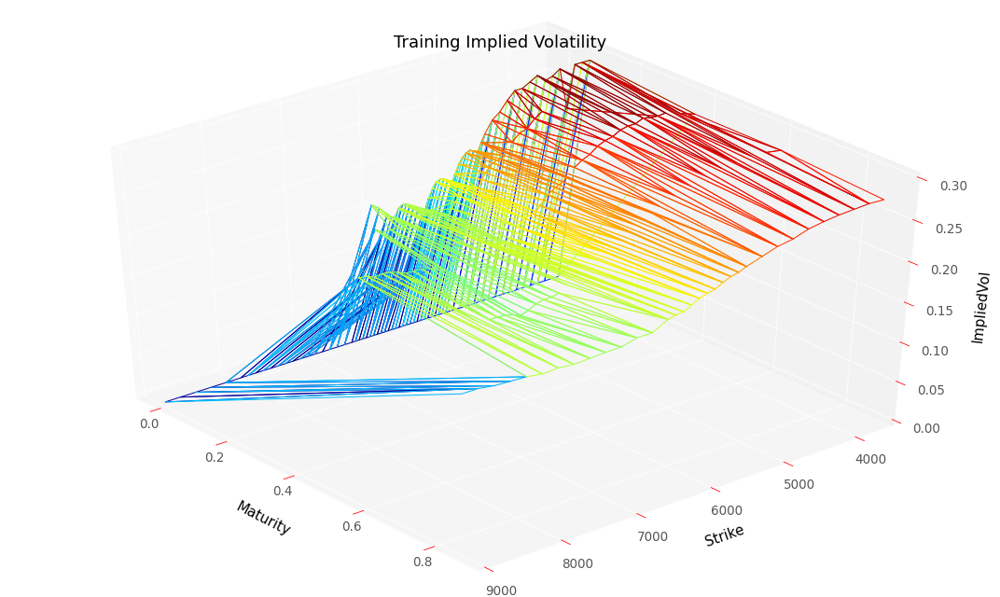

In [12]:
plotTools.plotSerie(getPut(trainingSet)["ImpliedVol"], 
                    yMin=0,
                    yMax=3*S0, 
                    Title = 'Training Implied Volatility')

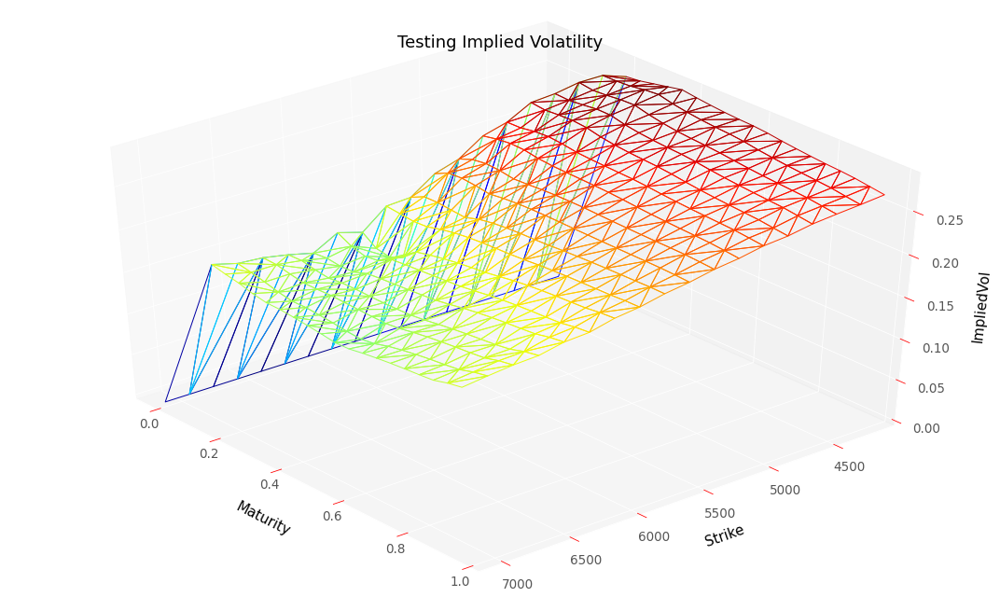

In [13]:
plotTools.plotSerie(getPut(testingSet)["ImpliedVol"], 
                    yMin=0,
                    yMax=3*S0, 
                    Title = 'Testing Implied Volatility')

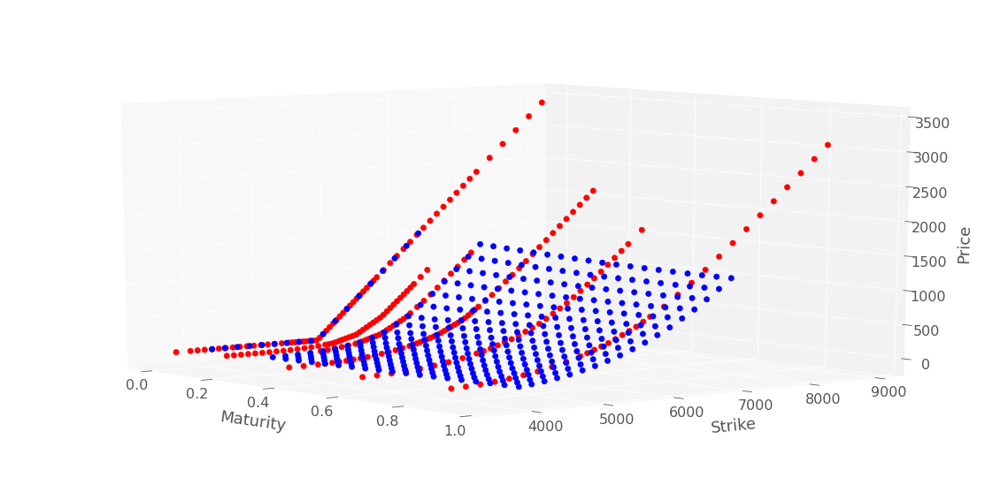

In [14]:
plotTools.plot2Series(getPut(testingSet)["Price"], 
                      getPut(trainingSet)["Price"], 
                      yMin=0,
                      yMax=3*S0, 
                      Title = 'Price Surfaces')

In [15]:
testingSet.shape

(378, 16)

In [16]:
trainingSet.shape

(316, 16)

In [17]:
dataSet.head()

Price     Delta  ...  impliedTotalVariance    locvol
Strike Maturity                      ...                                
3600   0.000     2014.510  1.000000  ...              0.000000  0.280101
       0.000        0.000 -0.000000  ...              0.000000  0.280101
       0.370        0.619 -0.002239  ...              0.027981  0.231215
       0.600        4.413 -0.010084  ...              0.045046  0.235289
       0.868       10.910 -0.019355  ...              0.061416  0.234563

[5 rows x 16 columns]

## Scaling methods

Use min-max of scaling strike between 0 et 1 for improving stability of neural network training. 

Scaler is fitted on training set.

In [18]:
dataSet["locvol"] = np.ones_like(dataSet["ImpliedVol"]) 
dataSetTest["locvol"] = np.ones_like(dataSetTest["ImpliedVol"]) 

In [19]:
scaler = skl.preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler.fit(dataSet)
scaledDataSet = neuralNetwork.transformCustom(dataSet, scaler)
scaledDataSetTest = neuralNetwork.transformCustom(dataSetTest, scaler)

In [20]:
scaledDataSet.head()

Price     Delta  ...  impliedTotalVariance  locvol
Strike Maturity                      ...                              
3600   0.000     2014.510  1.000000  ...              0.000000     1.0
       0.000        0.000 -0.000000  ...              0.000000     1.0
       0.370        0.619 -0.002239  ...              0.027981     1.0
       0.600        4.413 -0.010084  ...              0.045046     1.0
       0.868       10.910 -0.019355  ...              0.061416     1.0

[5 rows x 16 columns]

In [21]:
#Search strike for ATM option
midS0 = dataSet[dataSet.index.get_level_values("Strike") >= S0].index.get_level_values("Strike").min()

## Plot functions

Display original data.

In [22]:
KMin = 0#0.7 * S0[0]
KMax = 2.0 * S0#1.3 * S0[0]


In [23]:
dataSet.shape

(316, 16)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


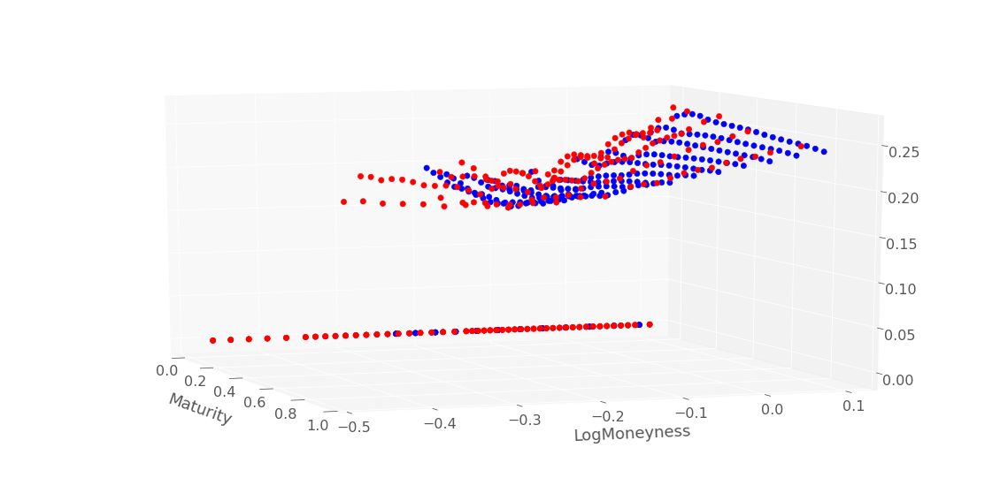

In [24]:
filter = dataSet["Maturity"] <= 2.0
filterTest = dataSetTest["Maturity"] <= 2.0
logMin = np.log(KMin/S0)
logMax = 0.1 #np.log(KMax/S0), 
plotTools.plot2Series(plotTools.convertToLogMoneyness(dataSetTest[filterTest]["ImpliedVol"], S0), 
                      plotTools.convertToLogMoneyness(dataSet[filter]["ImpliedVol"], S0), 
                      yMin=logMin,
                      yMax=logMax,
                      az = 340,
                      Title = 'Implied Vol Surface')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


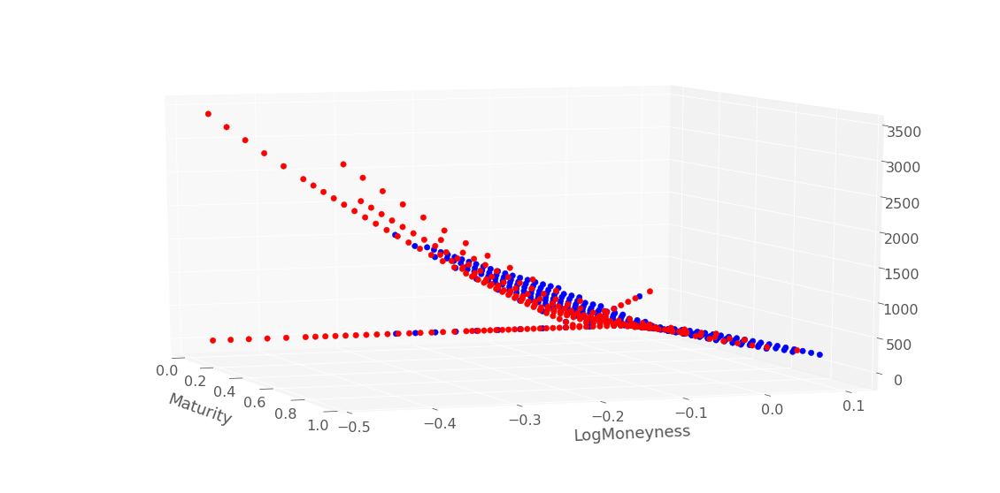

In [25]:
filter = dataSet["Maturity"] <= 2.0
filterTest = dataSetTest["Maturity"] <= 2.0
logMin = np.log(KMin/S0), 
logMax = 0.1 #np.log(KMax/S0), 
plotTools.plot2Series(plotTools.convertToLogMoneyness(dataSetTest[filterTest]["Price"], S0), 
                      plotTools.convertToLogMoneyness(dataSet[filter]["Price"], S0), 
                      yMin=logMin,
                      yMax=logMax,
                      az = 340,
                      Title = 'Price Surface')

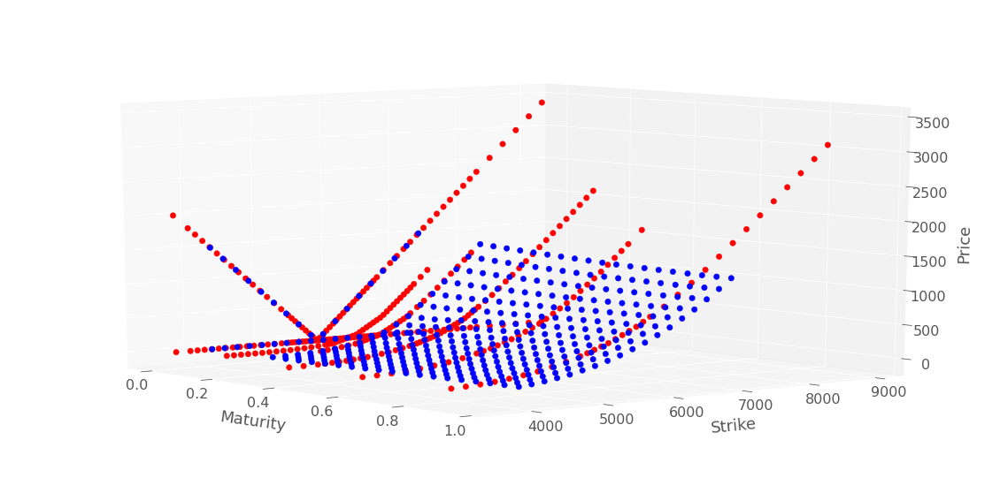

In [26]:
plotTools.plot2Series(dataSetTest["Price"], 
                      dataSet["Price"], 
                      yMin=KMin,
                      yMax=KMax, 
                      Title = 'True Price Surface')

In [27]:
importlib.reload(plotTools)

<module 'plotTools' from '/content/plotTools.py'>

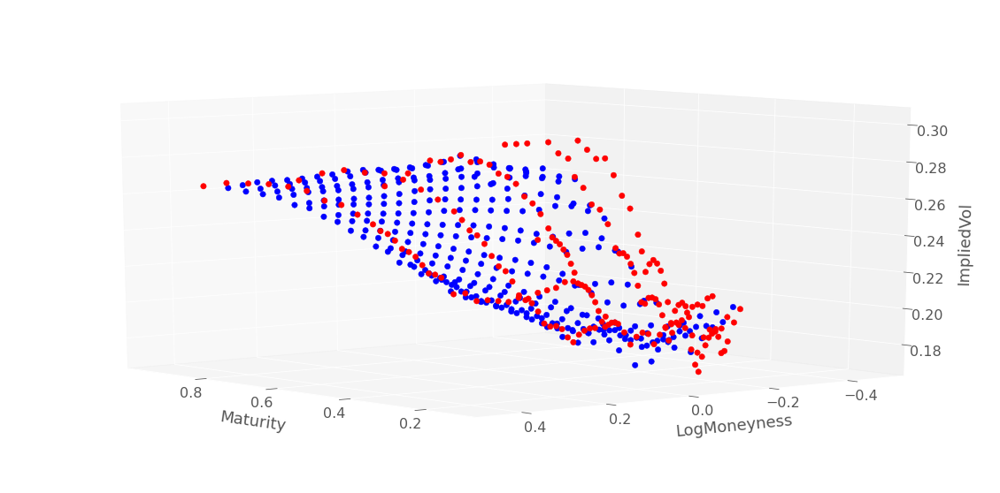

In [28]:
plotTools.plot2Series(plotTools.convertToLogMoneyness(dataSetTest[dataSetTest.Maturity > 0], S0)["ImpliedVol"], 
                      plotTools.convertToLogMoneyness(dataSet[dataSet.Maturity > 0], S0)["ImpliedVol"], 
                      yMin=-1000,
                      yMax=1000, 
                      Title = 'Implied vol Surfaces', 
                      az=140)

In [29]:
%matplotlib inline

# Learning Price
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [30]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 10#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 1000#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 10000000#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.01
hyperparameters["lowerBoundGamma"] = 0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10
hyperparameters["DupireVolLowerBound"] = 0.05
hyperparameters["DupireVolUpperBound"] = 0.40

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.1
hyperparameters["Patience"] = 100
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs
hyperparameters["ArtificialPenalizationGrid"] = False #Compute no-arbitrage penalization on an additional 5000 points grid

In [31]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 10
hyperparameters["lambdaSoft"] = 1000 
hyperparameters["lambdaGamma"] = 100000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.01
hyperparameters["lowerBoundGamma"] = 0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10
hyperparameters["DupireVolLowerBound"] = 0.05
hyperparameters["DupireVolUpperBound"] = 0.40

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.1
hyperparameters["Patience"] = 100
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 200 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000 #maximum number of epochs

In [ ]:
importlib.reload(plotTools)

<module 'plotTools' from '/content/plotTools.py'>

#### No penalization bounds on local variance.

In [ ]:
#Execute this cell if you want to fit neural network with prices
res = neuralNetwork.create_train_model(neuralNetwork.NNArchitectureHardConstrainedDupire,
                                       scaledDataSet,
                                       False,
                                       hyperparameters,
                                       scaler,
                                       modelName = "HardDupireVolModel")
y_pred, volLocale, dNN_T, gNN_K, lossSerie = res

Iteration :  1514 new learning rate :  0.010000000000000002
Best loss (hidden nodes: 200, iterations: 1515): 5.43
Best Penalization :  [229.24672, []]
Best Penalization (Refined Grid) :  [[]]
Best loss (hidden nodes: 200, iterations: 10000): 5.43
Best Penalization :  [227.80296, []]
Best Penalization (Refined Grid) :  [[]]
Training Time :  319.96860933303833


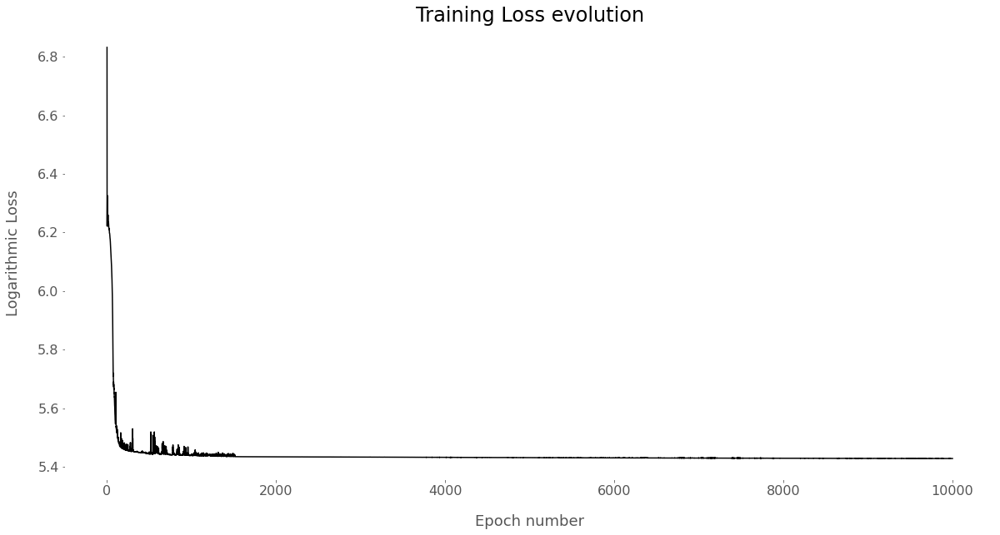

5.428544044494629

In [ ]:
plotTools.plotEpochLoss(lossSerie)
lossSerie.iloc[-1]

Best loss (hidden nodes: 200, iterations: 0): 5.43
Best Penalization :  [227.80296, []]
Best Penalization (Refined Grid) :  [[]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


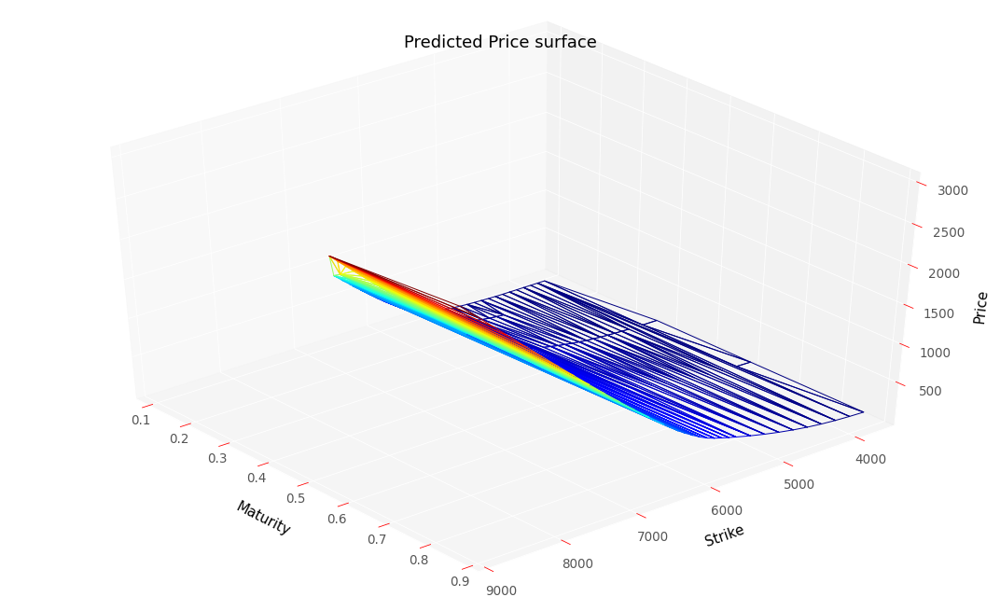

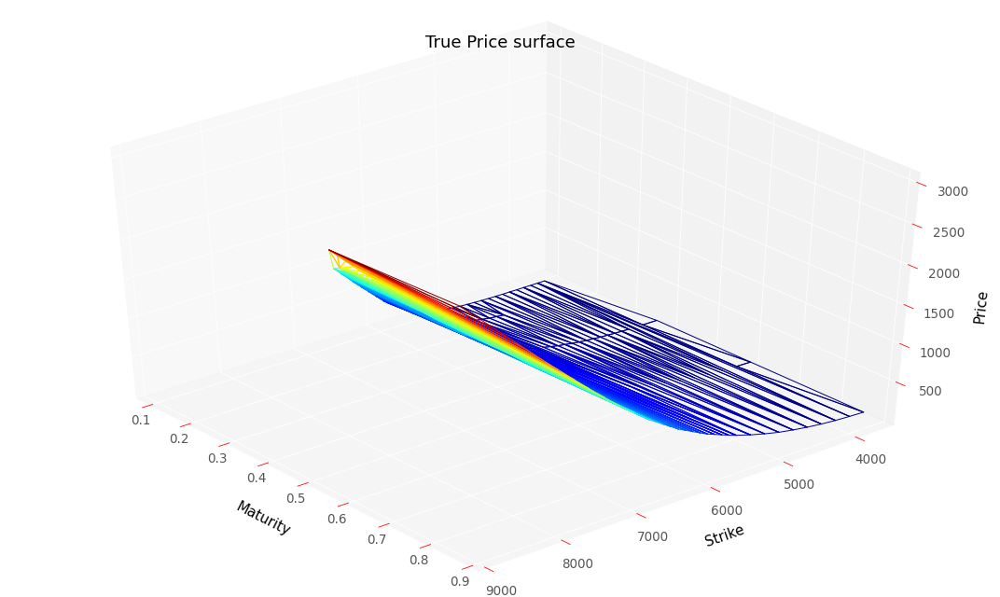

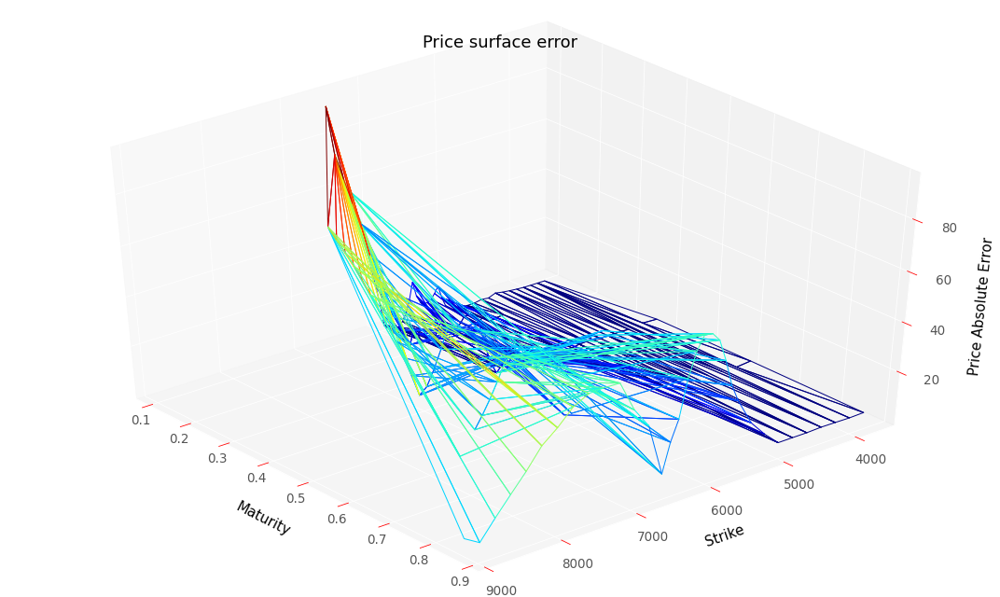

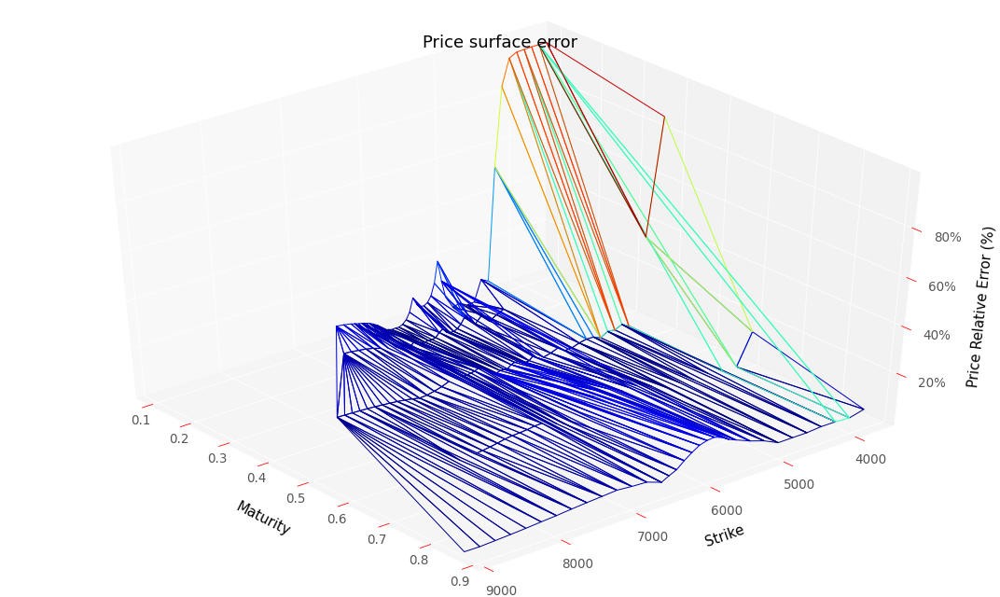

RMSE :  26.912266404207728
RMSE Relative:  0.20842712913130063


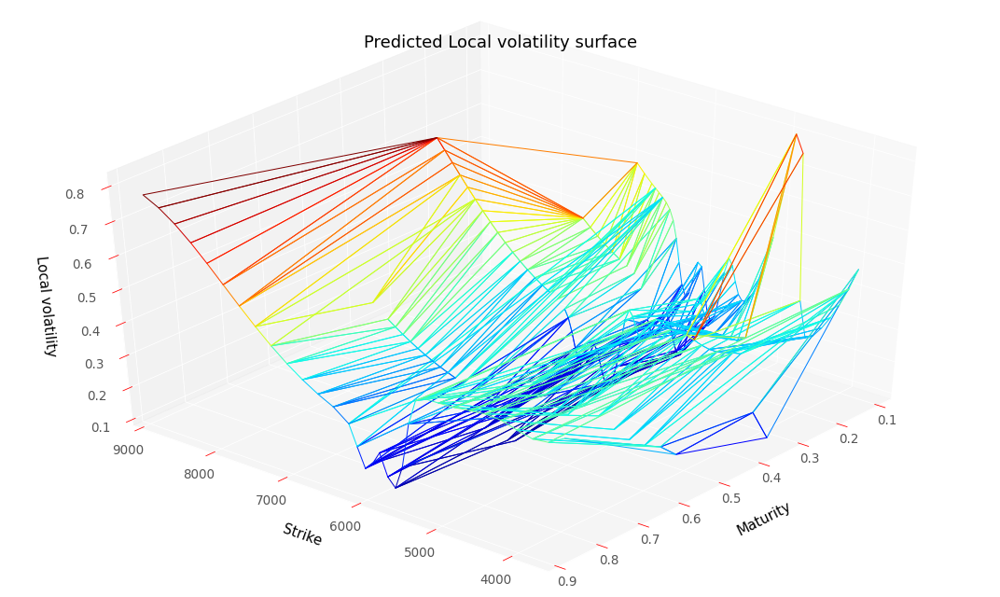

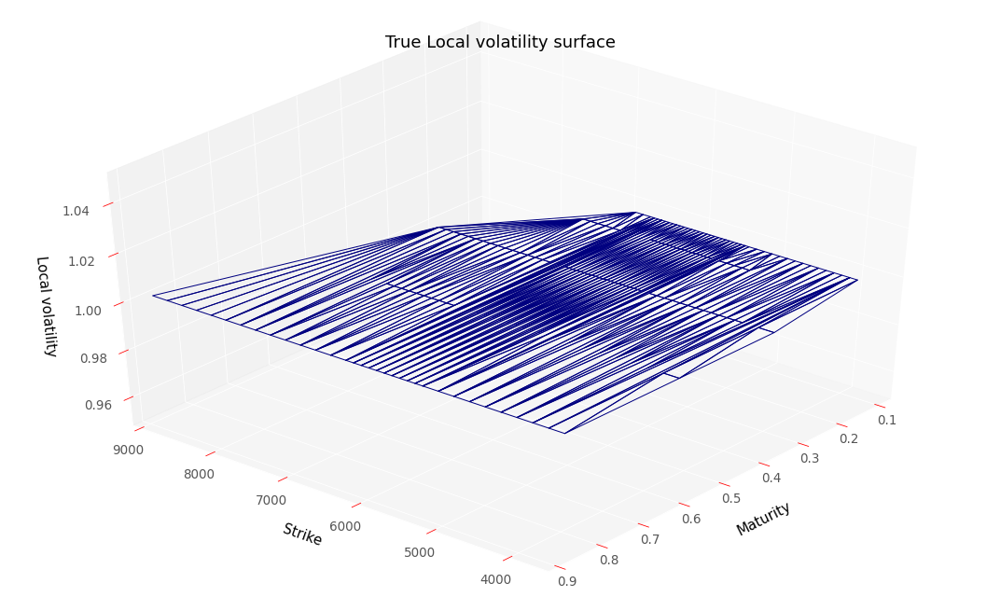

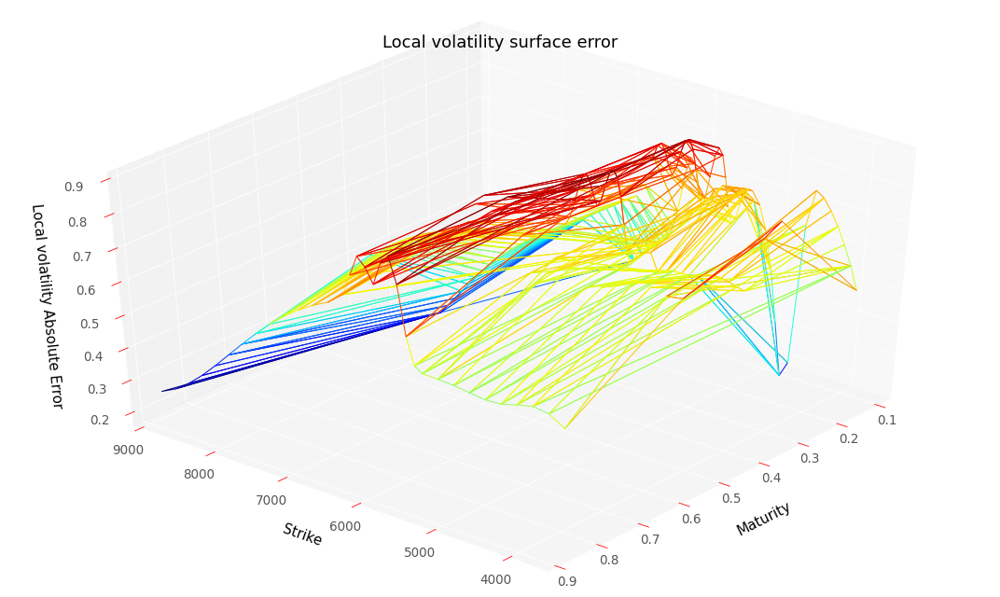

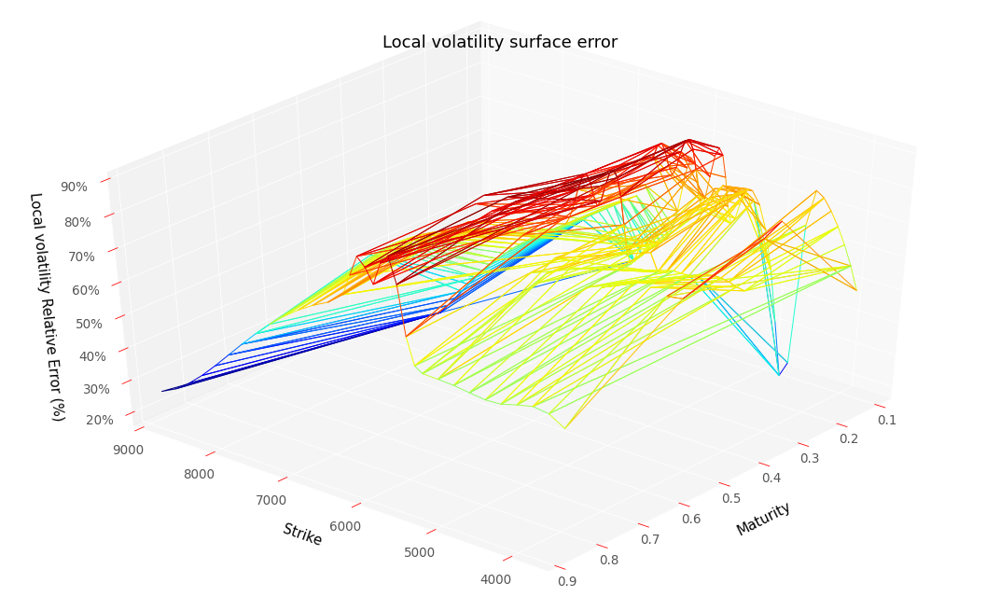

RMSE :  0.6729709562596001
RMSE Relative:  0.6729709562596001


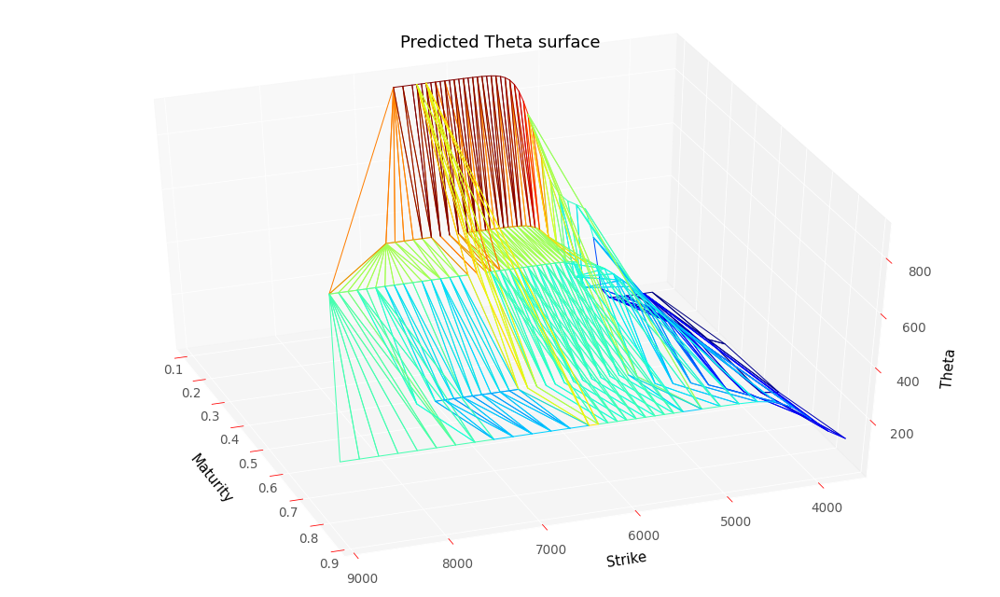

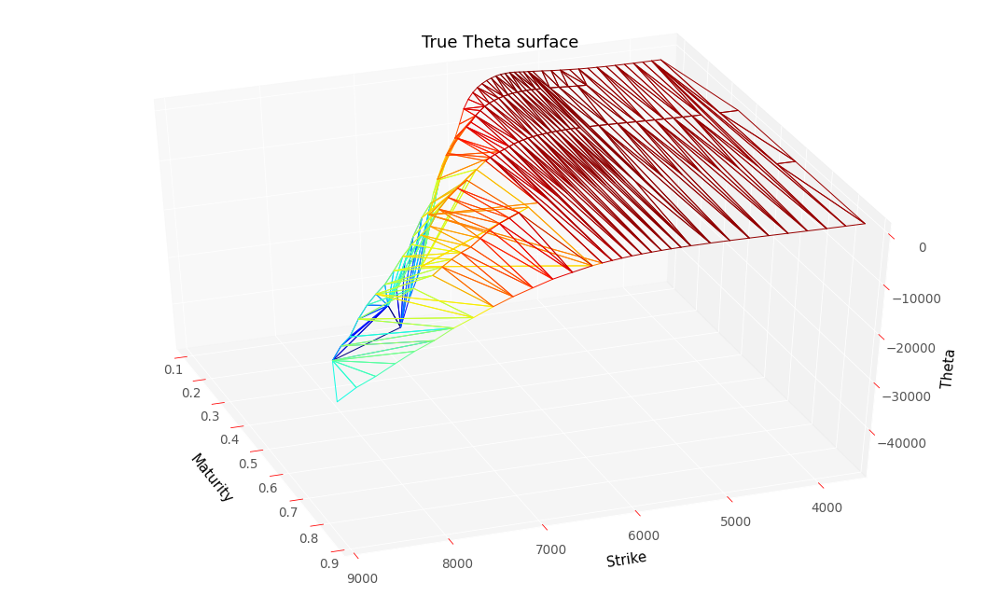

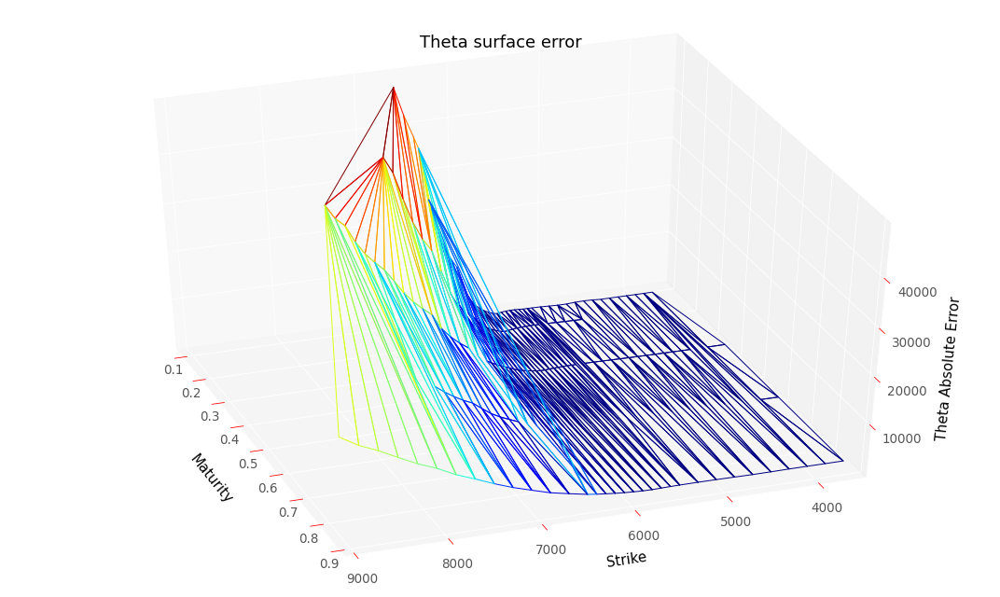

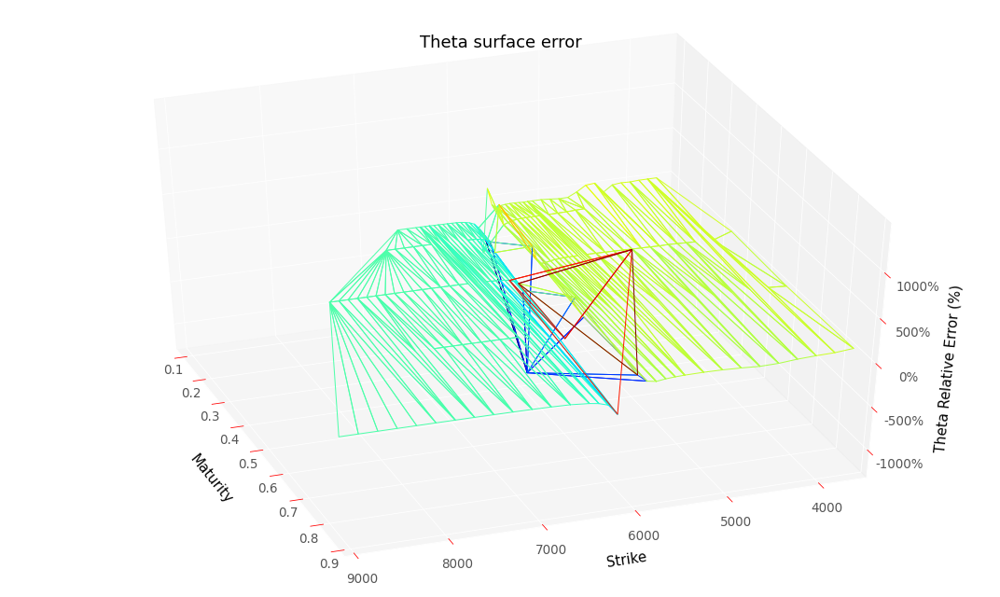

RMSE :  12467.461430929481
RMSE Relative:  1.7609412699926947


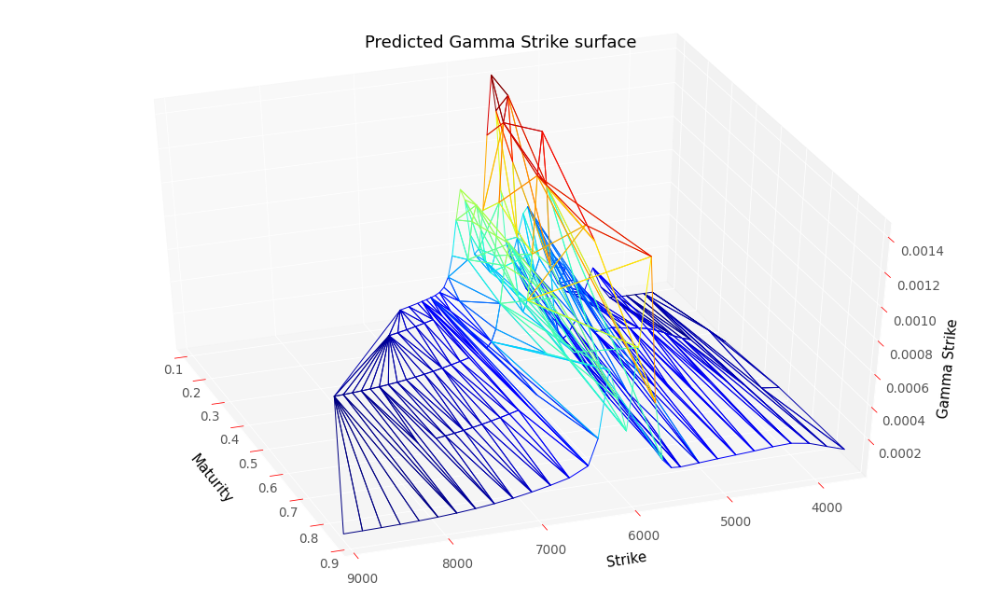

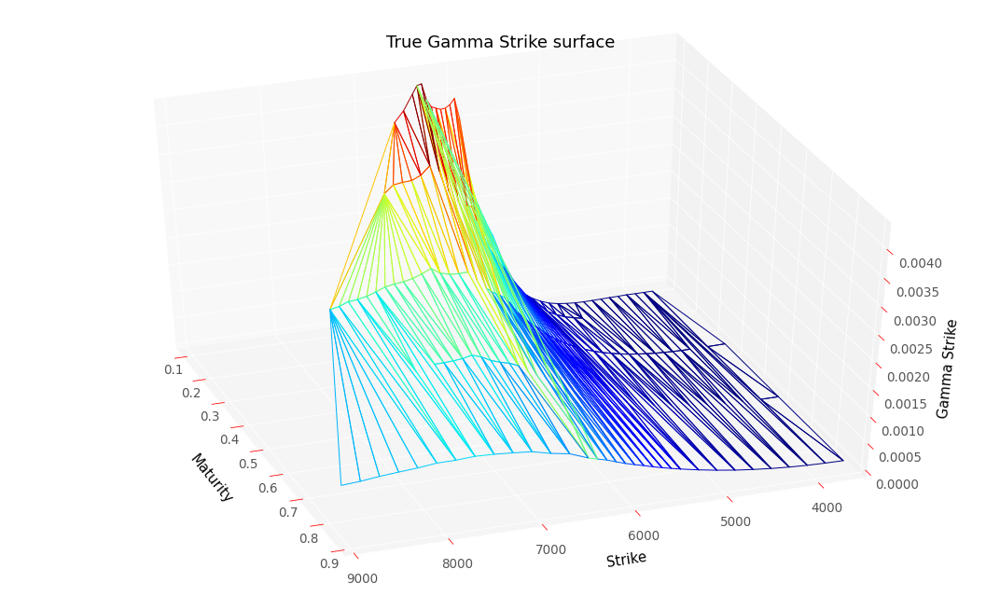

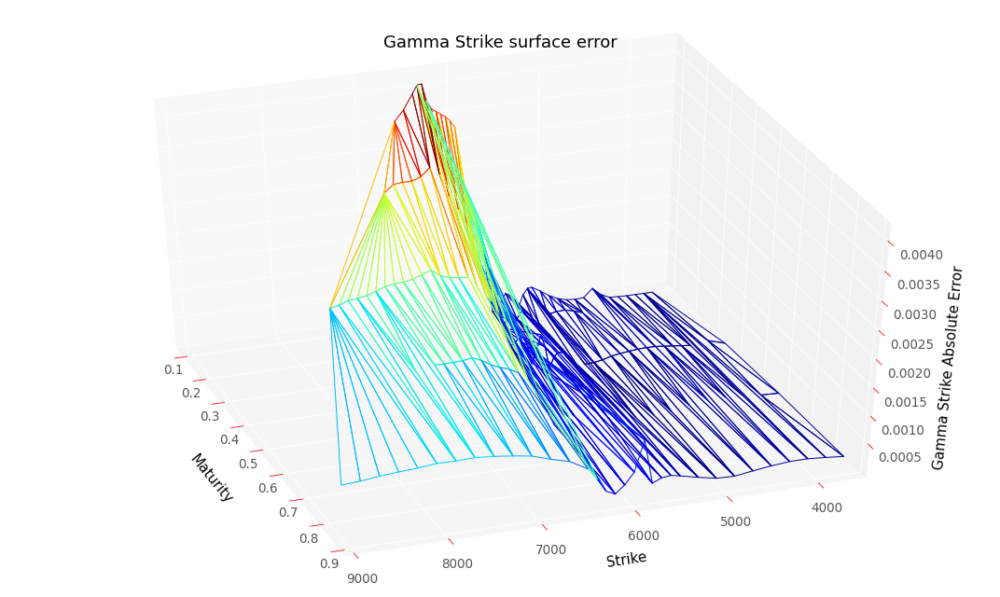

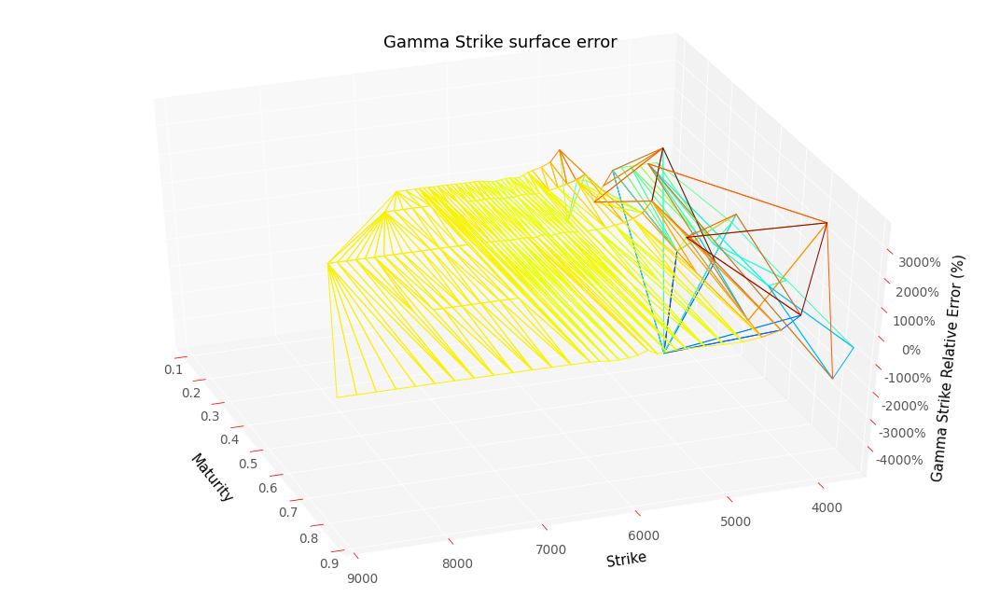

RMSE :  0.0014412118616251213
RMSE Relative:  6.0301661979209955


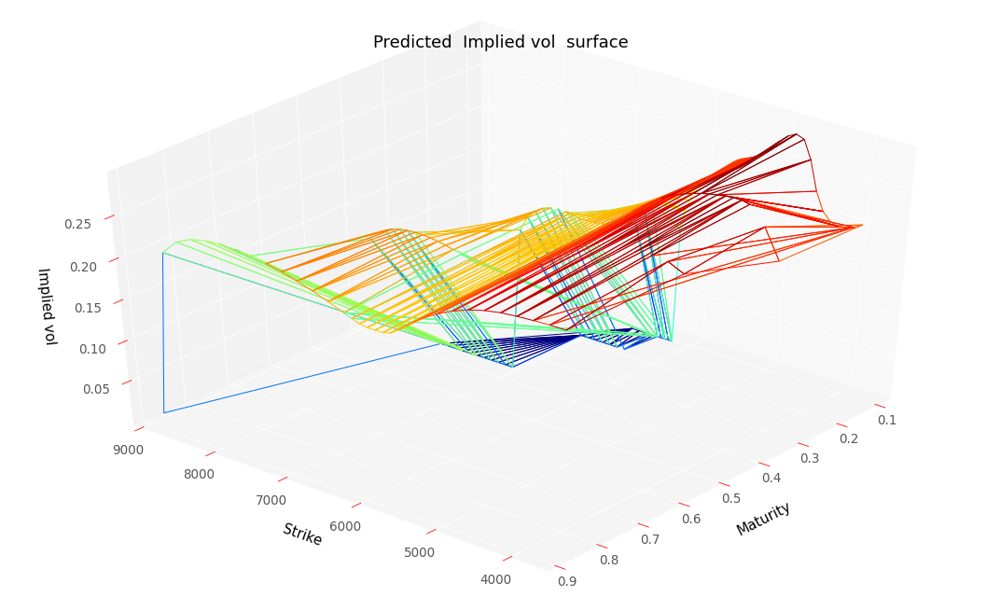

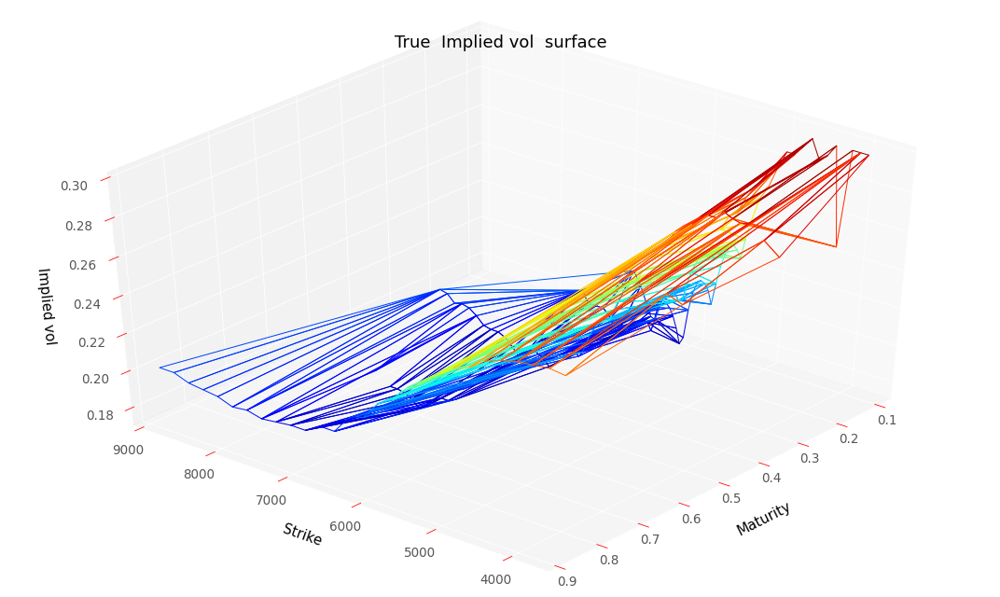

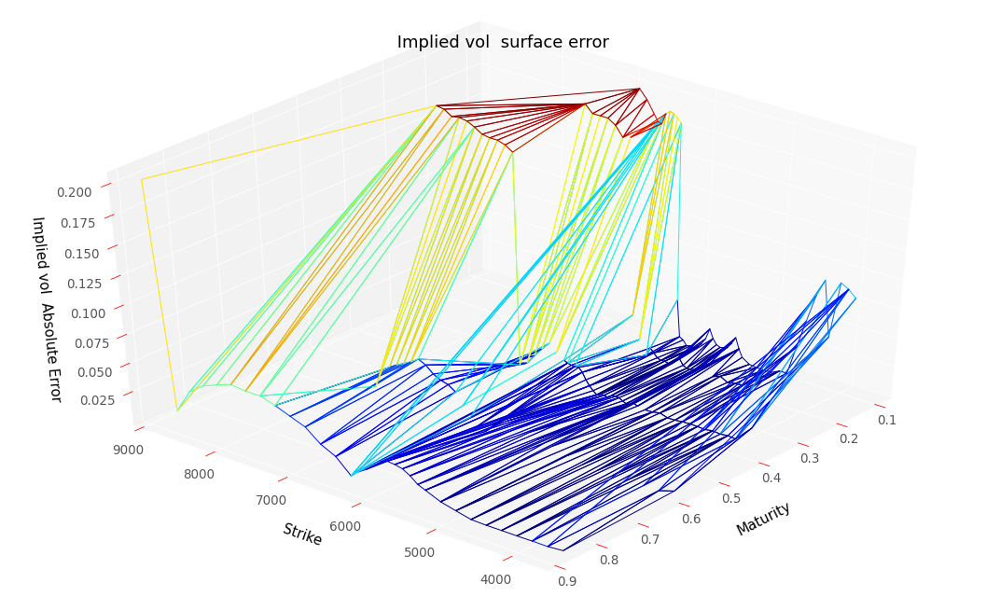

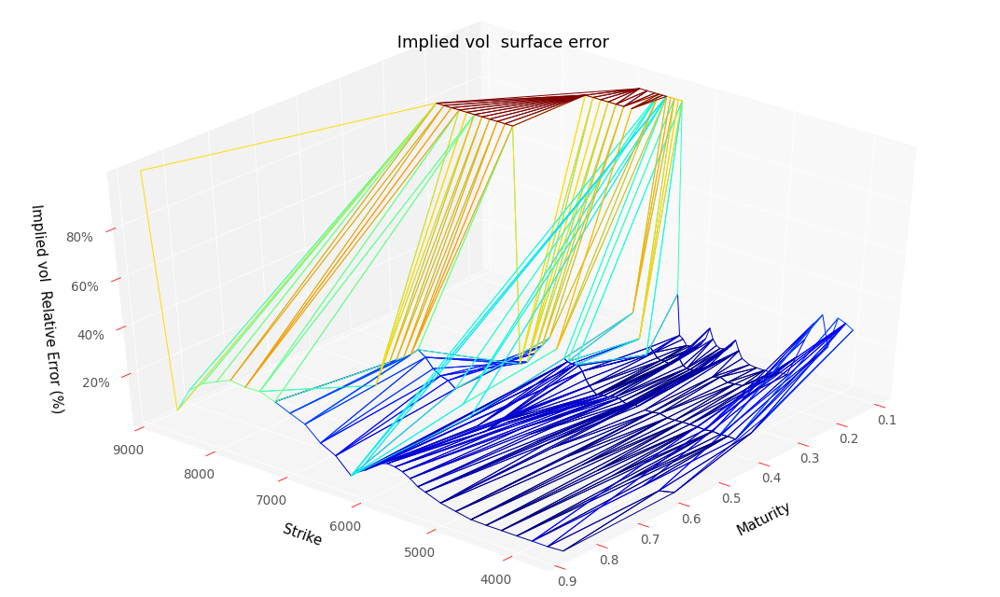

RMSE :  0.07792907660627396
RMSE Relative:  0.4005289823137544


In [32]:
# Evaluate results on the training set, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureHardConstrainedDupire,
                                      scaledDataSet,
                                      False,
                                      hyperparameters,
                                      scaler,
                                      modelName = "HardDupireVolModel")
y_pred, volLocale, dNN_T, gNN_K, lossSerie = res

plotTools.modelSummary(y_pred,
                       volLocale, 
                       dNN_T, 
                       gNN_K, 
                       dataSet,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralHardPriceTrain")

In [33]:
volLocale.loc[(midS0,slice(None))]

Strike  Maturity
5650    0.000       0.109545
        0.000       0.109545
        0.121       0.198786
        0.197       0.135045
        0.370       0.153742
Name: Dupire, dtype: float32

Best loss (hidden nodes: 200, iterations: 0): 3.99
Best Penalization :  [53.850735, []]
Best Penalization (Refined Grid) :  [[]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


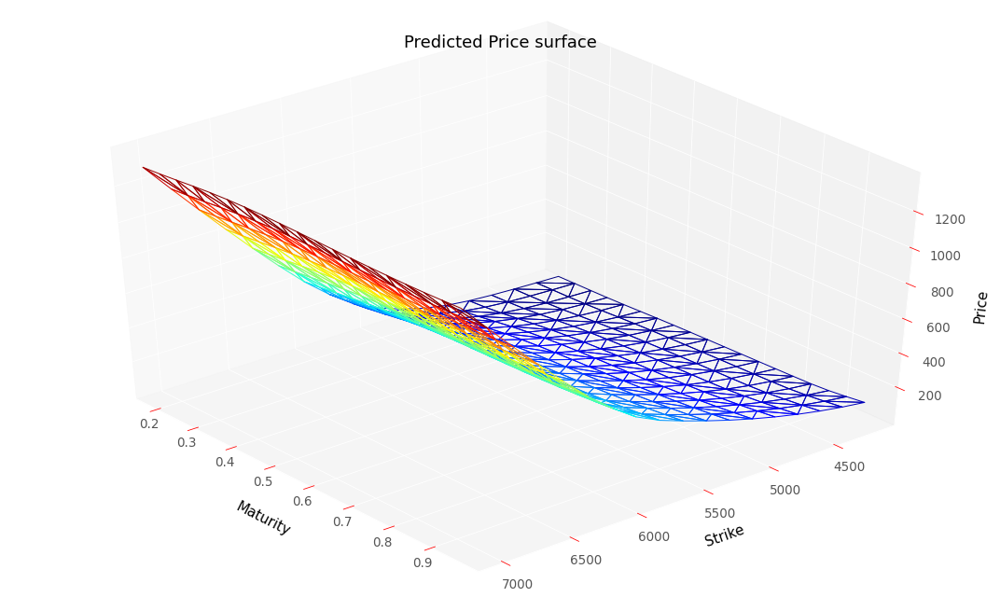

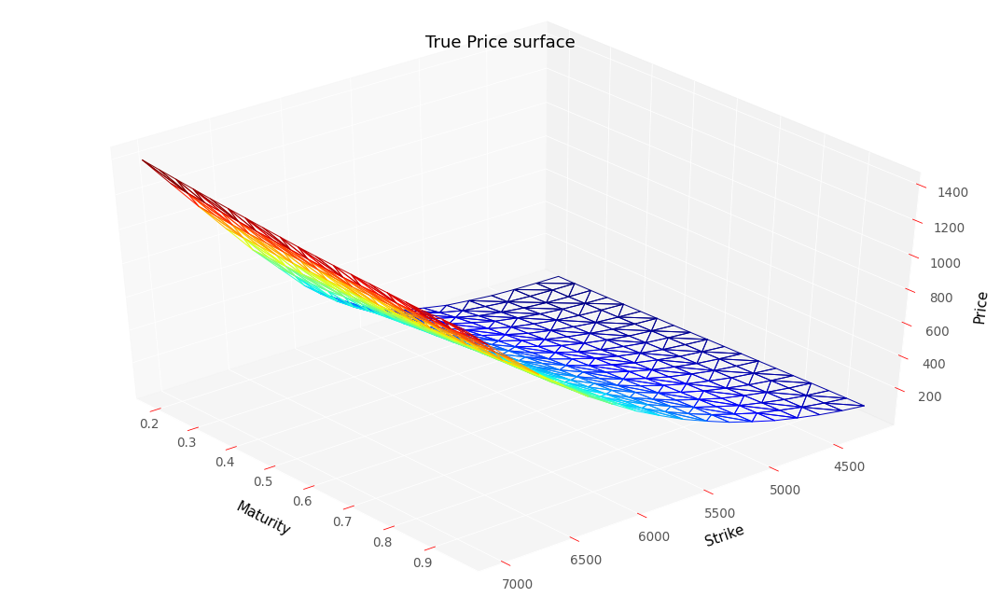

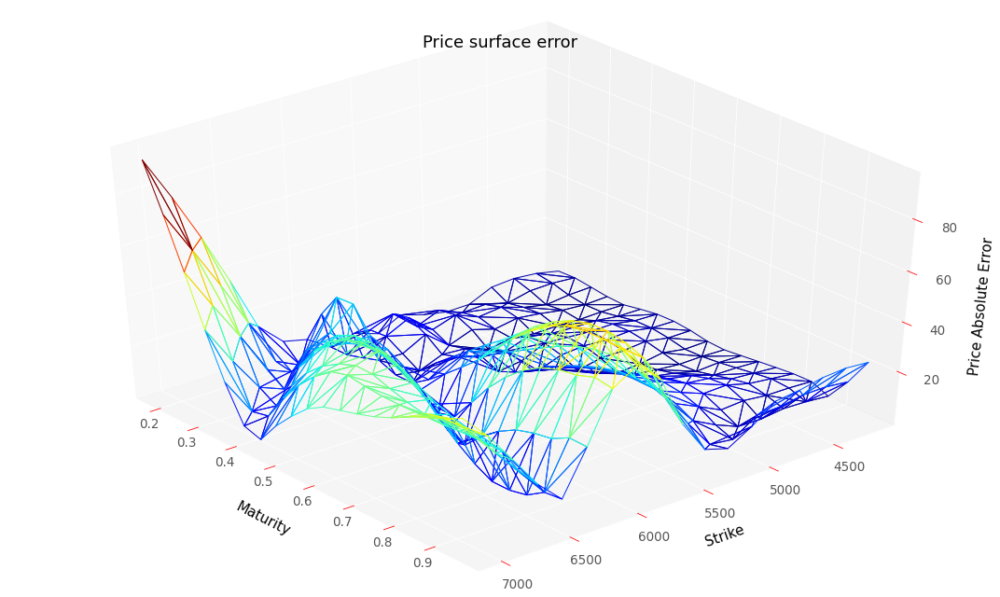

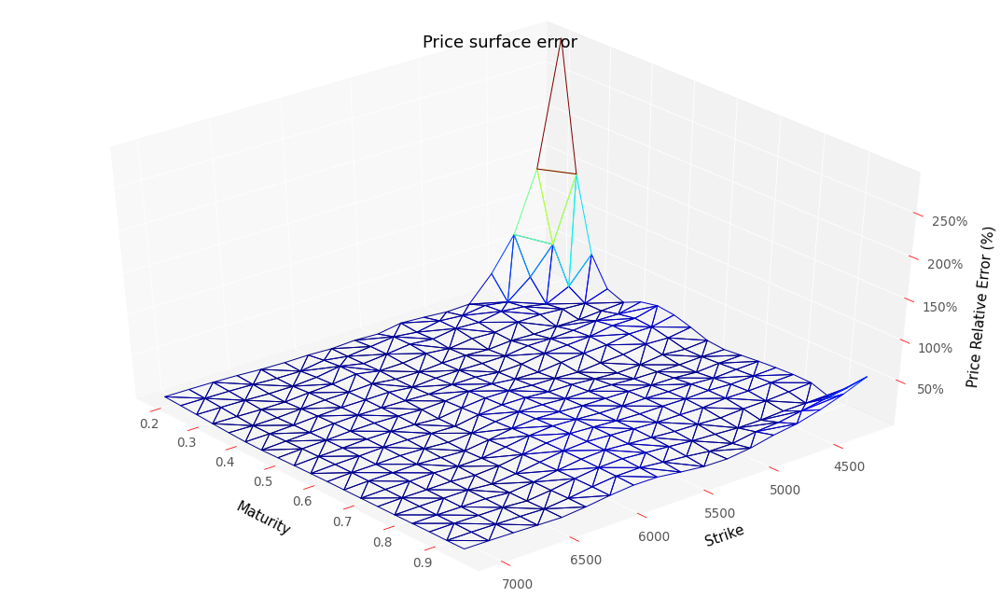

RMSE :  24.38204957480727
RMSE Relative:  0.2109798153101732


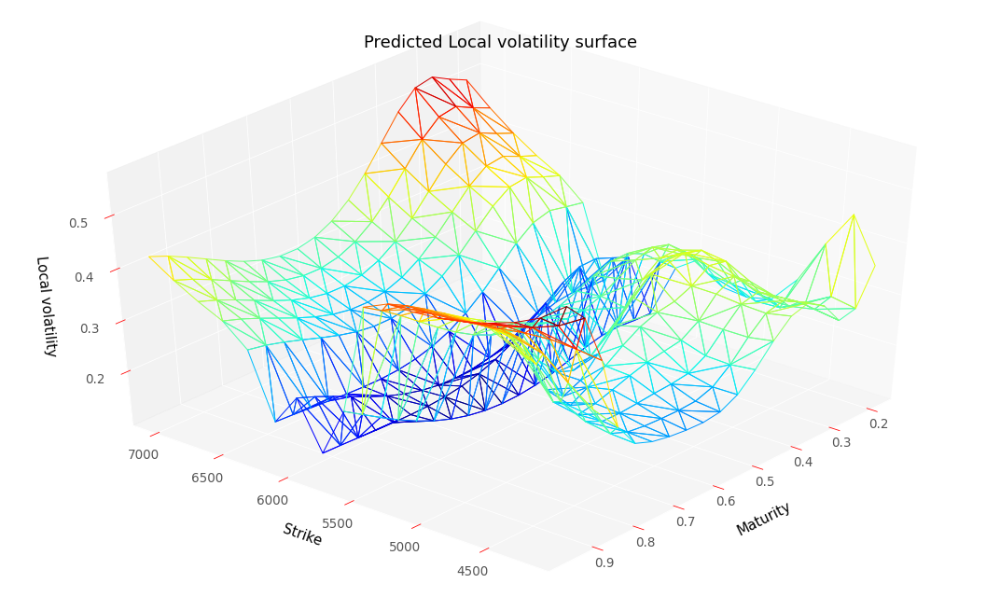

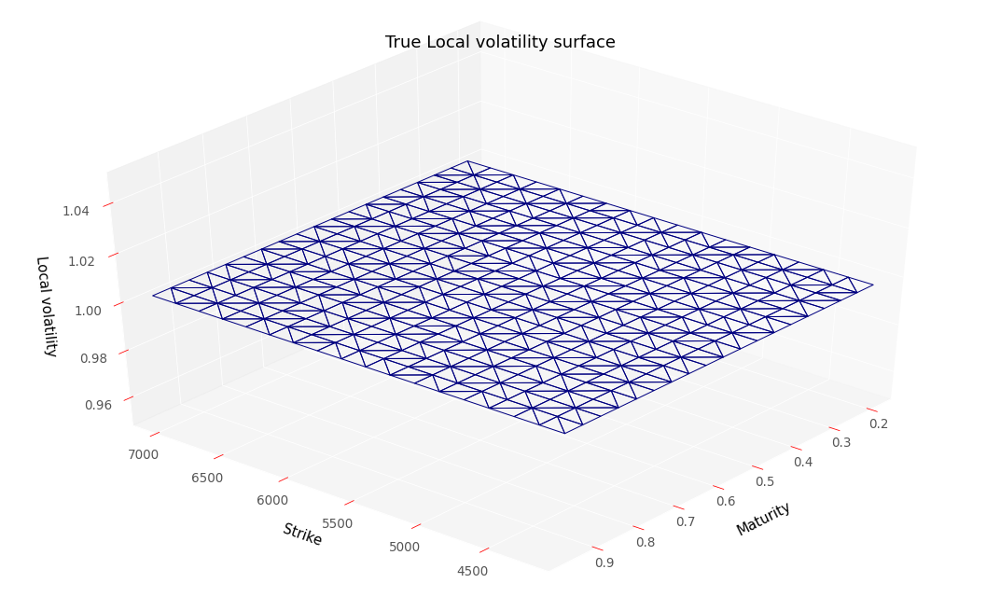

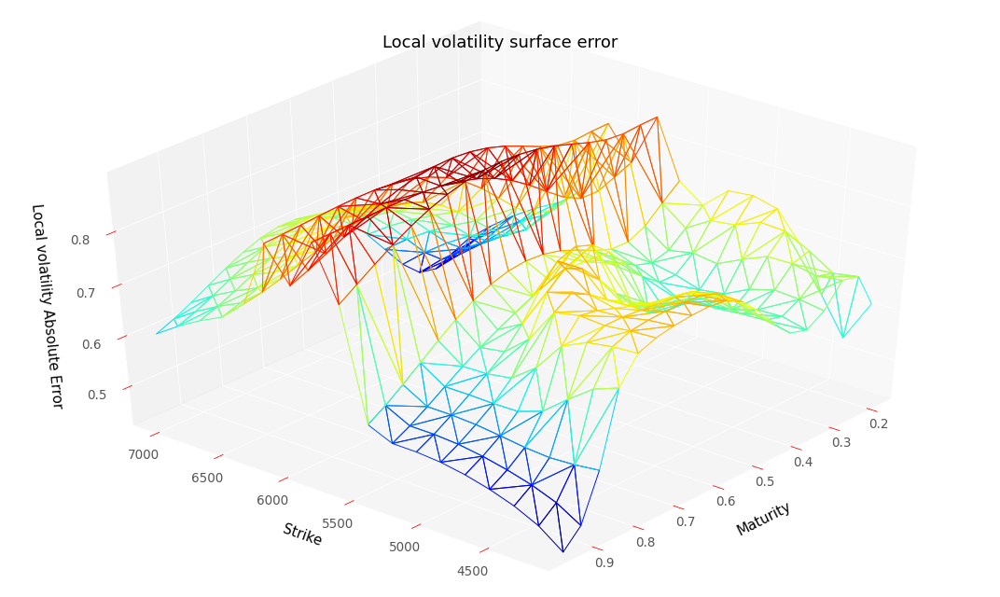

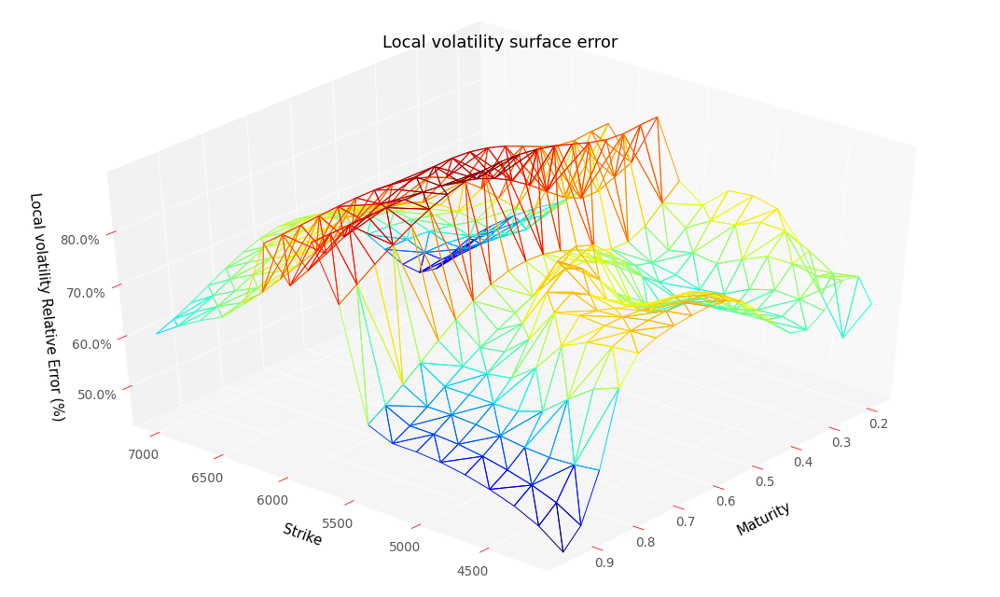

RMSE :  0.7099582174750116
RMSE Relative:  0.7099582174750116


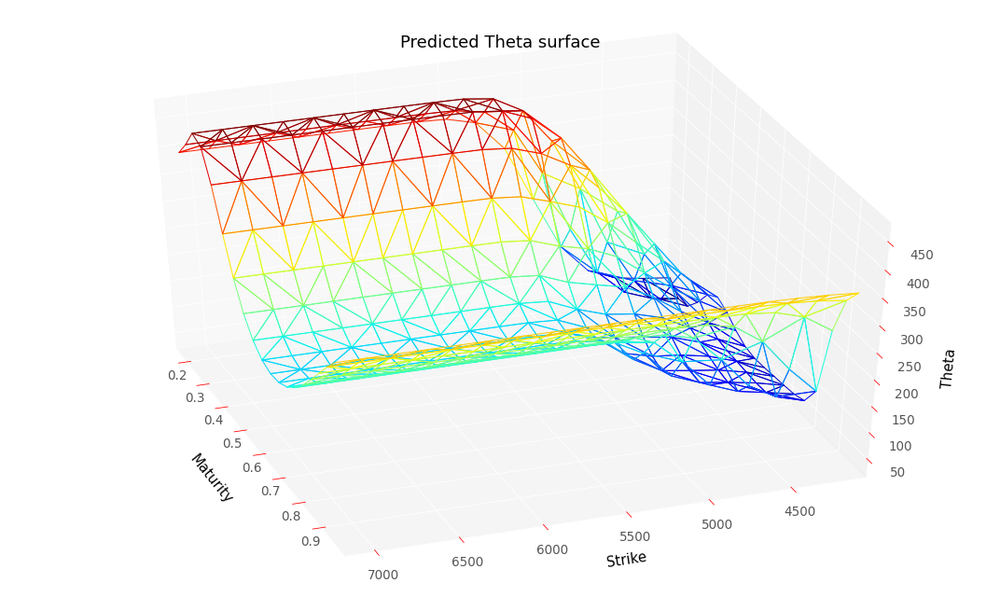

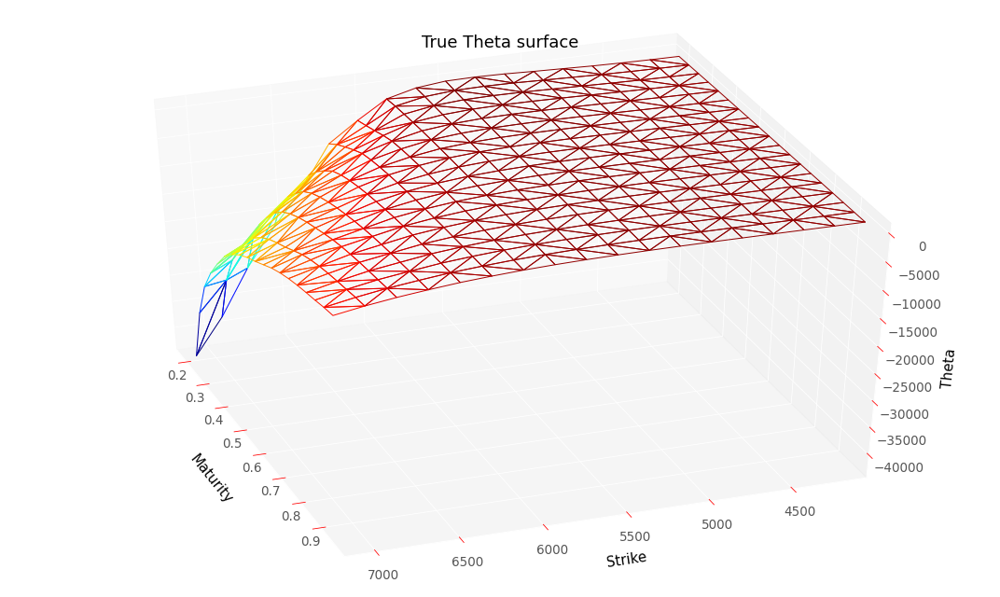

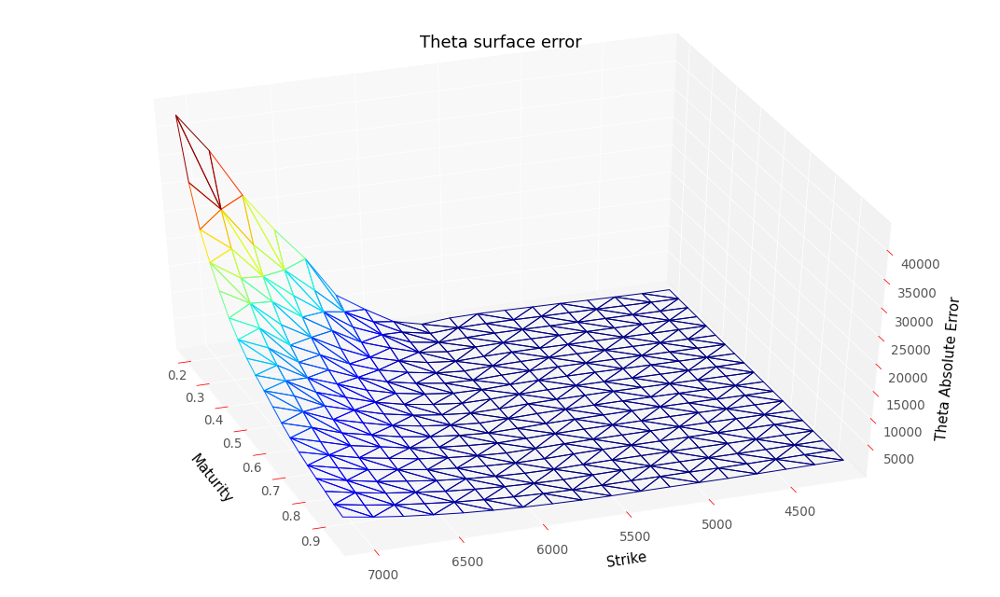

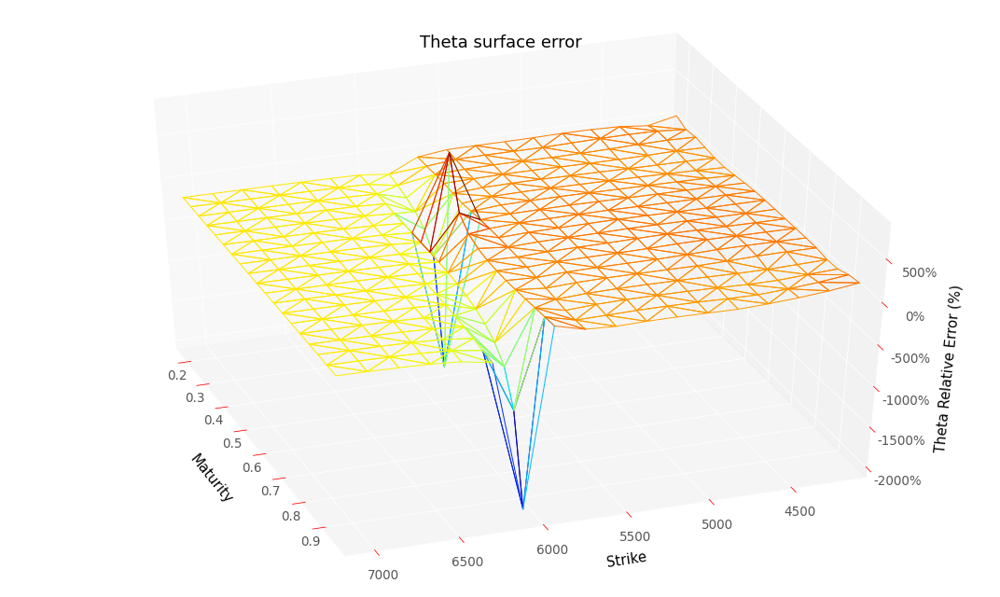

RMSE :  6468.852465133671
RMSE Relative:  1.934787771154719


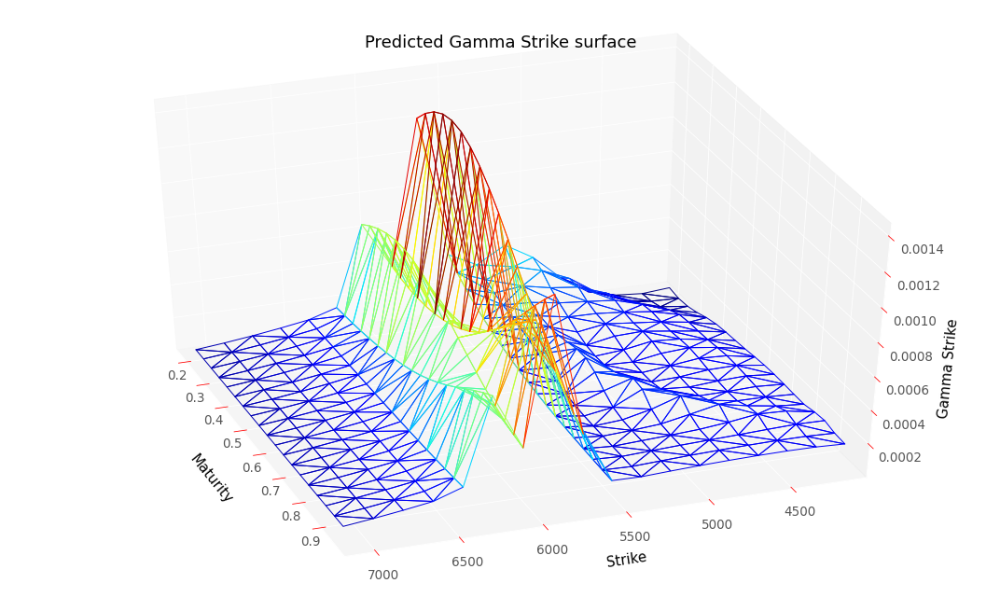

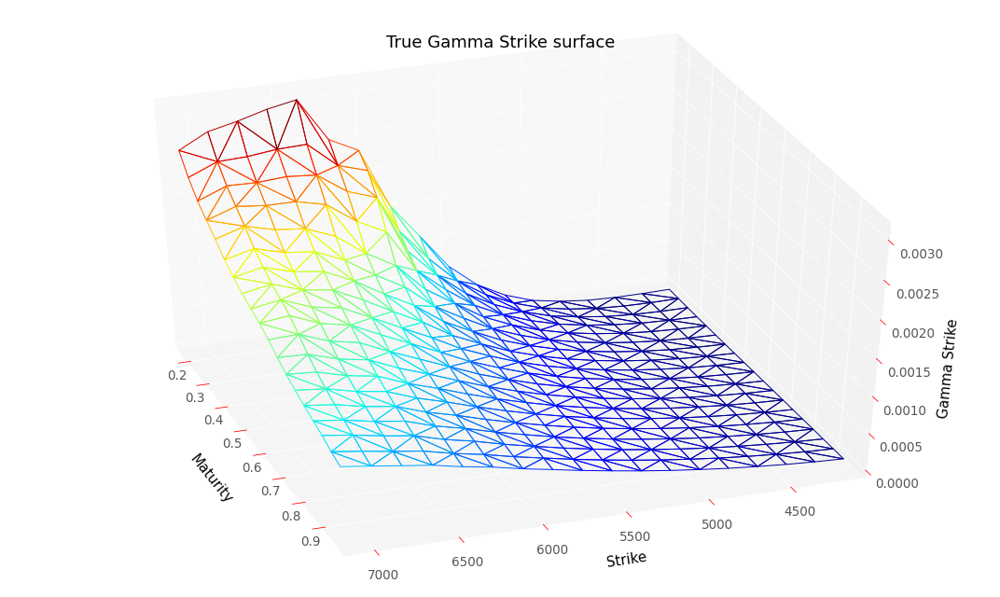

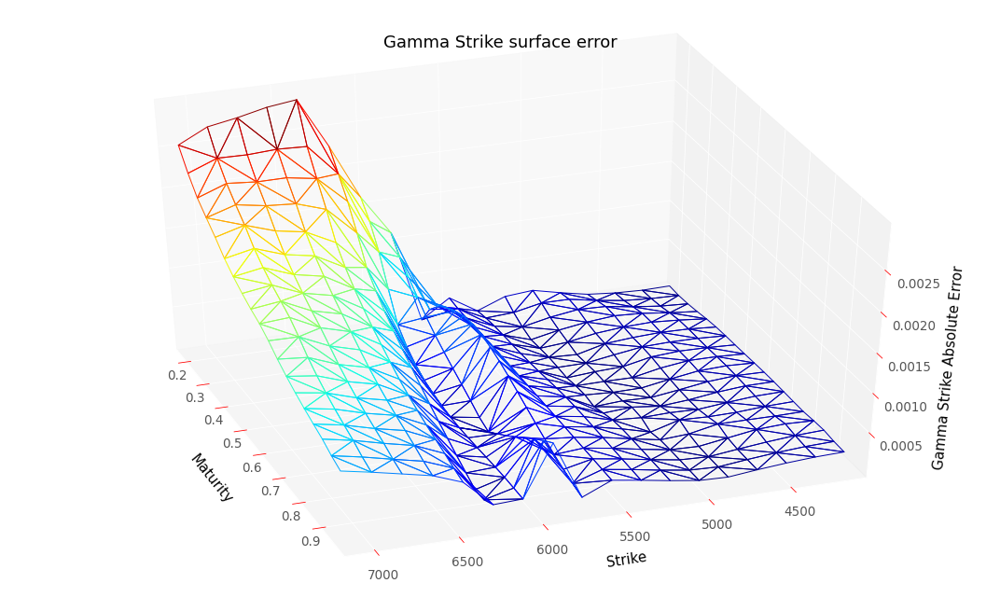

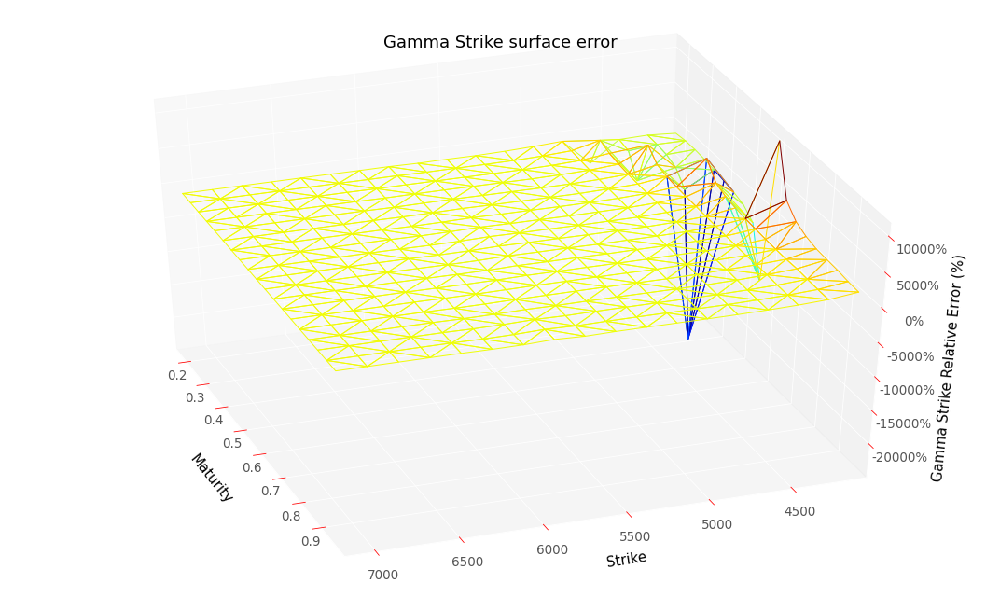

RMSE :  0.00092172980069732
RMSE Relative:  16.636305159690252


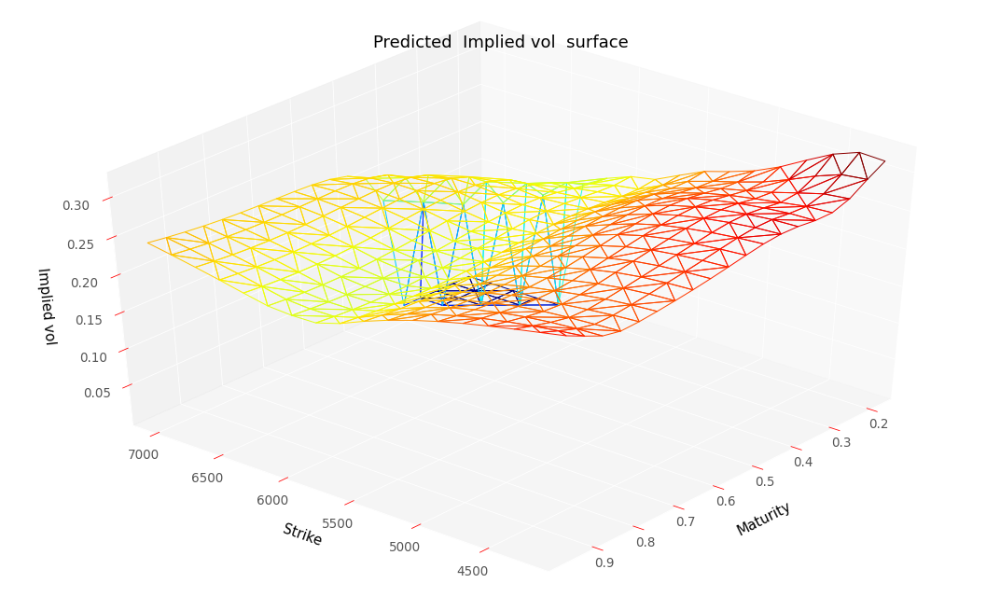

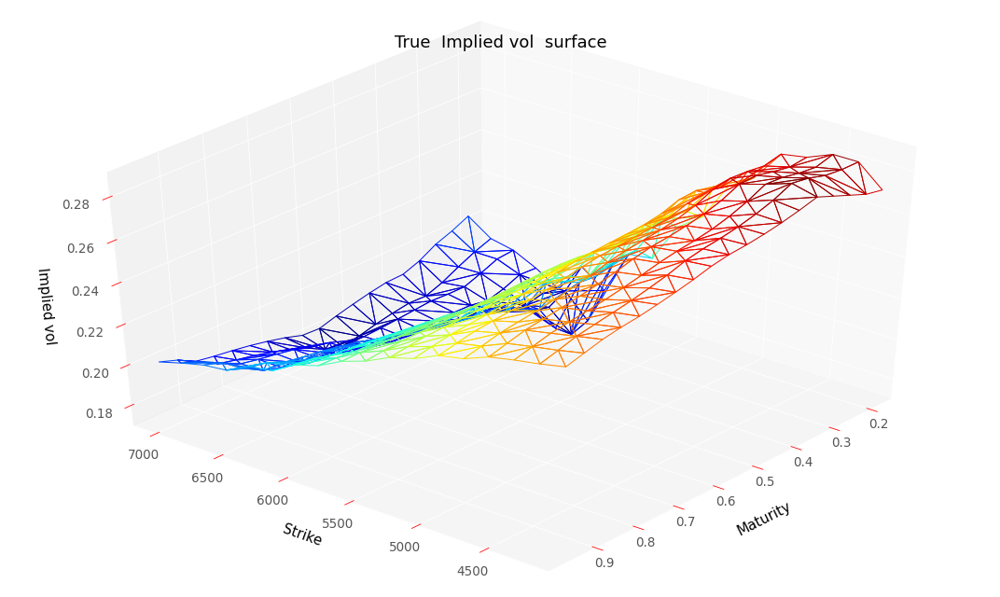

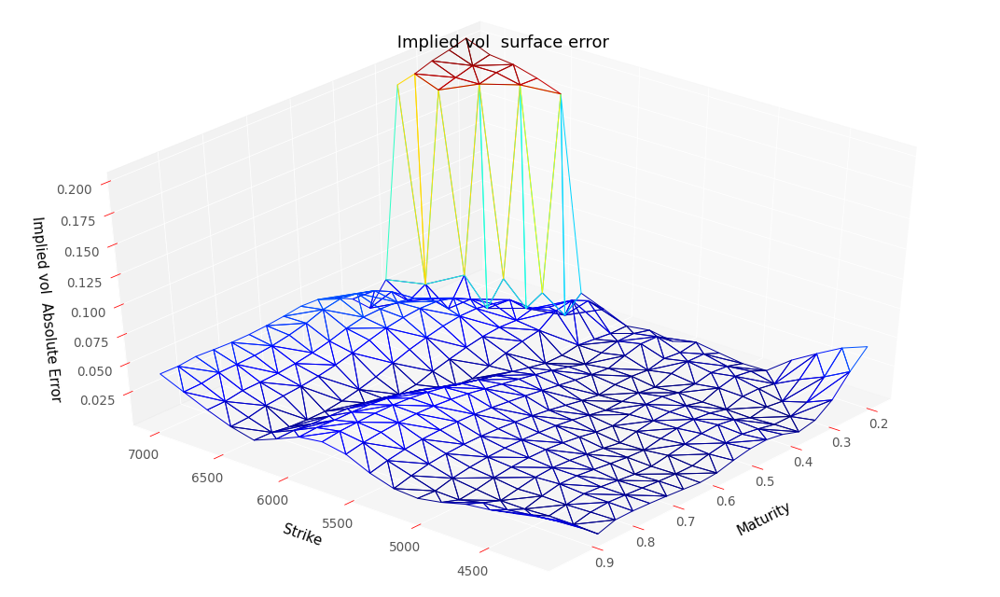

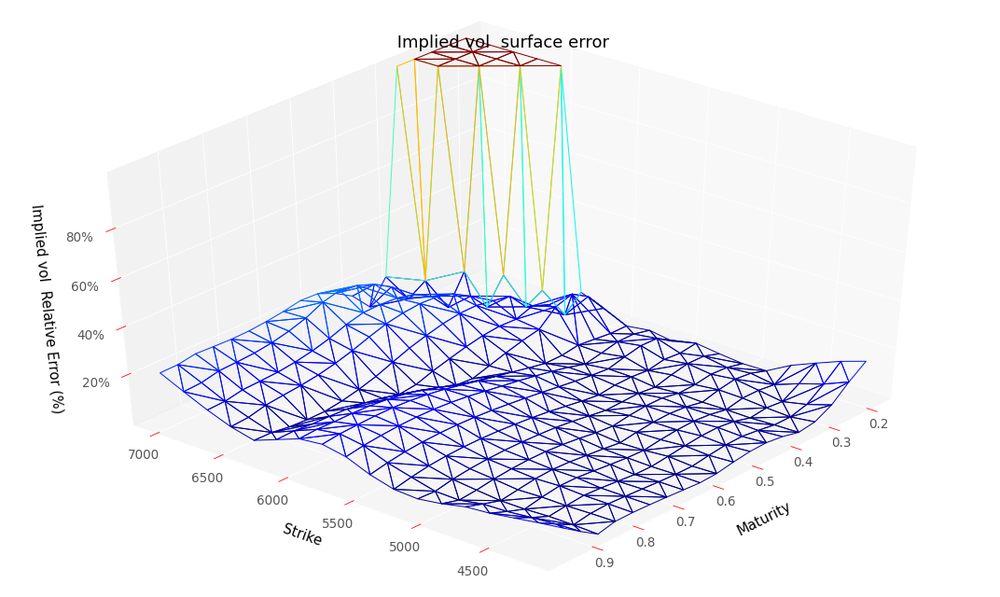

RMSE :  0.0435764062965506
RMSE Relative:  0.22647465611738685


In [34]:
# Evaluate results on the testing dataset, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureHardConstrainedDupire,
                                      scaledDataSetTest,
                                      False,
                                      hyperparameters,
                                      scaler,
                                      modelName = "HardDupireVolModel")
y_predTest, volLocaleTest, dNN_TTest, gNN_KTest, lossSerieTestG = res

plotTools.modelSummary(y_predTest,
                       volLocaleTest,
                       dNN_TTest,
                       gNN_KTest,
                       dataSetTest,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralHardPriceTest")

#### With penalization bounds on local variance.

In [ ]:
#Execute this cell if you want to fit neural network with prices
res = neuralNetwork.create_train_model(neuralNetwork.NNArchitectureHardConstrainedDupire,
                                       scaledDataSet,
                                       True,
                                       hyperparameters,
                                       scaler,
                                       modelName = "regularizedHardDupireVolModel")
y_pred2, volLocale2, dNN_T2, gNN_K2, lossSerie2 = res

Iteration :  605 new learning rate :  0.010000000000000002
Best loss (hidden nodes: 200, iterations: 606): 5.45
Best Penalization :  [231.69559, [1.763078]]
Best Penalization (Refined Grid) :  [[0.0]]
Best loss (hidden nodes: 200, iterations: 10000): 5.43
Best Penalization :  [227.95819, [1.1526929]]
Best Penalization (Refined Grid) :  [[0.0]]
Training Time :  6956.585270643234


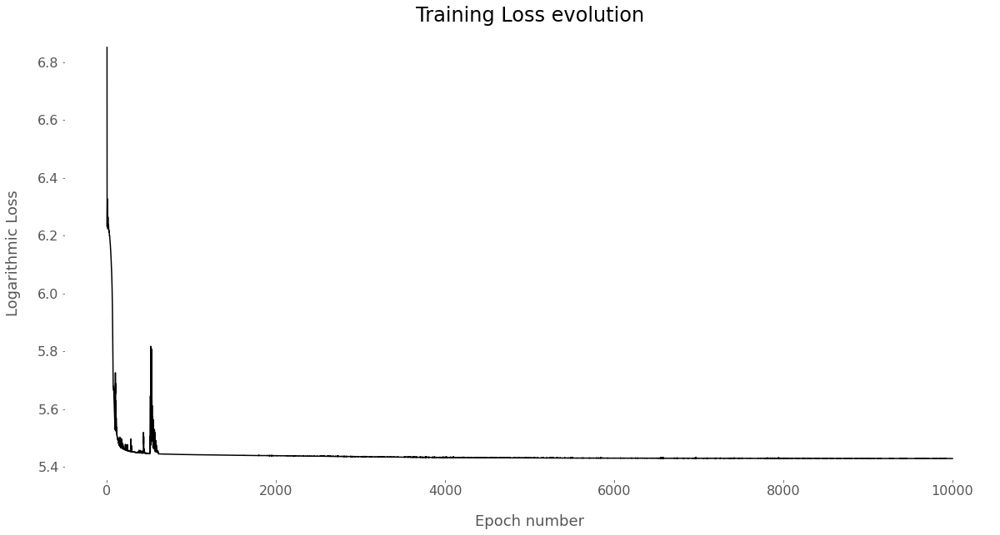

0

In [ ]:
plotTools.plotEpochLoss(lossSerie2)
lossSerie.iloc[-1]

In [ ]:
importlib.reload(plotTools)

<module 'plotTools' from '/content/plotTools.py'>

Best loss (hidden nodes: 200, iterations: 0): 5.43
Best Penalization :  [227.95819, [1.1526929]]
Best Penalization (Refined Grid) :  [[0.0]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


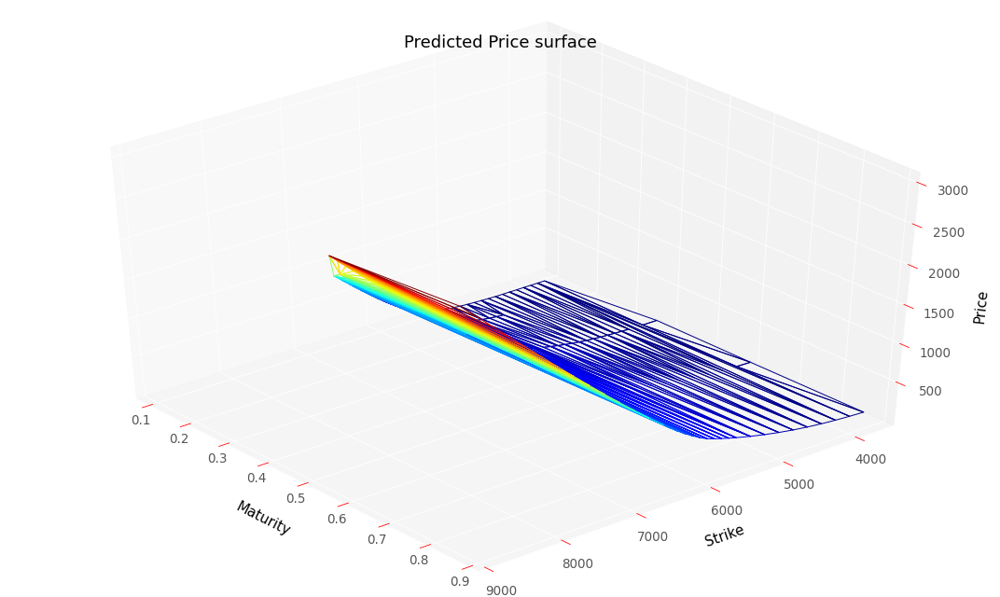

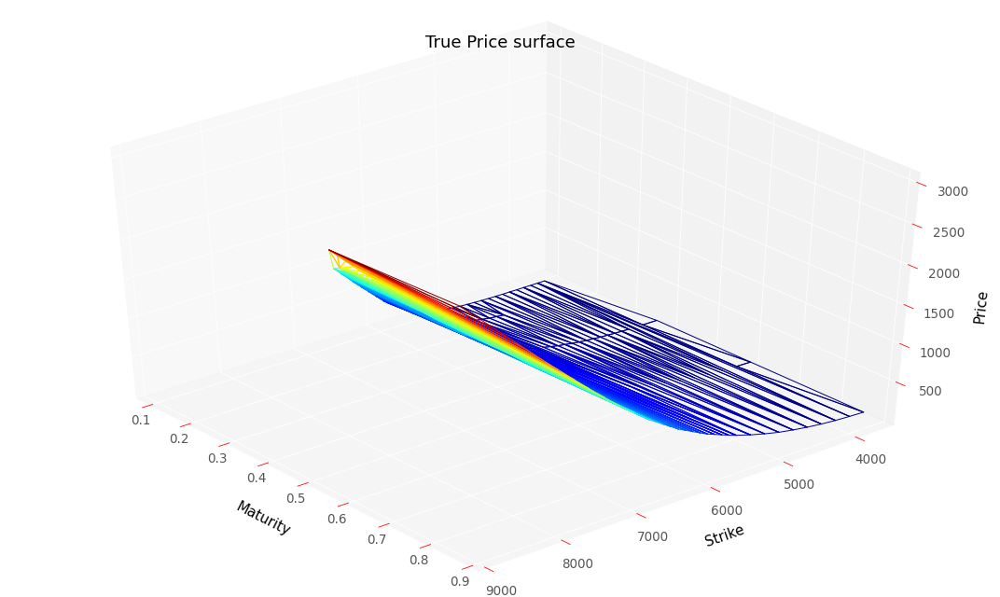

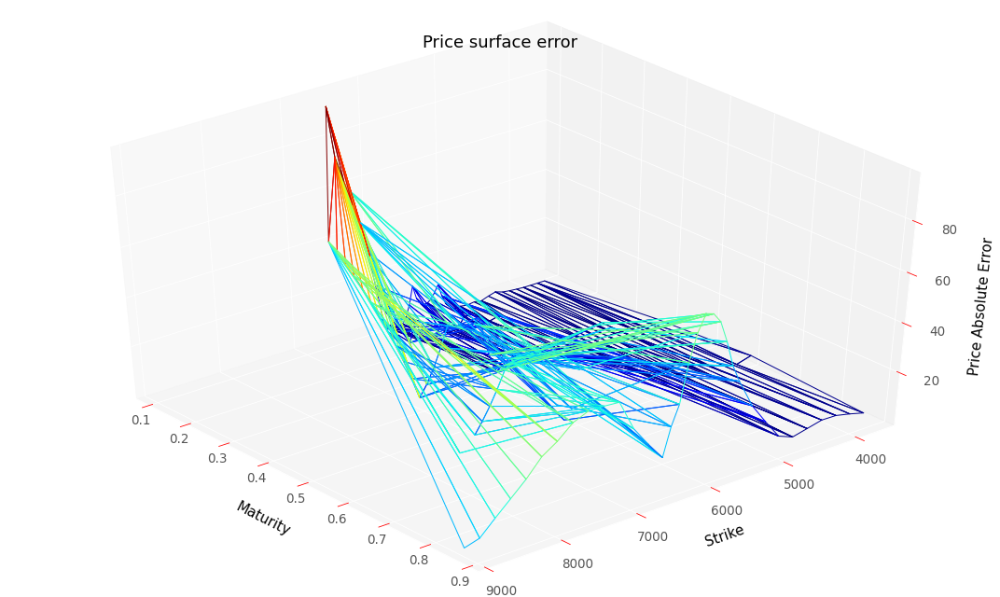

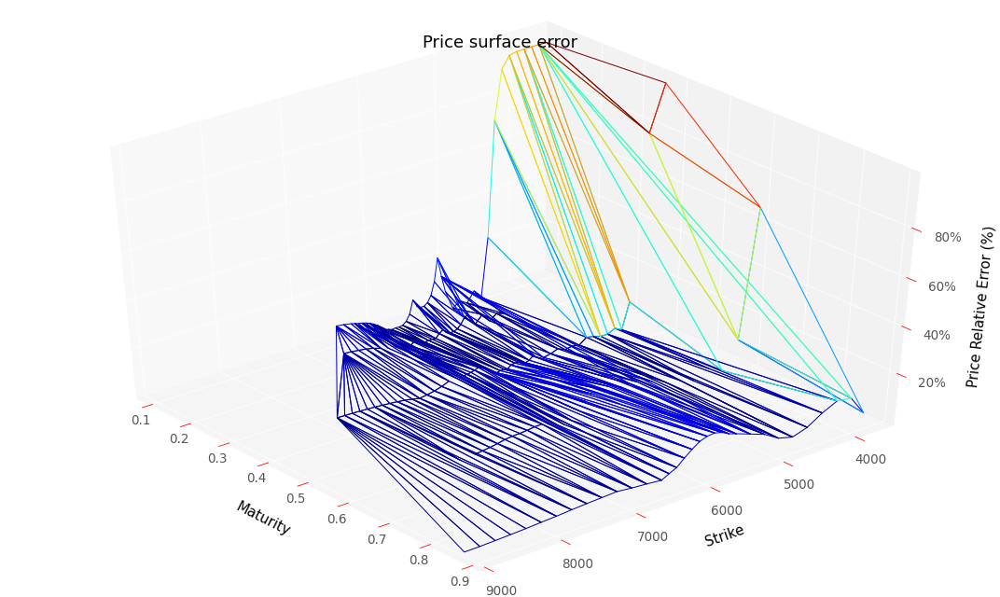

RMSE :  26.999316768176392
RMSE Relative:  0.2293830476866903


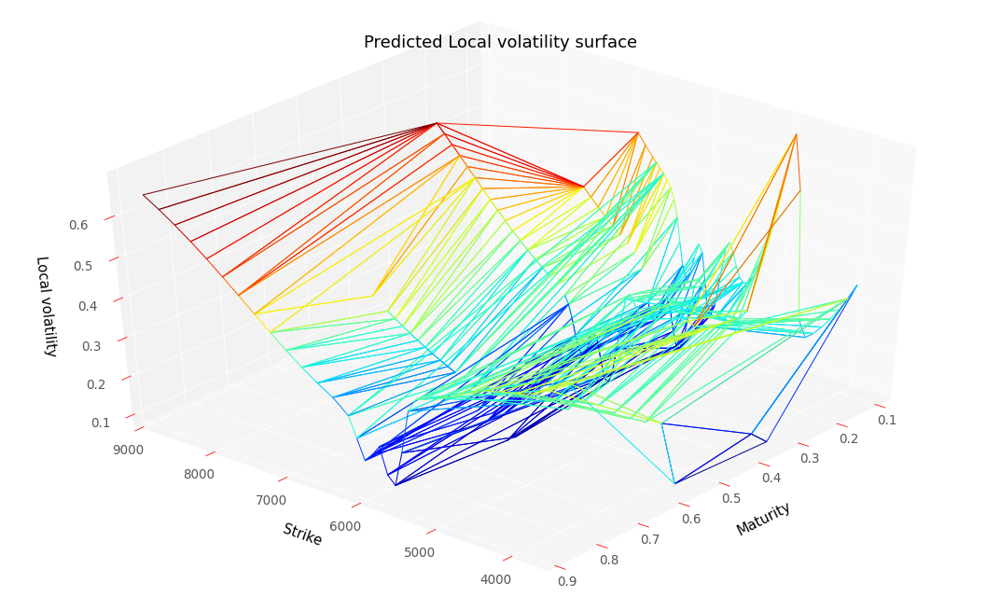

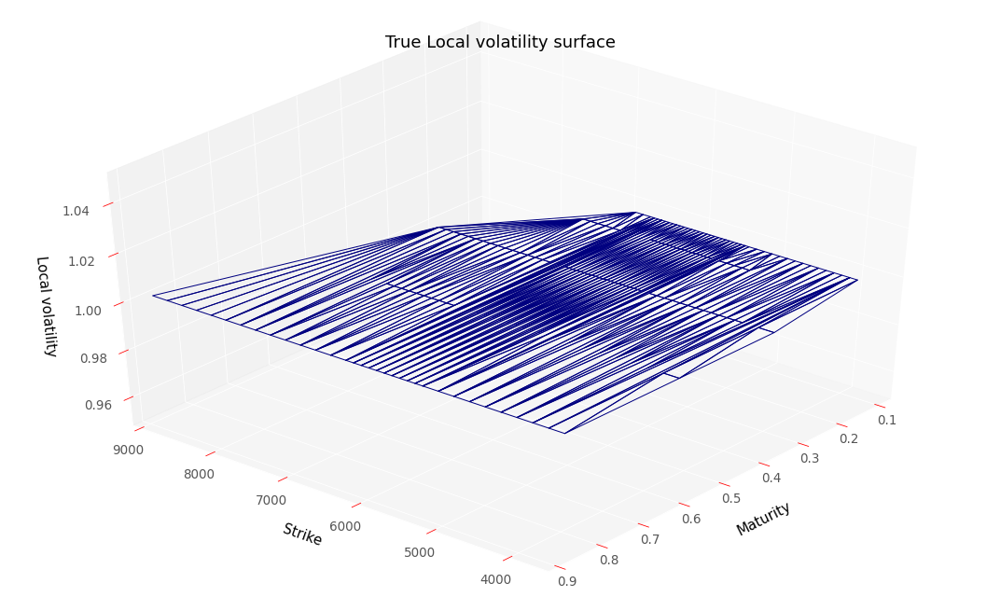

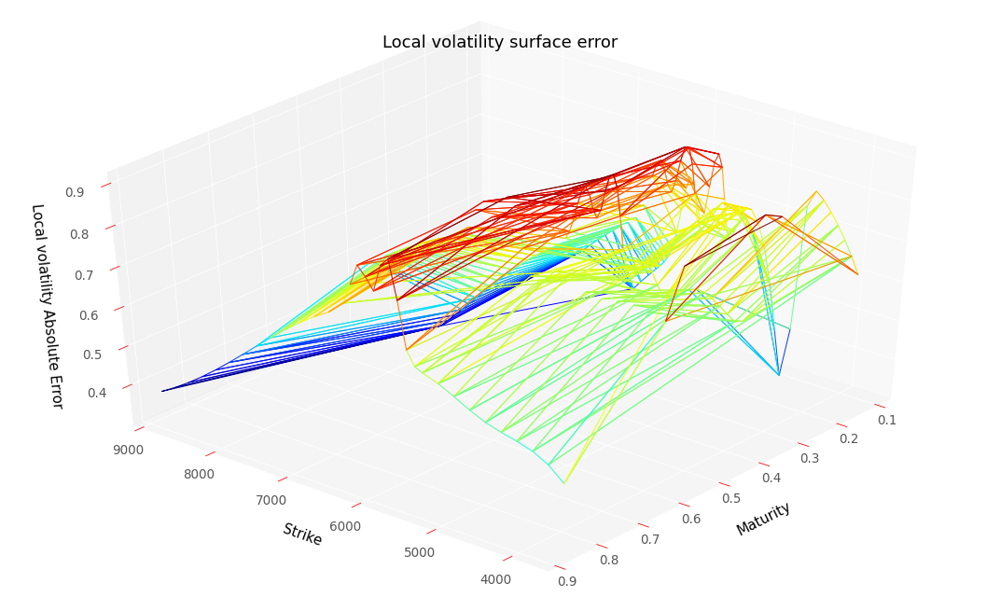

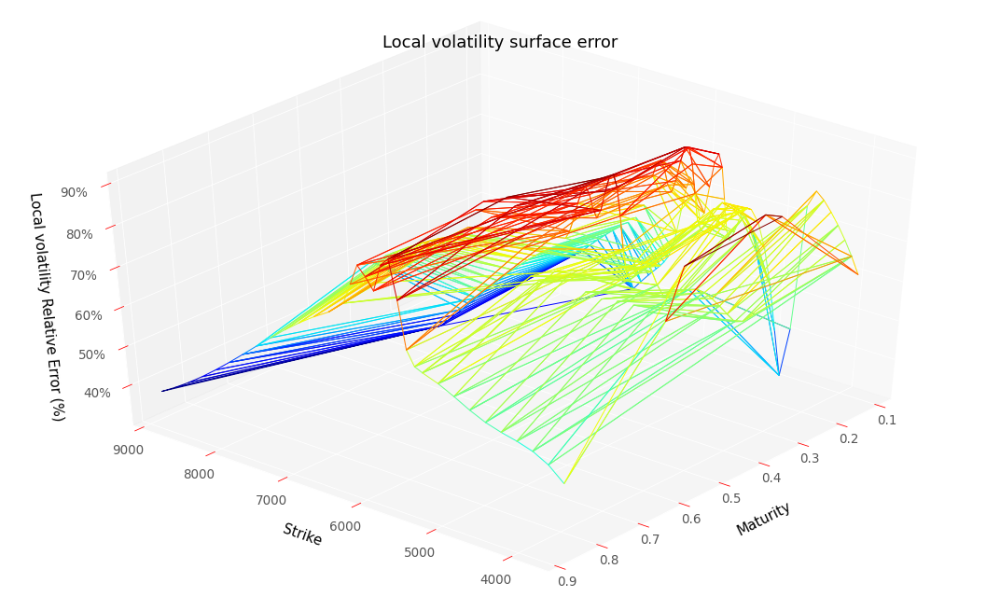

RMSE :  0.6861002353691553
RMSE Relative:  0.6861002353691553


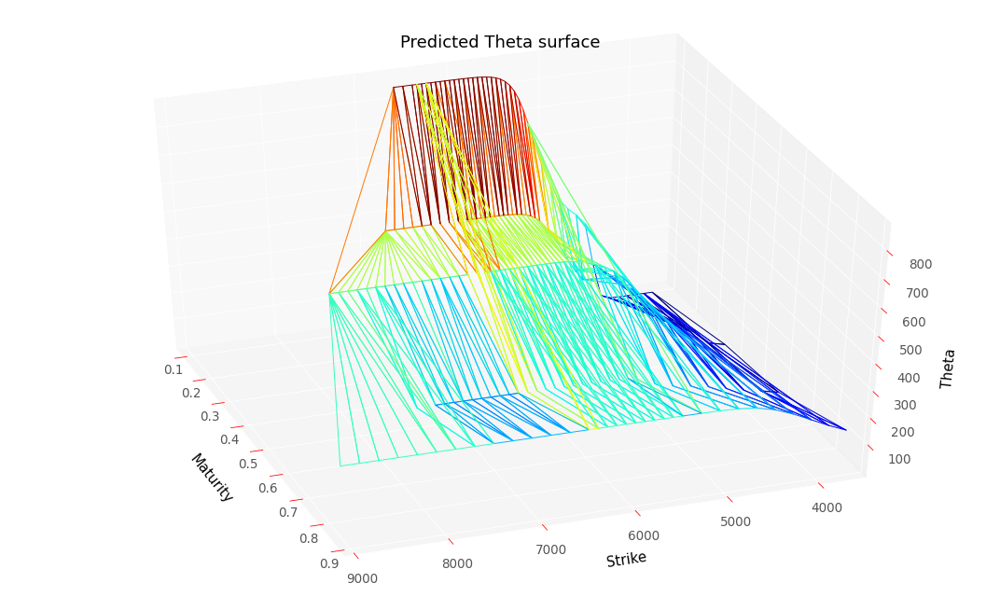

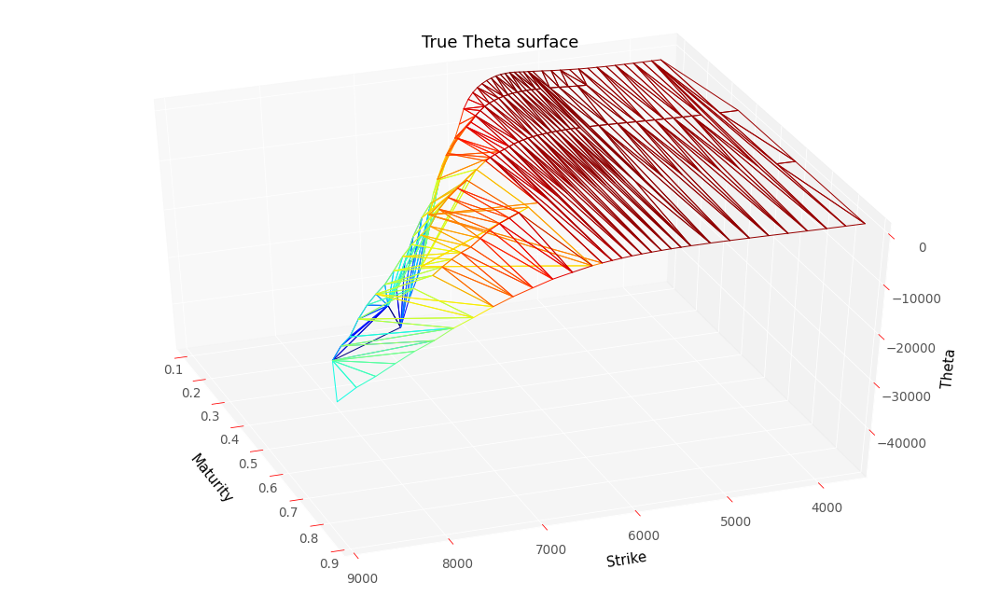

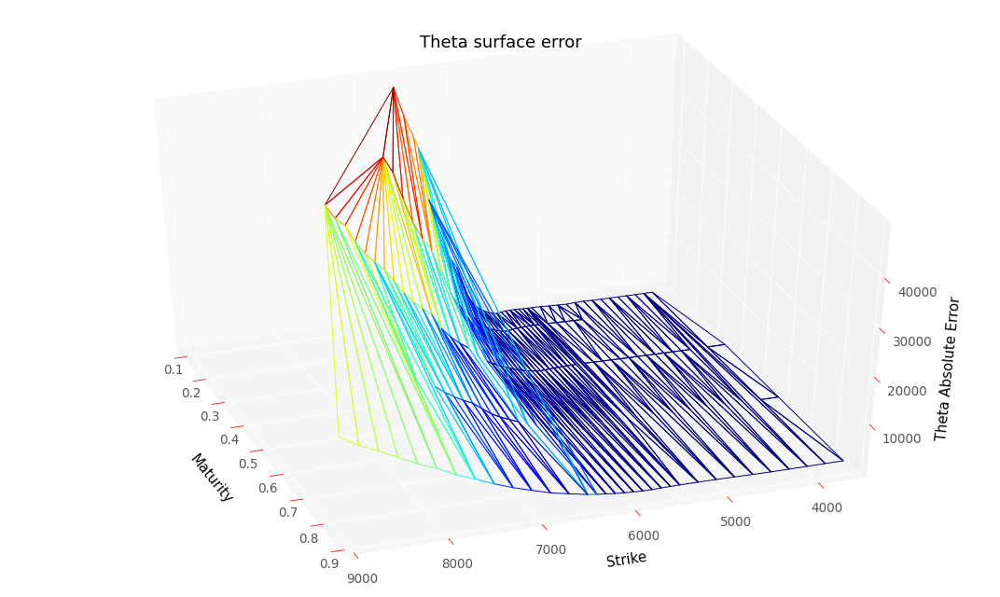

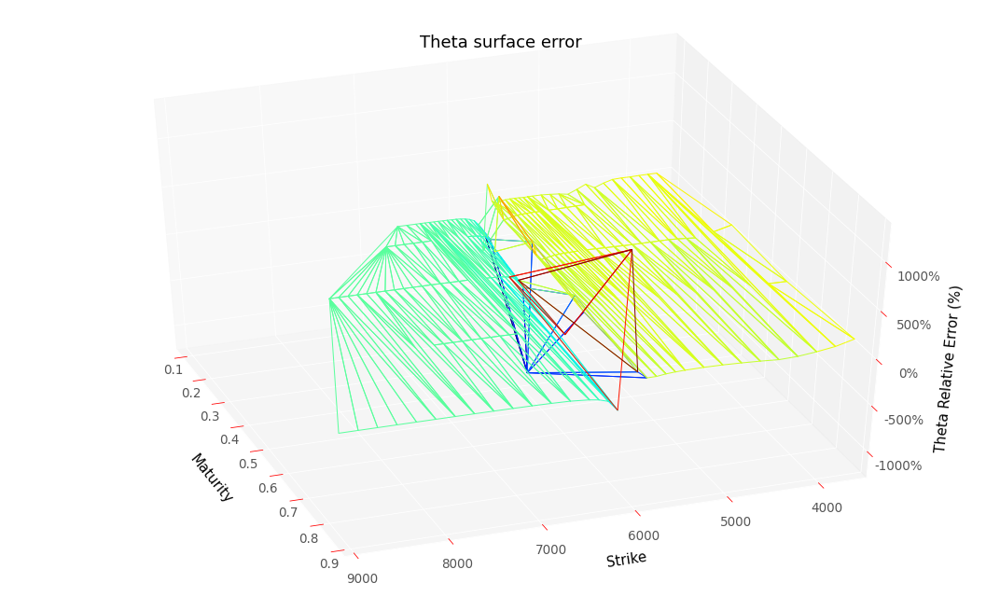

RMSE :  12461.962468454158
RMSE Relative:  1.6820452712906306


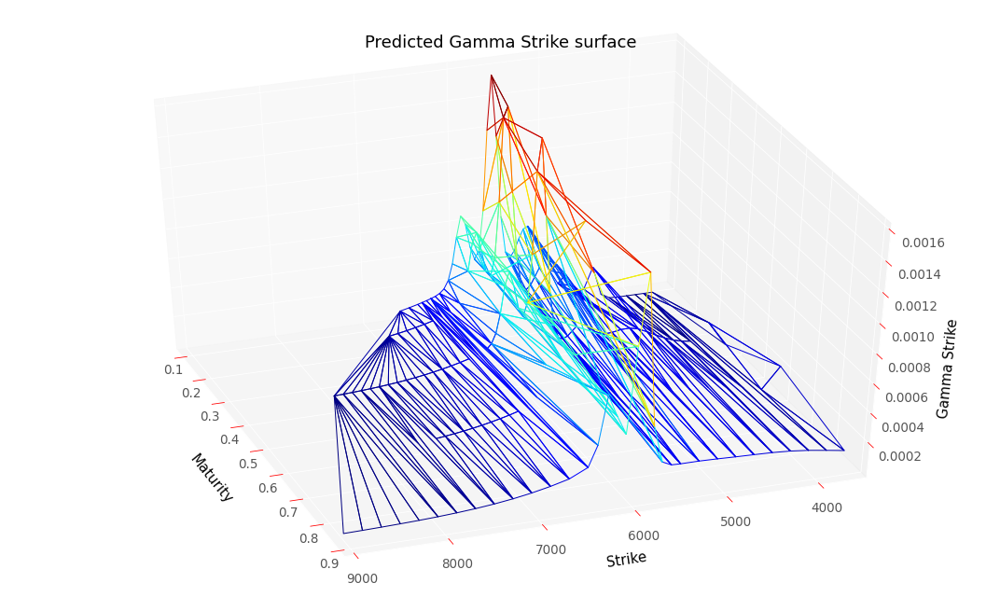

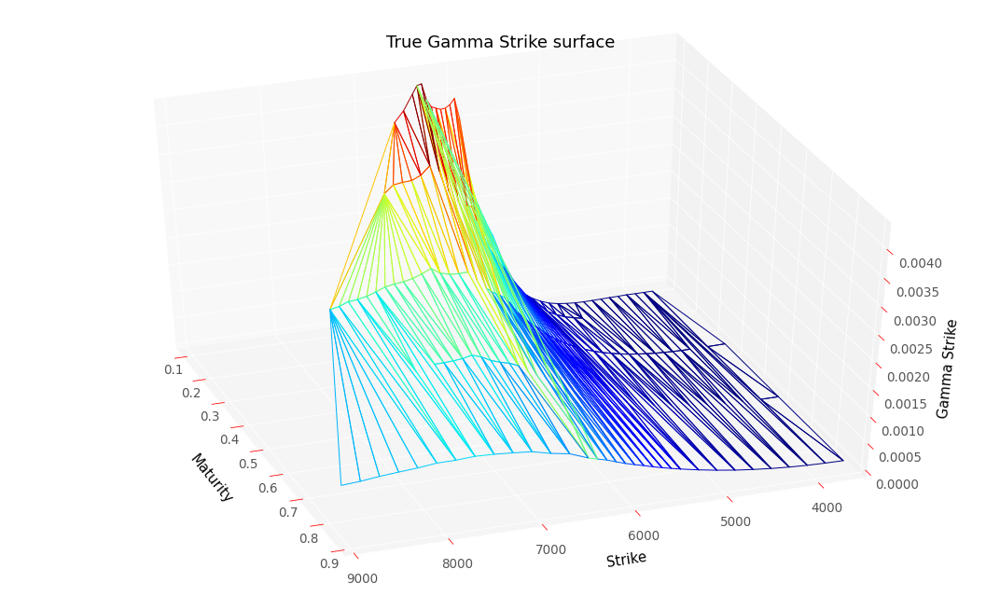

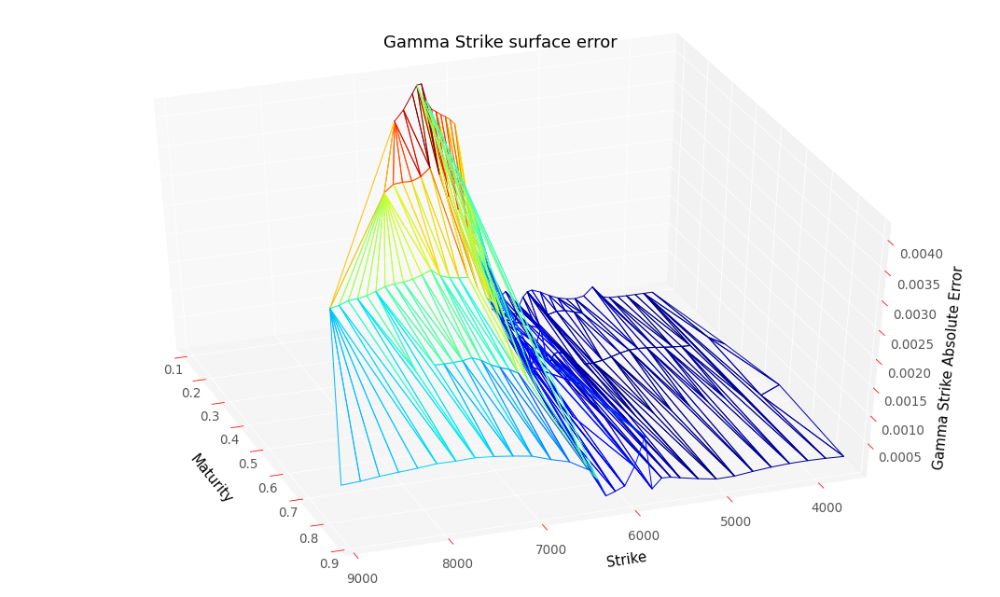

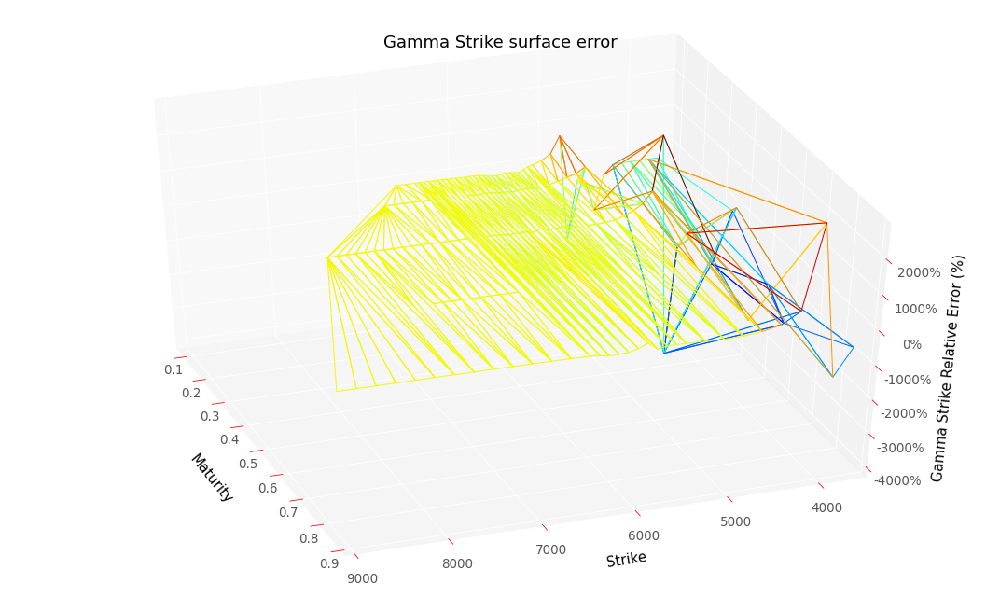

RMSE :  0.0014428534247874956
RMSE Relative:  5.490883248321011


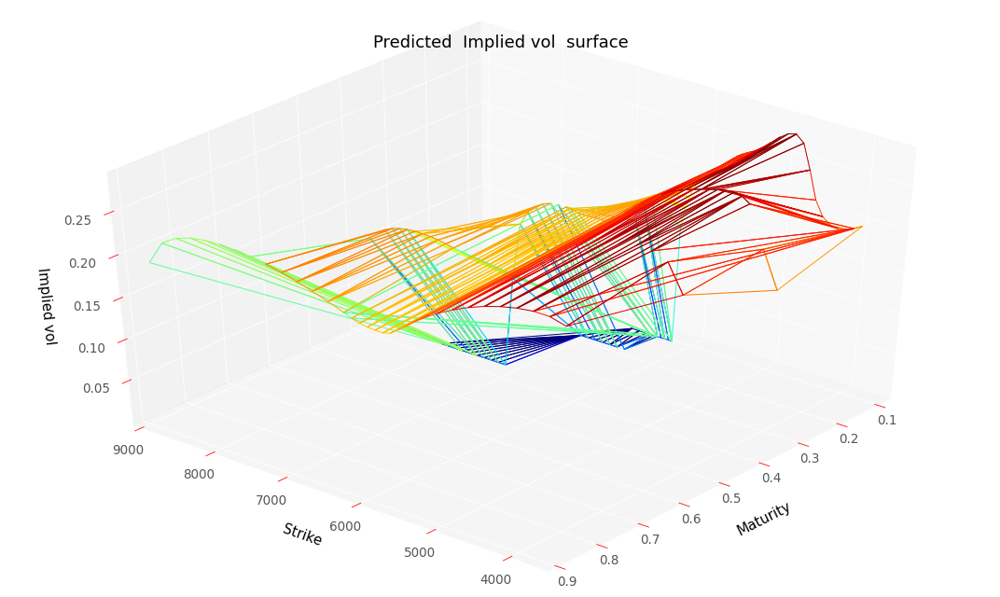

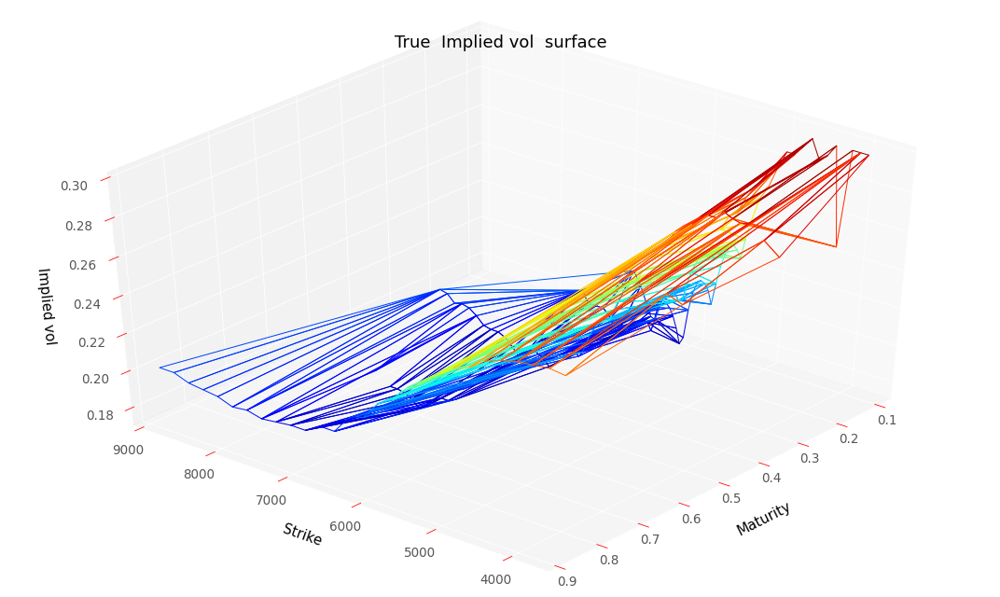

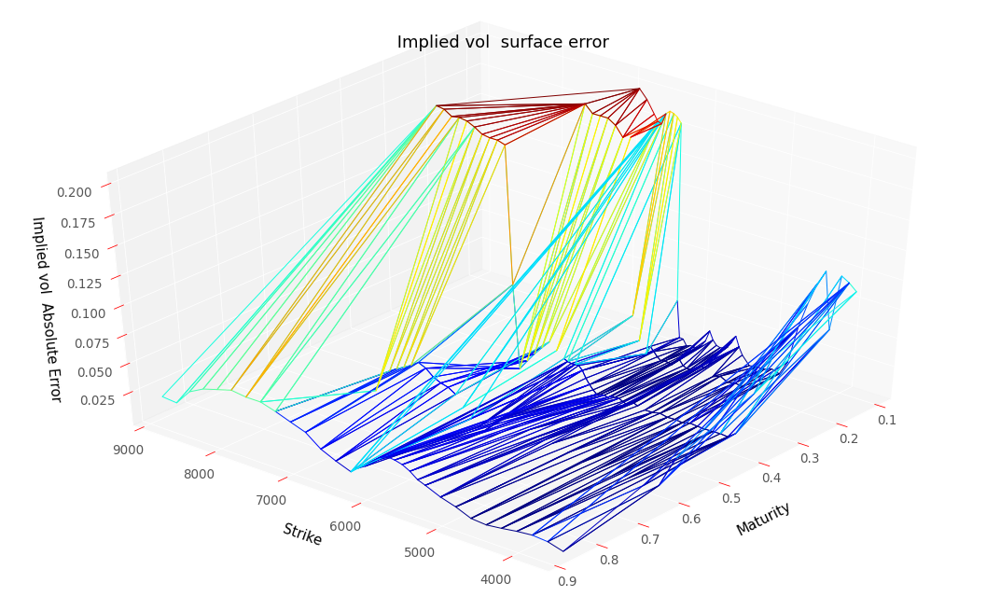

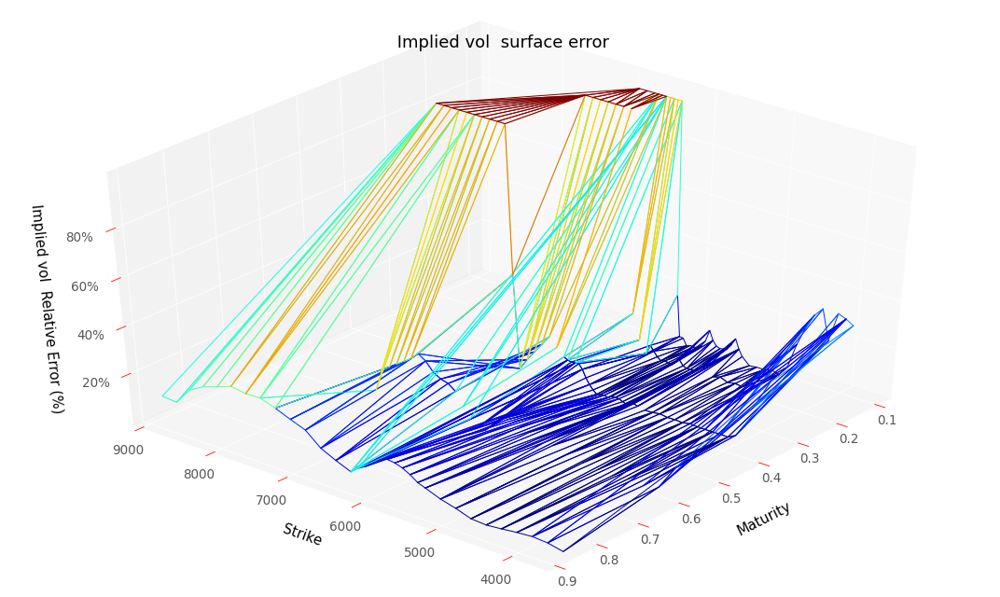

RMSE :  0.07618059177315224
RMSE Relative:  0.389283625492218


In [35]:
# Evaluate results on the training set, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureHardConstrainedDupire,
                                      scaledDataSet,
                                      True,
                                      hyperparameters,
                                      scaler,
                                      modelName = "regularizedHardDupireVolModel")
y_pred2, volLocale2, dNN_T2, gNN_K2, lossSerie2 = res

plotTools.modelSummary(y_pred2,
                       volLocale2, 
                       dNN_T2, 
                       gNN_K2, 
                       dataSet,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralRegularizedHardPriceTrain")

In [36]:
volLocale2.loc[(midS0,slice(None))]

Strike  Maturity
5650    0.000       0.117988
        0.000       0.117988
        0.121       0.185354
        0.197       0.136310
        0.370       0.157012
Name: Dupire, dtype: float32

Best loss (hidden nodes: 200, iterations: 0): 4.00
Best Penalization :  [54.33005, [0.13888405]]
Best Penalization (Refined Grid) :  [[0.0]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


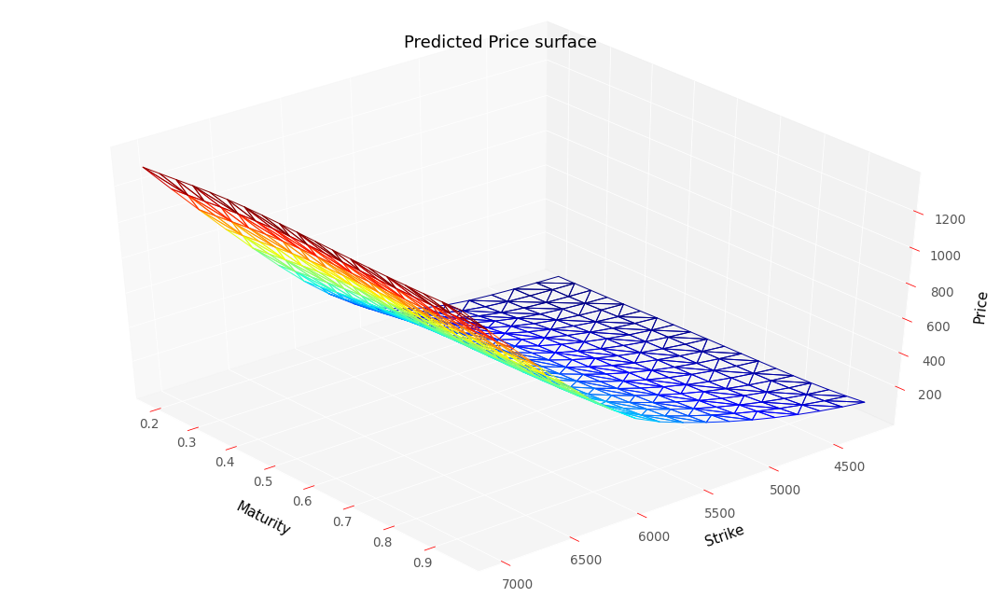

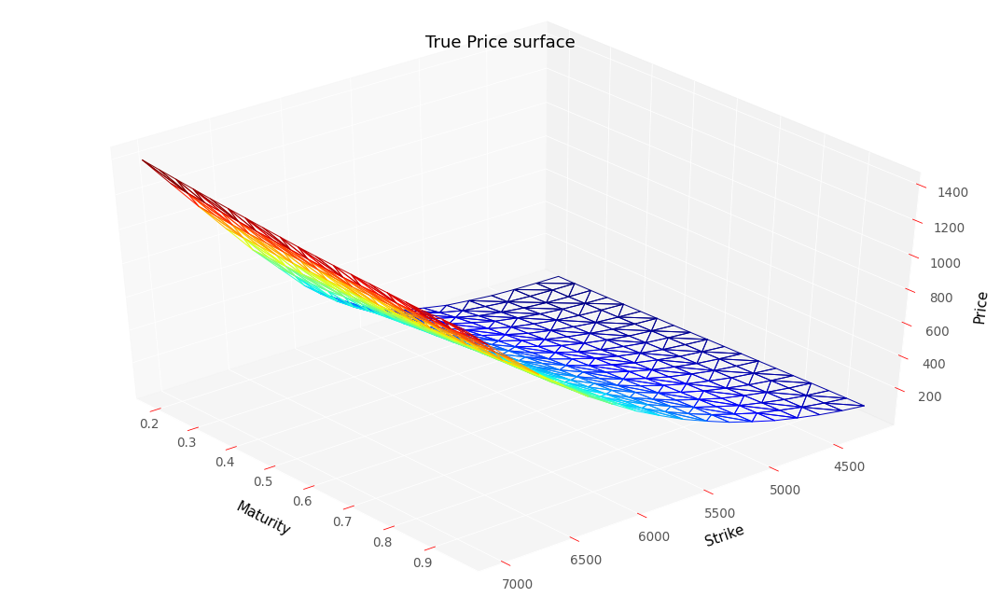

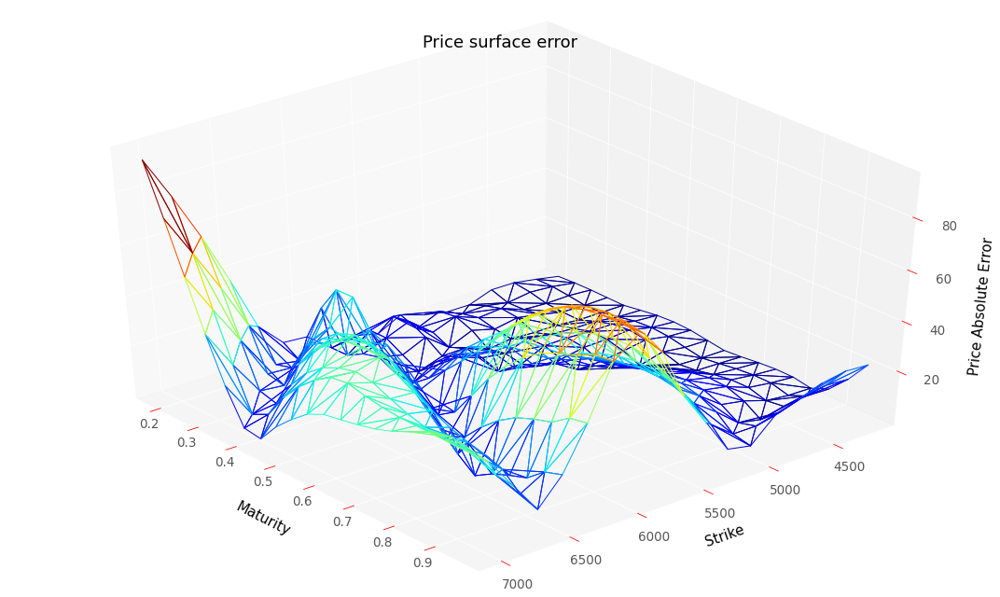

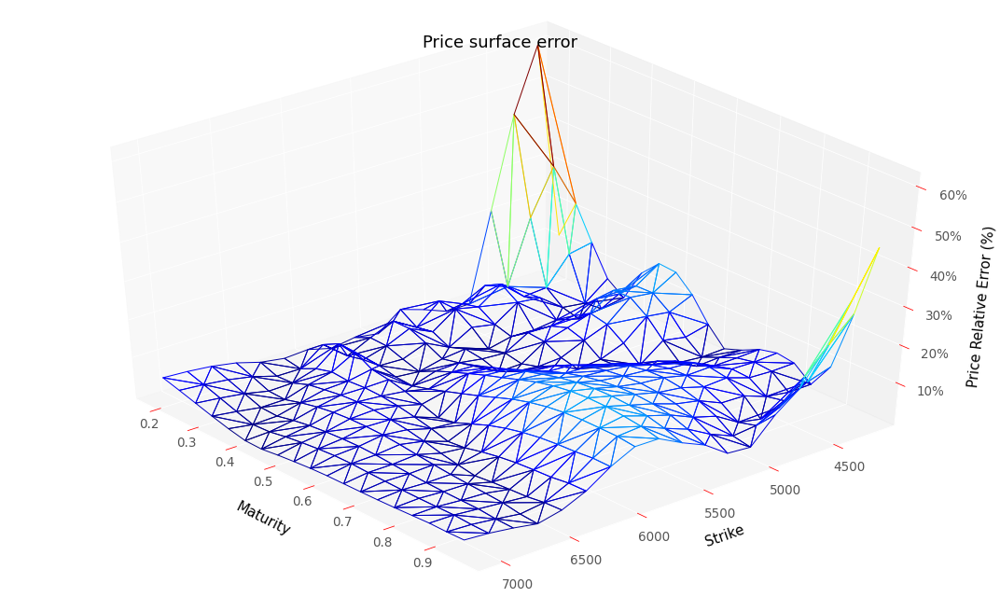

RMSE :  25.142657443279933
RMSE Relative:  0.08638487215044251


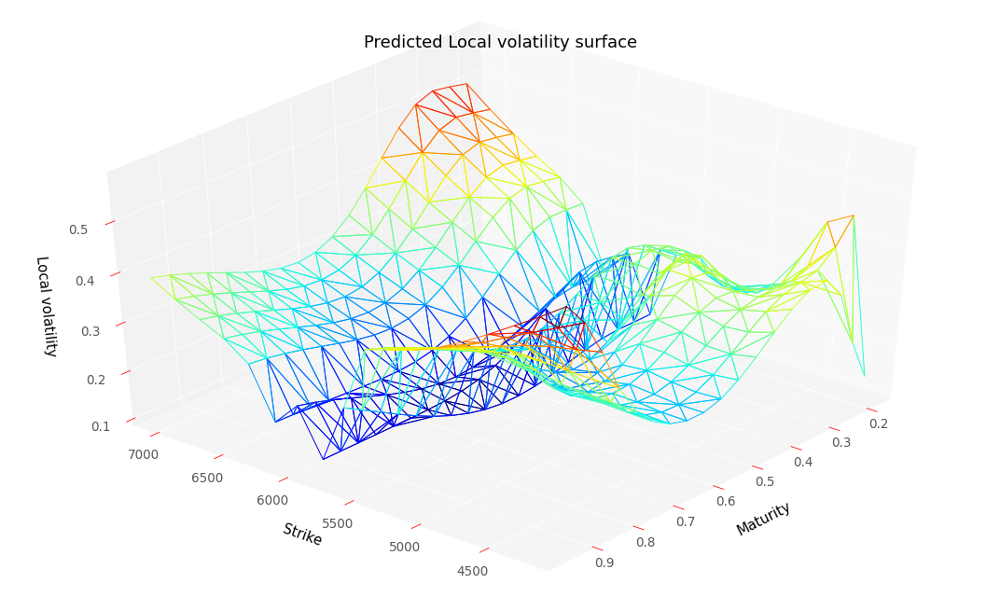

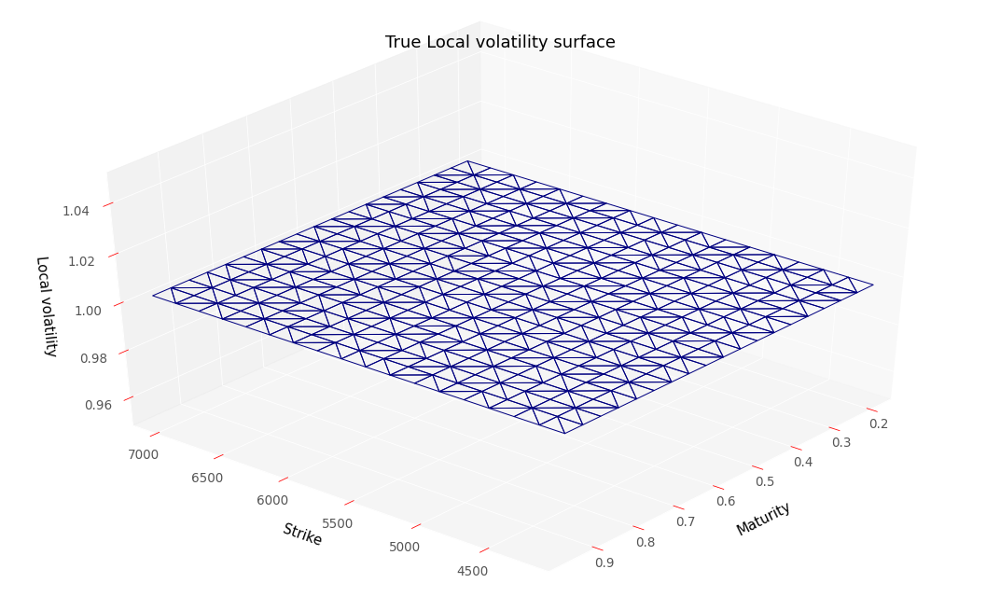

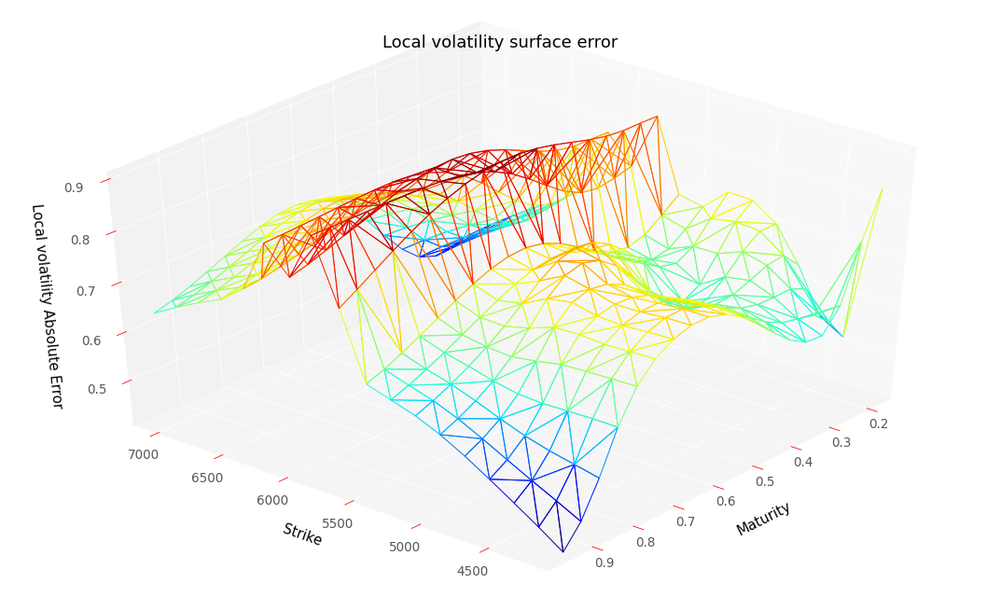

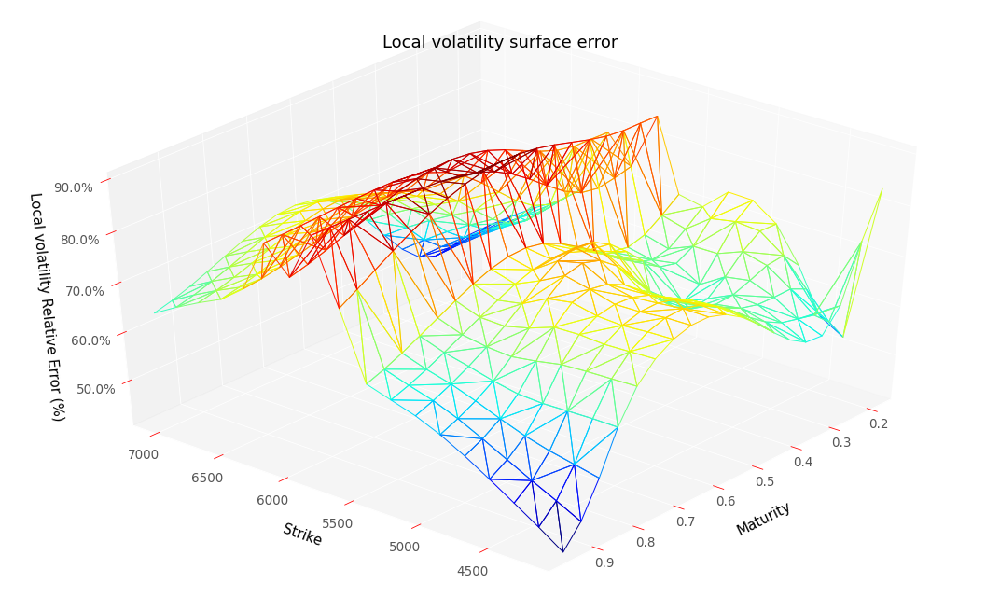

RMSE :  0.7161616473833824
RMSE Relative:  0.7161616473833824


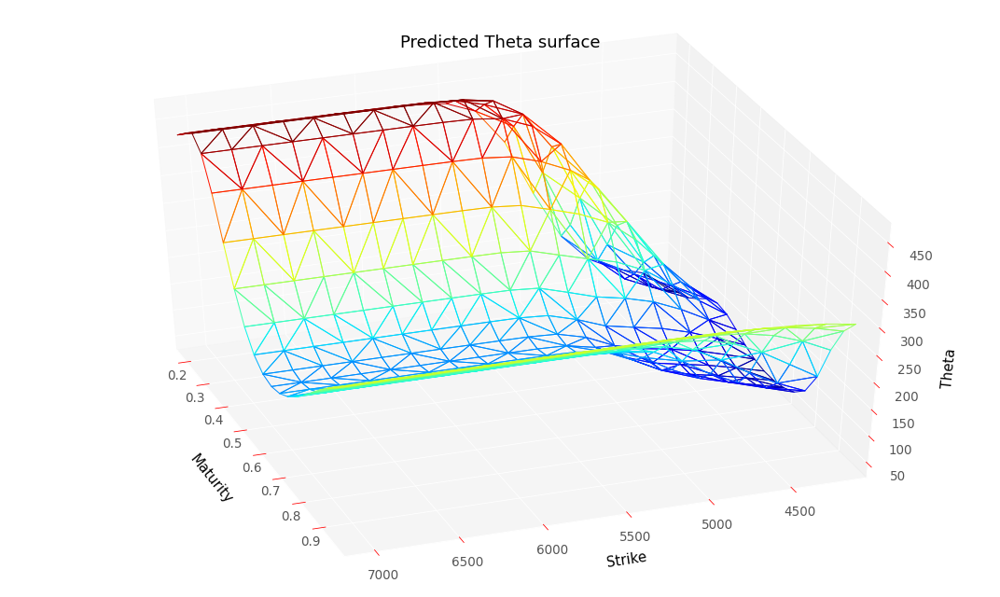

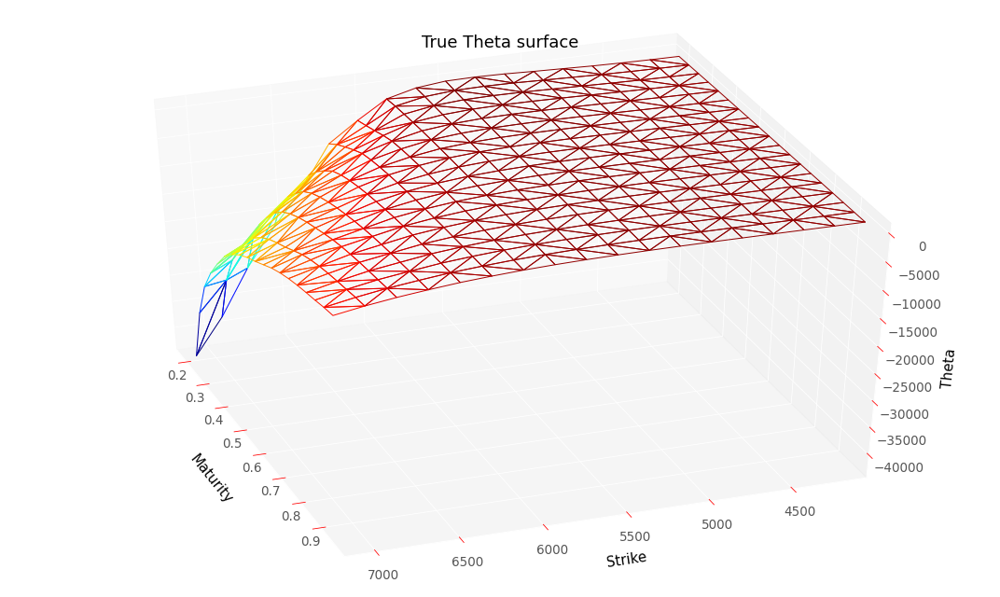

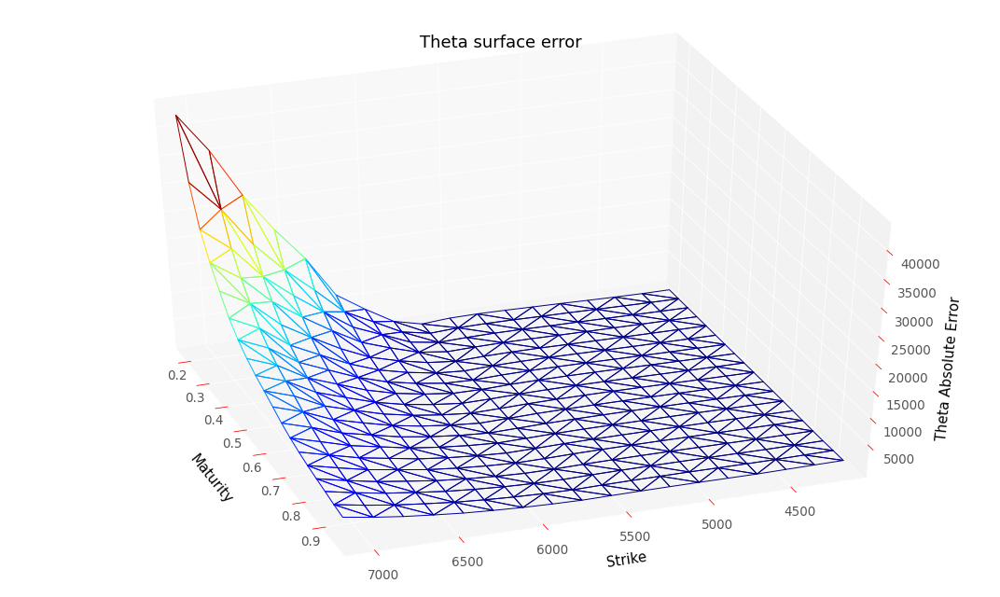

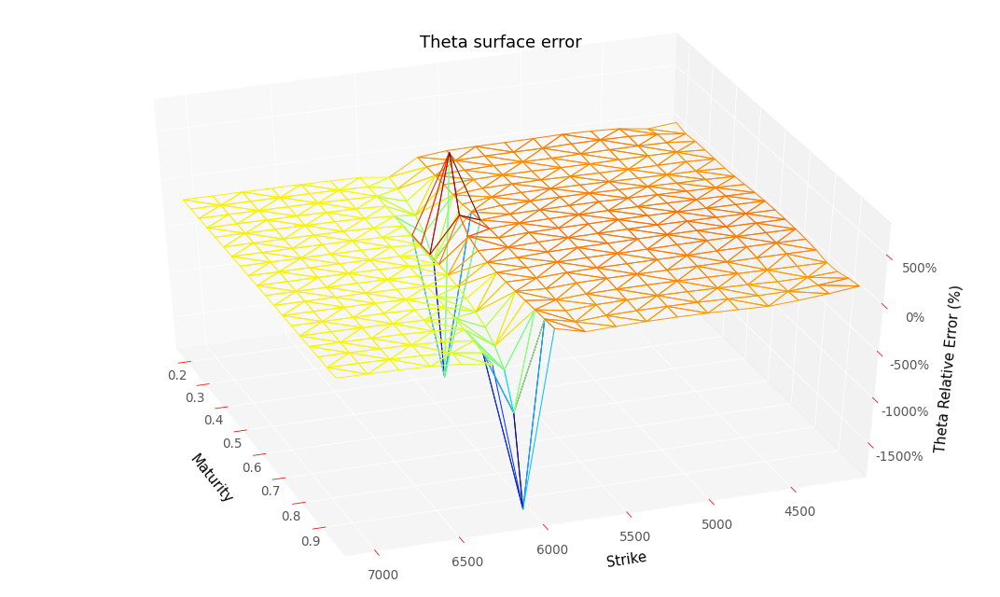

RMSE :  6468.668527350901
RMSE Relative:  1.796381407440149


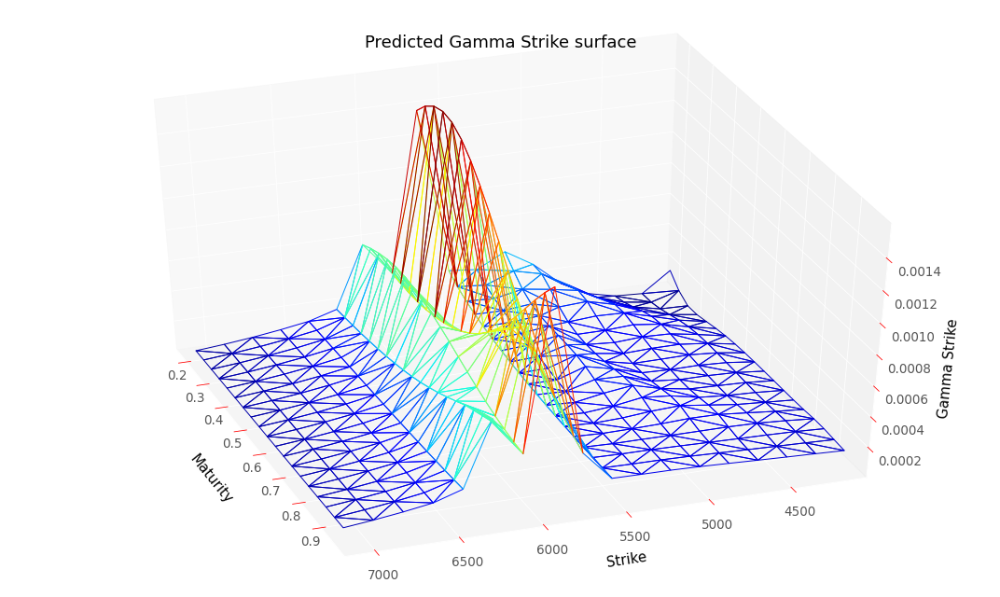

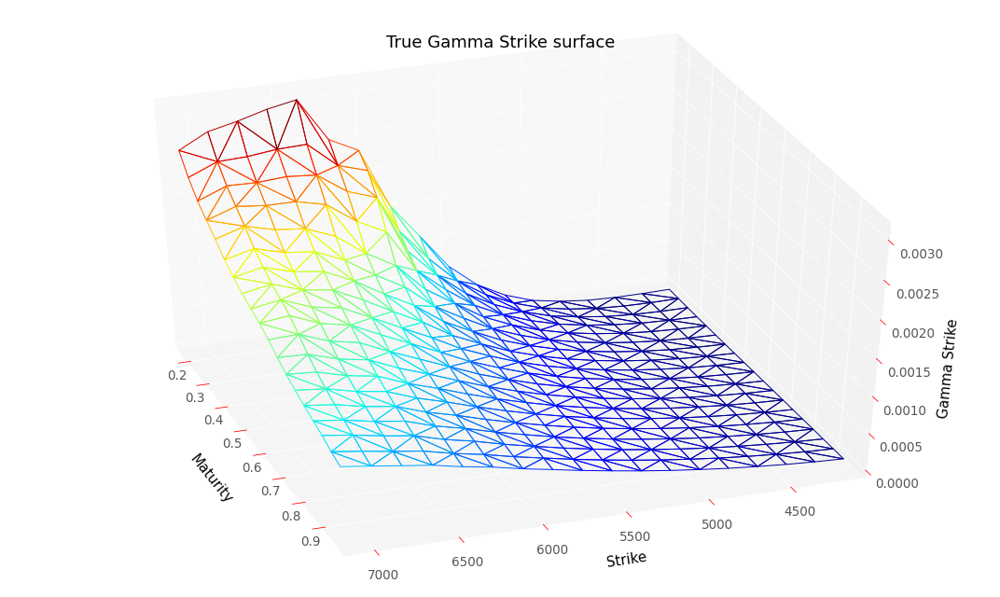

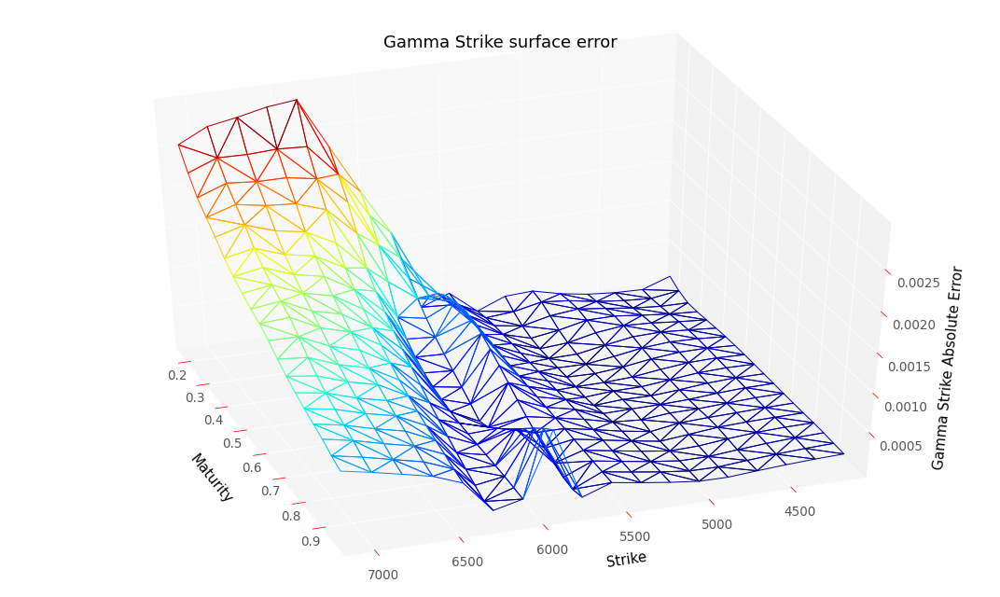

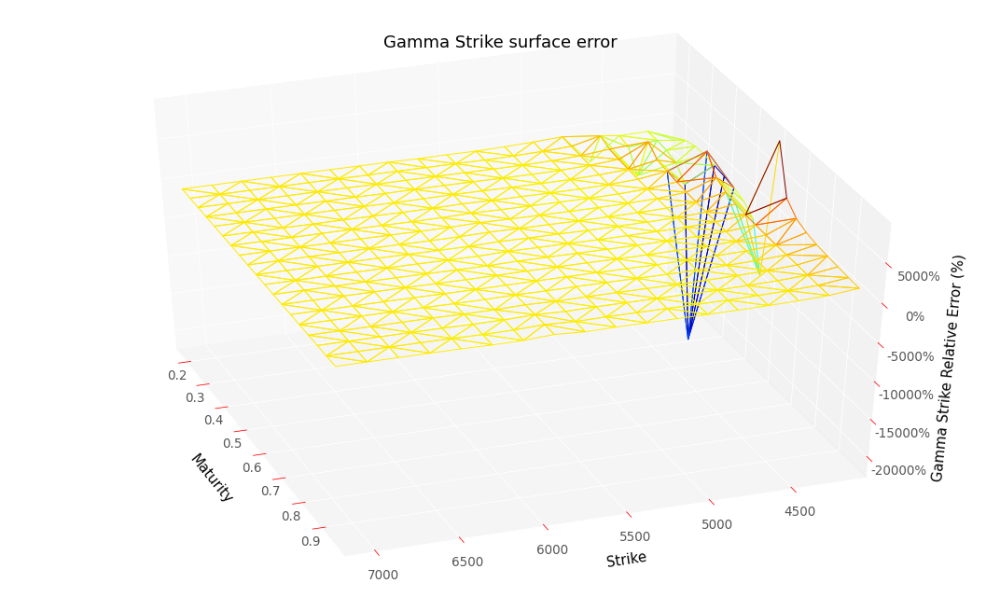

RMSE :  0.0009224038026903057
RMSE Relative:  14.84161598629811


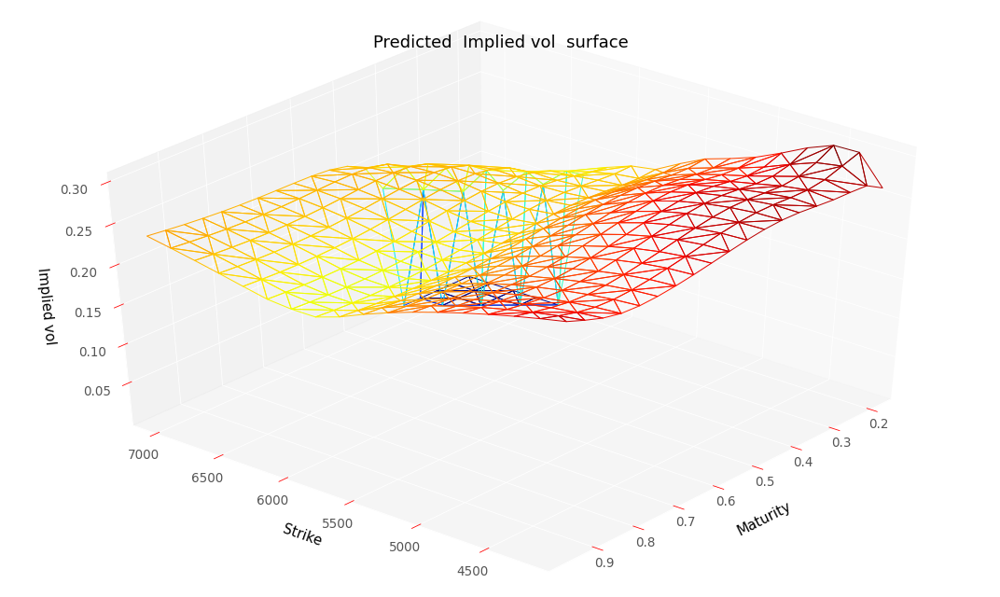

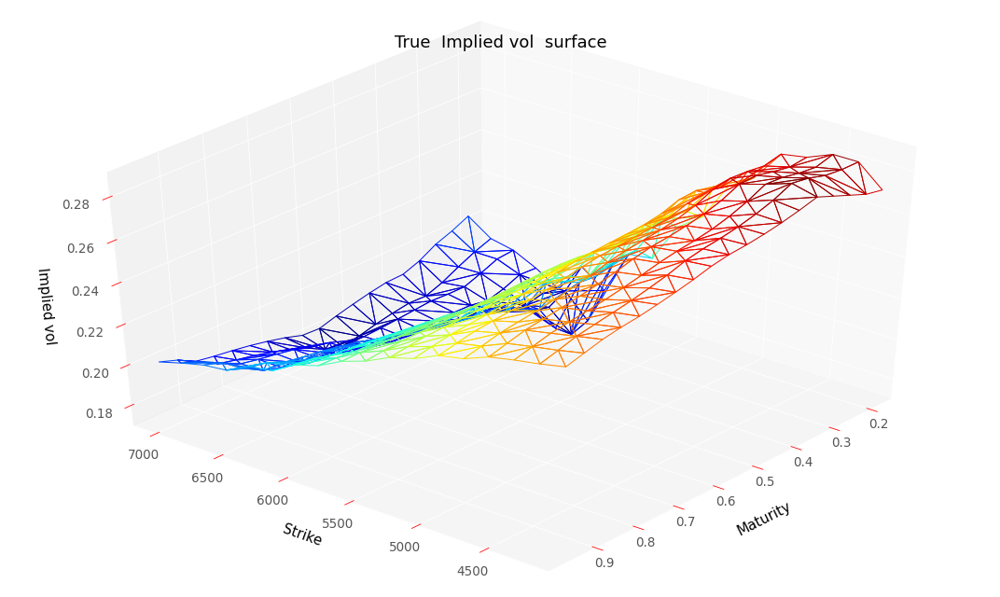

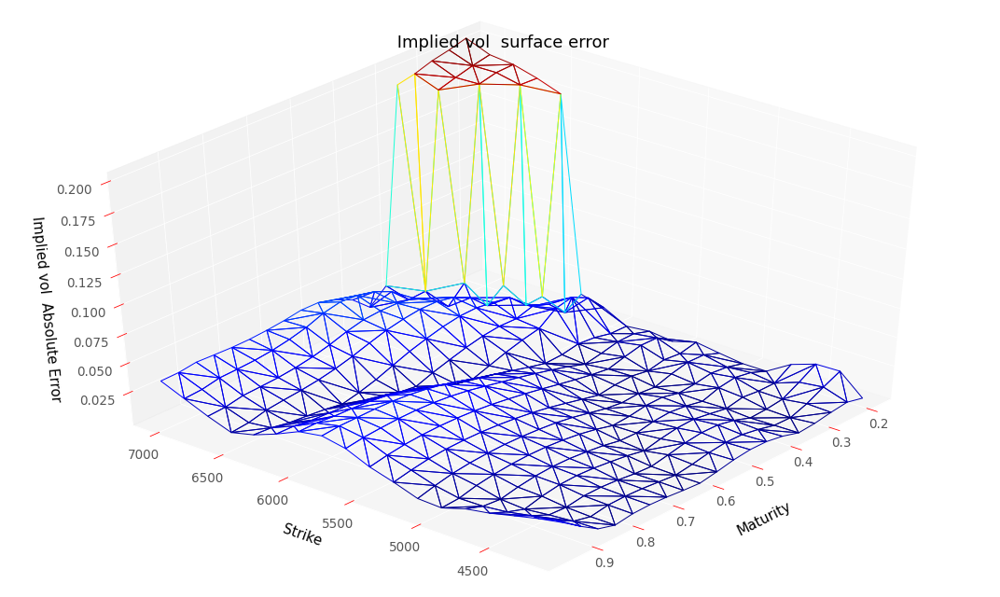

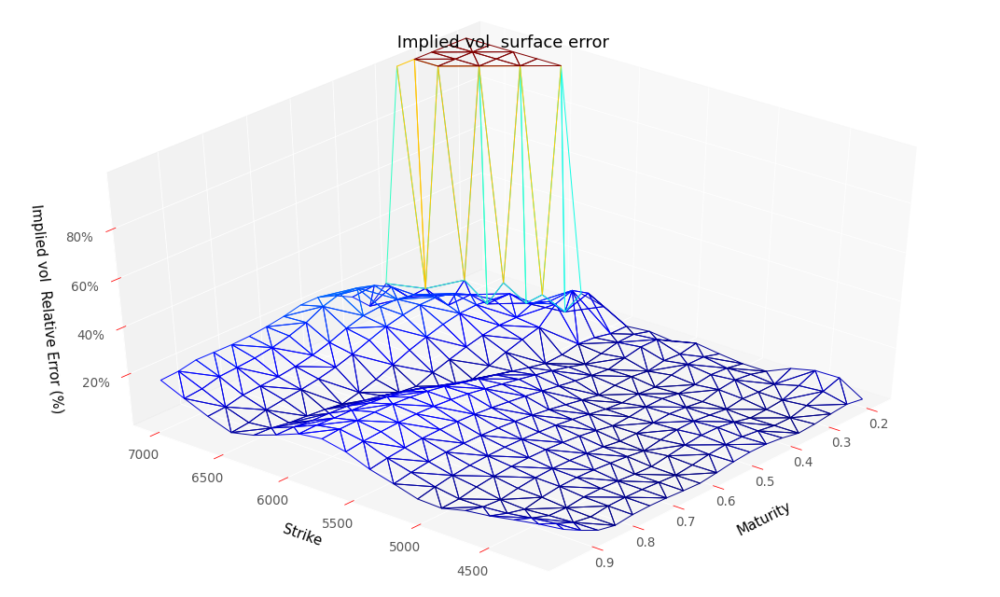

RMSE :  0.04333095889799705
RMSE Relative:  0.2253110277290574


In [37]:
# Evaluate results on the testing dataset, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureHardConstrainedDupire,
                                      scaledDataSetTest,
                                      True,
                                      hyperparameters,
                                      scaler,
                                      modelName = "regularizedHardDupireVolModel")
y_pred2Test, volLocale2Test, dNN_T2Test, gNN_K2Test, lossSerie2TestG = res

plotTools.modelSummary(y_pred2Test,
                       volLocale2Test,
                       dNN_T2Test,
                       gNN_K2Test,
                       dataSetTest,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralRegularizedHardPriceTest")

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


In [38]:
S0

5614.51

In [39]:
# Function which evaluates neural local volatility when neural network is fitted on prices
def neuralVolLocalePrix(s,t):
    vLoc = neuralNetwork.evalVolLocale(neuralNetwork.NNArchitectureHardConstrainedDupire,
                                       s, t,
                                       dataSet,
                                       hyperparameters,
                                       scaler,
                                       bootstrap,
                                       S0,
                                       modelName = "regularizedHardDupireVolModel")
    return vLoc.dropna()

In [40]:
importlib.reload(neuralNetwork)

<module 'neuralNetwork' from '/content/neuralNetwork.py'>

In [41]:
#Artificial grid with 10000 points which aims to limit the impact of linear interpolation
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)

In [42]:
volLocalInterp = neuralVolLocalePrix(volLocaleGrid[0].flatten(),
                                     volLocaleGrid[1].flatten())
volLocalInterp.head()

Strike       Maturity
3600.000000  0.0         0.970535
3654.545455  0.0         0.934698
3709.090909  0.0         0.900275
3763.636364  0.0         0.867160
3818.181818  0.0         0.835254
dtype: float32

In [43]:
volLocalInterp2 = neuralVolLocalePrix(dataSetTest.index.get_level_values("Strike").values.flatten(),
                                      dataSetTest.index.get_level_values("Maturity").values.flatten())
volLocalInterp2.head()

Strike   Maturity
4107.46  0.000       0.682087
         0.000       0.682087
         0.200       0.151512
         0.242       0.238659
         0.284       0.350765
dtype: float32

In [44]:
#Local volatility function for backtests
nnVolLocale = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp, x, y)

In [45]:
#Local volatility function for backtests
nnVolLocale2 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp2, x, y)

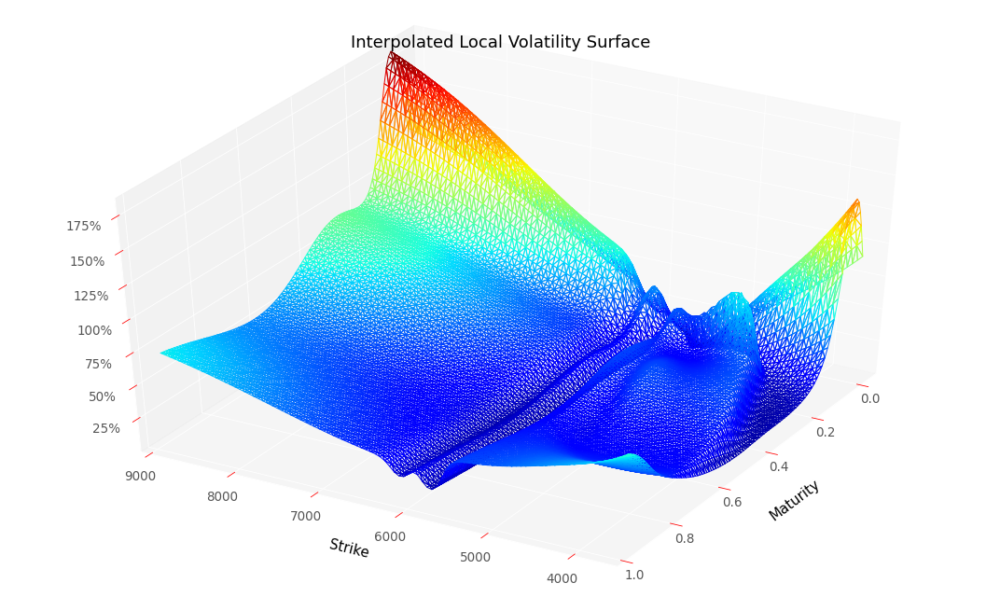

In [46]:
plotTools.plotSerie(volLocalInterp,
                    Title = 'Interpolated Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

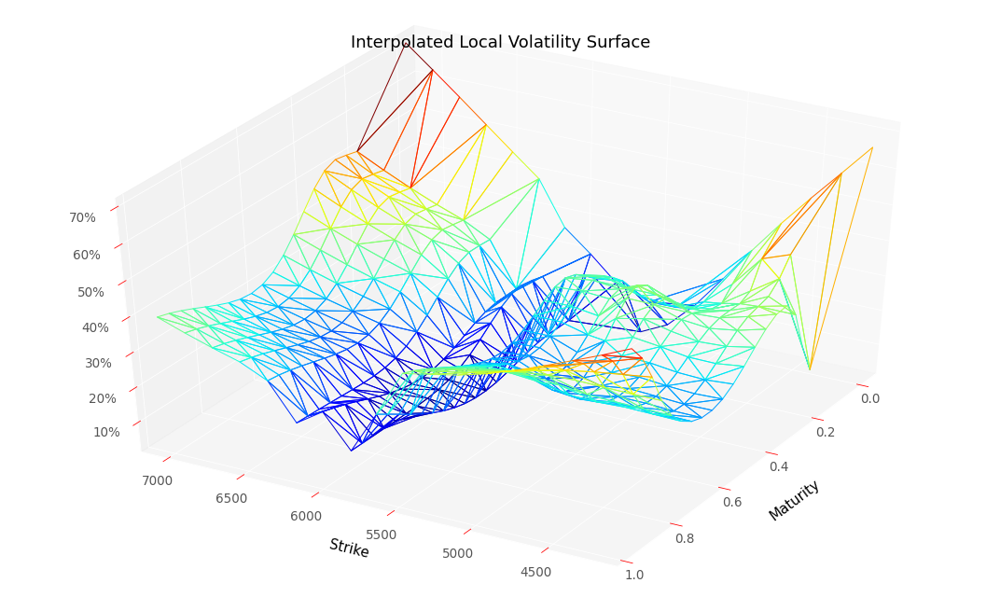

In [47]:
plotTools.plotSerie(volLocalInterp2,
                    Title = 'Interpolated Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

In [48]:
nbTimeStep = 100
nbPaths = 100000

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the 10000 points grid.
mcResVolLocalePrix = backtest.MonteCarloPricerVectorized(S0,
                                                         dataSetTest,
                                                         bootstrap,
                                                         nbPaths,
                                                         nbTimeStep,
                                                         nnVolLocale)
mcResVolLocalePrix.head()

In [ ]:
plotTools.predictionDiagnosis(mcResVolLocalePrix["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocalePrix.to_csv("mcResVolLocaleHardPrix.csv")

In [ ]:
#PDE backtest with cranck-nicolson scheme
pdeResVolLocale = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale, bootstrap)
pdeResVolLocale.head()

Strike   Maturity
4107.46  0.000       0.000000
         0.000       0.000000
         0.200       1.331920
         0.242       2.118146
         0.284       3.889005
dtype: float64

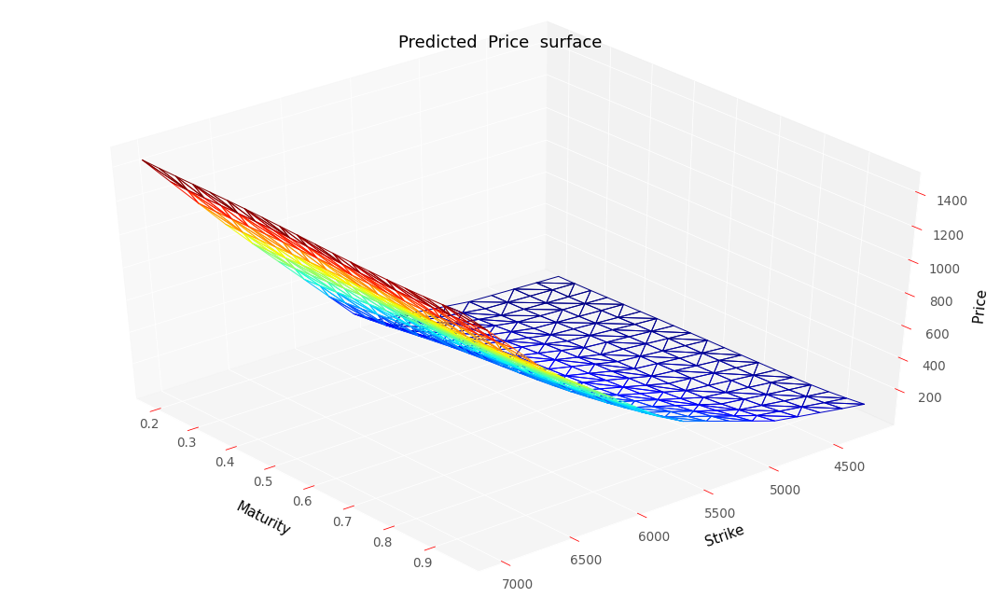

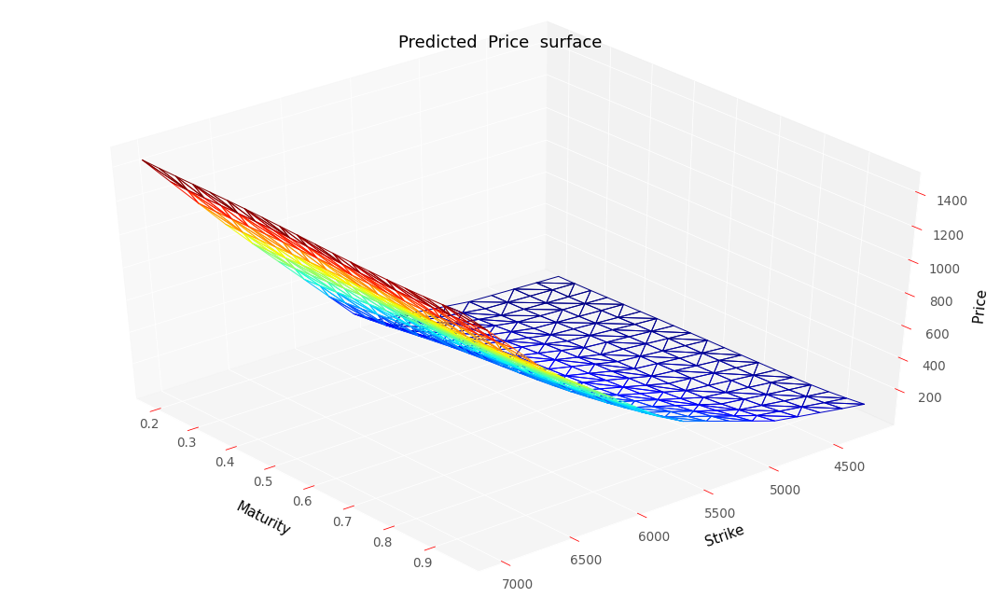

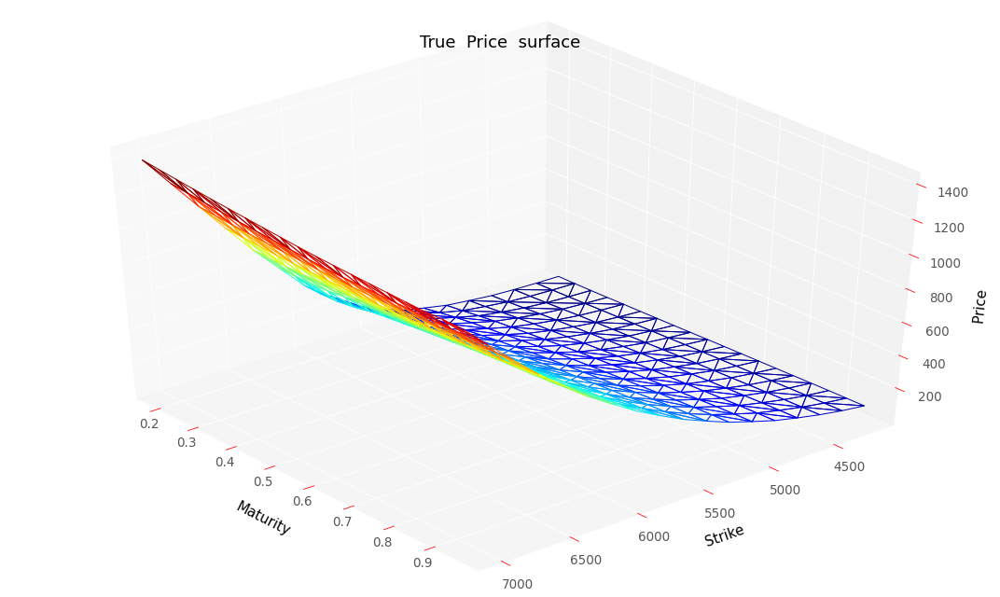

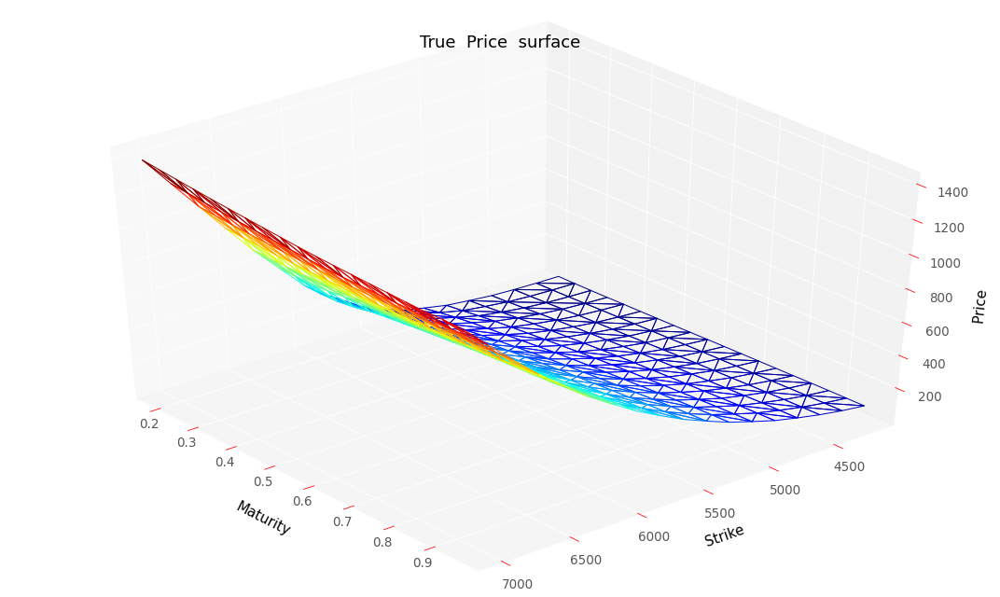

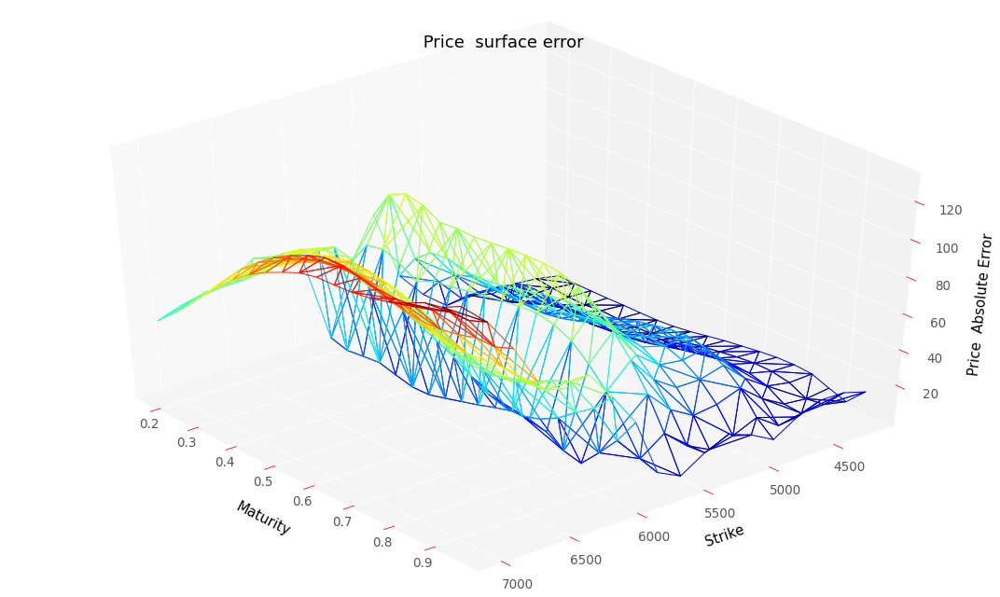

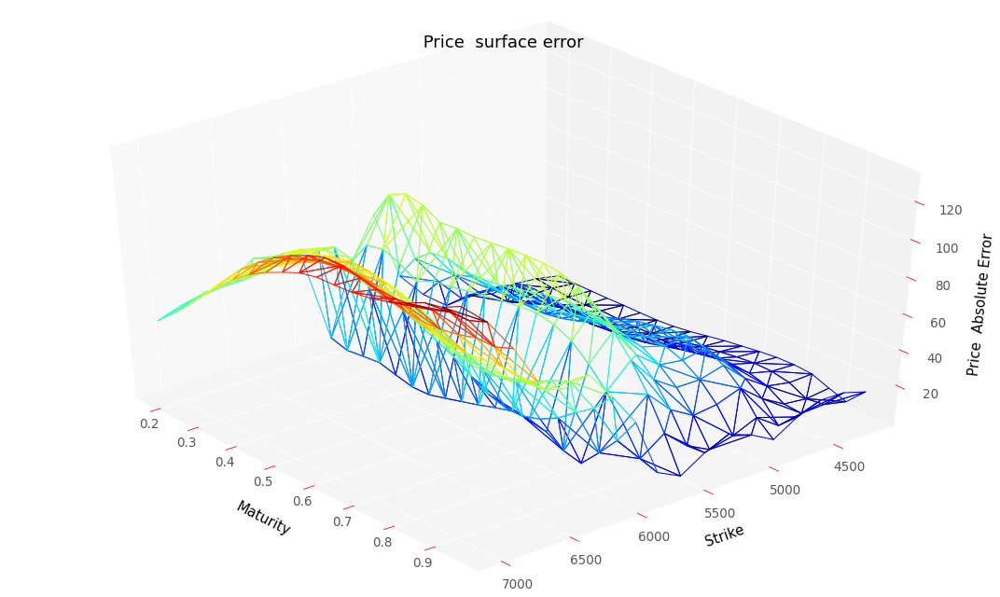

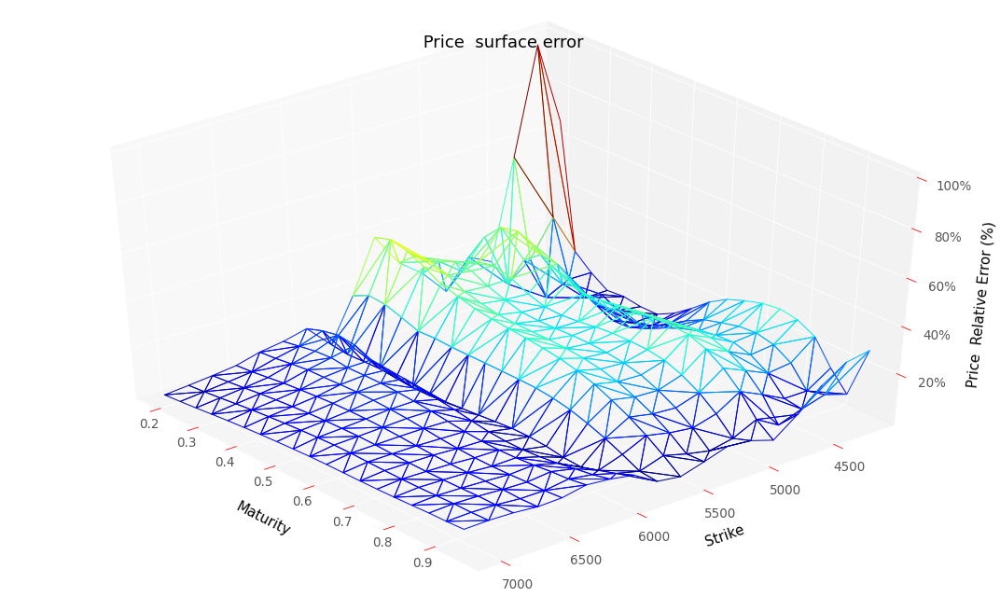

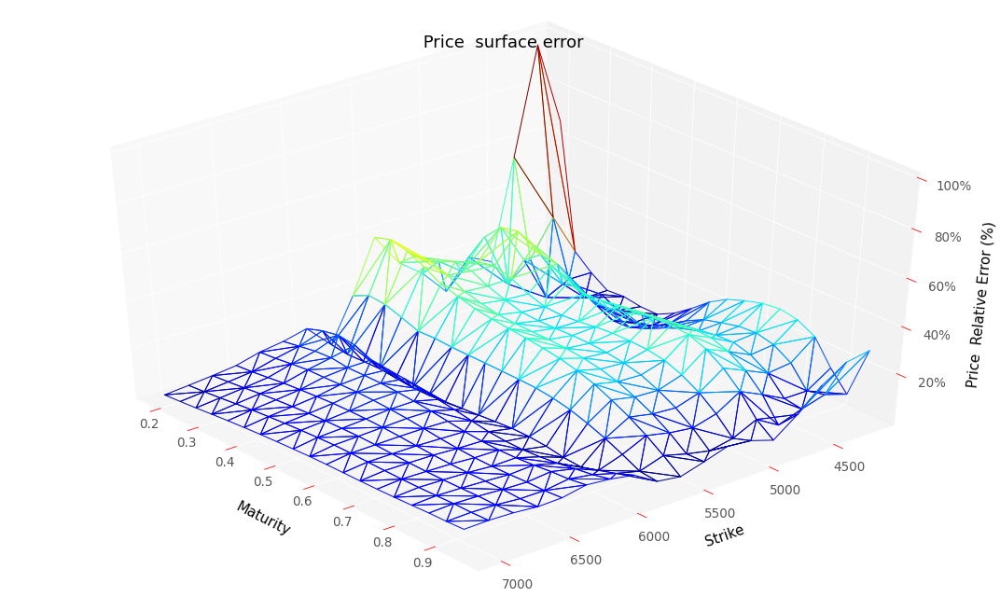

RMSE :  58.72537837081586
RMSE Relative:  0.18516644170459953
RMSE :  58.72537837081586
RMSE Relative:  0.18516644170459953


In [ ]:
plotTools.predictionDiagnosis(pdeResVolLocale, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale.to_csv(workingFolder + "pdeResVolLocaleHard.csv")

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the testing grid.
mcResVolLocalePrix2 = backtest.MonteCarloPricerVectorized(S0,
                                                          dataSetTest,
                                                          bootstrap,
                                                          nbPaths,
                                                          nbTimeStep,
                                                          nnVolLocale2)
mcResVolLocalePrix2.head()

Price   stdPrice
Strike  Maturity                     
4107.46 0.000     0.000000   0.000000
        0.000     0.000000   0.000000
        0.200     0.064987   3.169954
        0.242     0.333174   7.904943
        0.284     1.060316  18.327758

Price   stdPrice
Strike  Maturity                     
4107.46 0.000     0.000000   0.000000
        0.000     0.000000   0.000000
        0.200     0.064987   3.169954
        0.242     0.333174   7.904943
        0.284     1.060316  18.327758

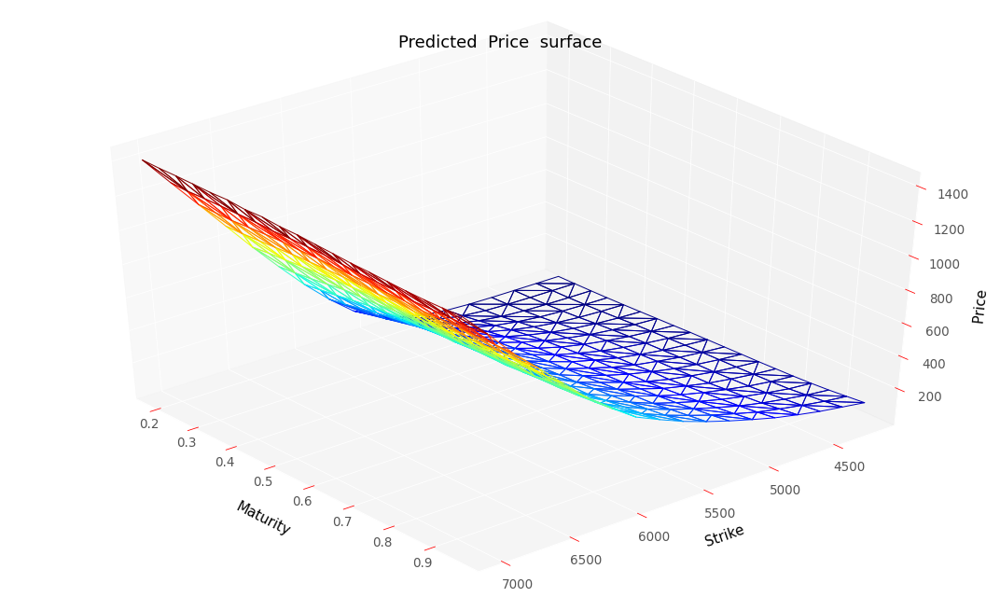

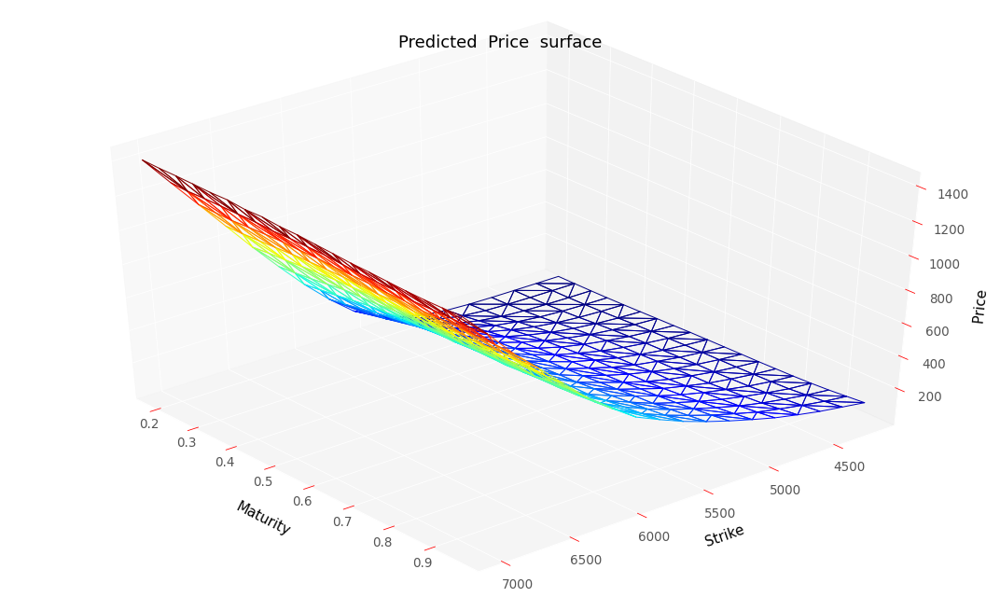

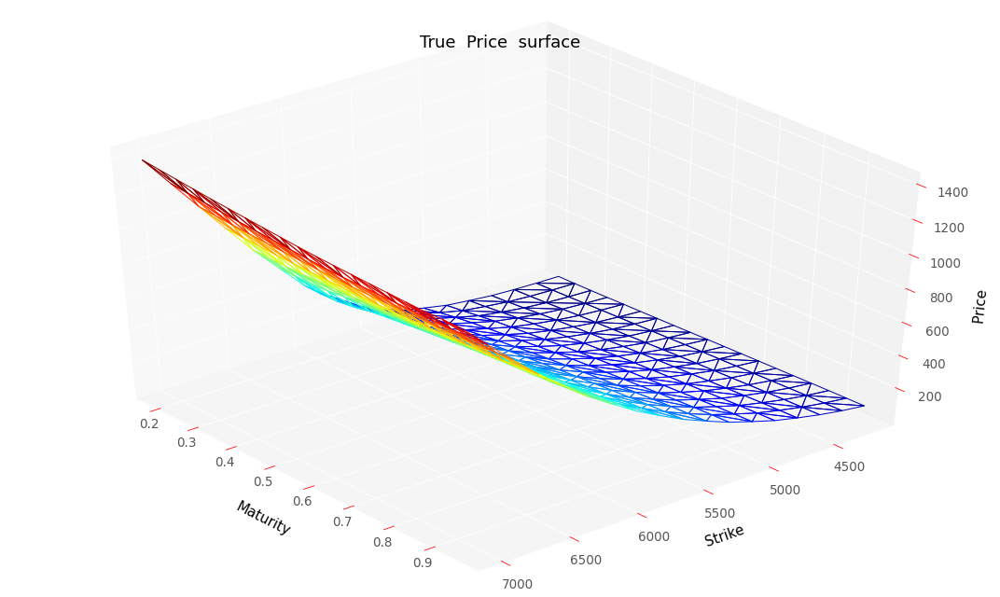

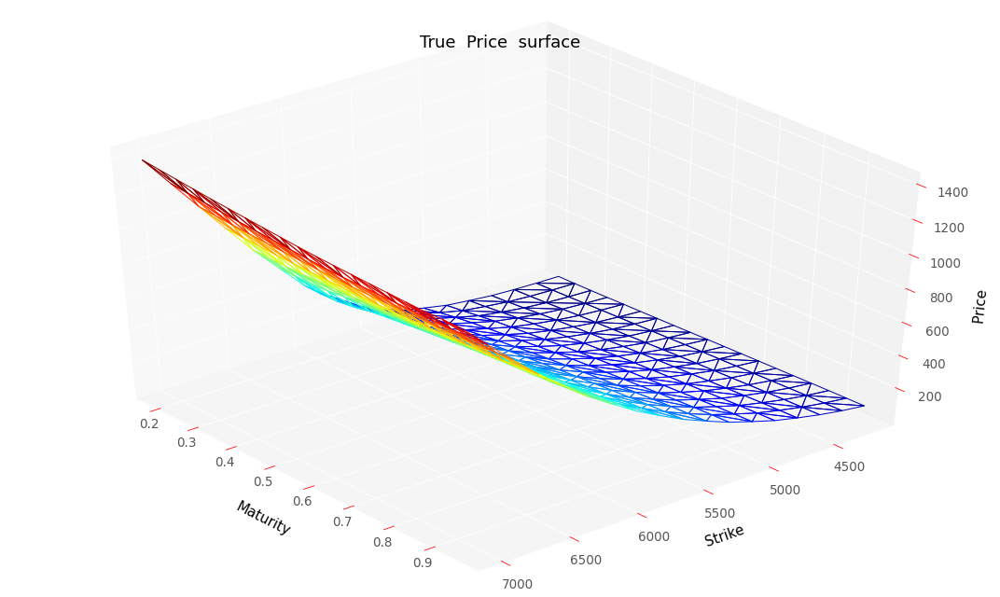

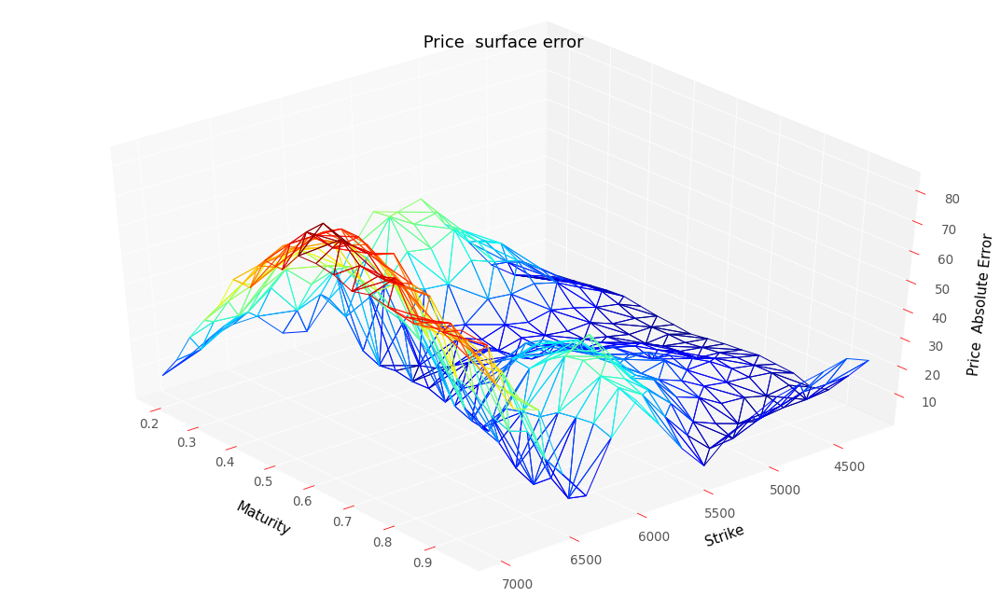

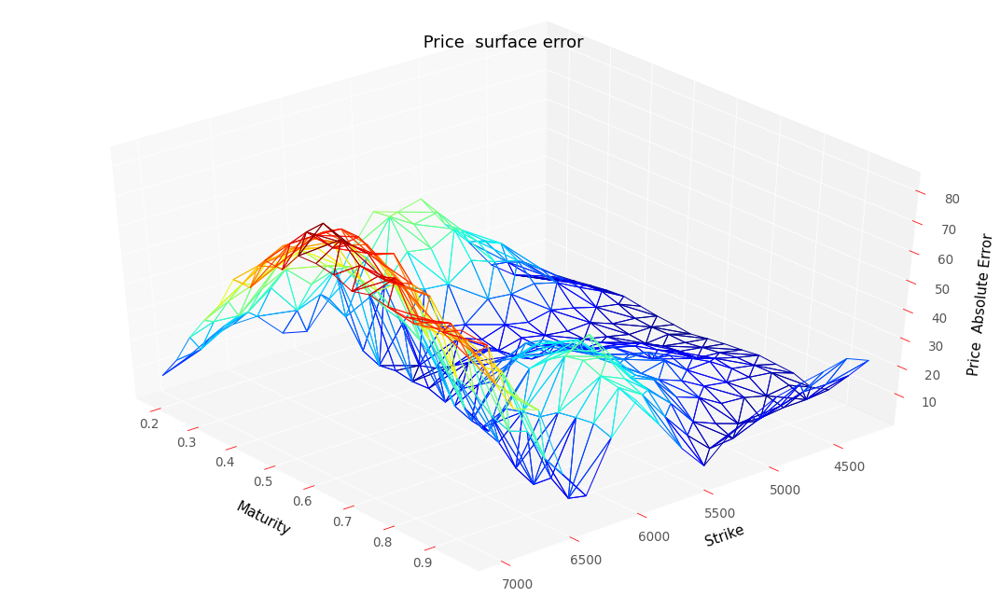

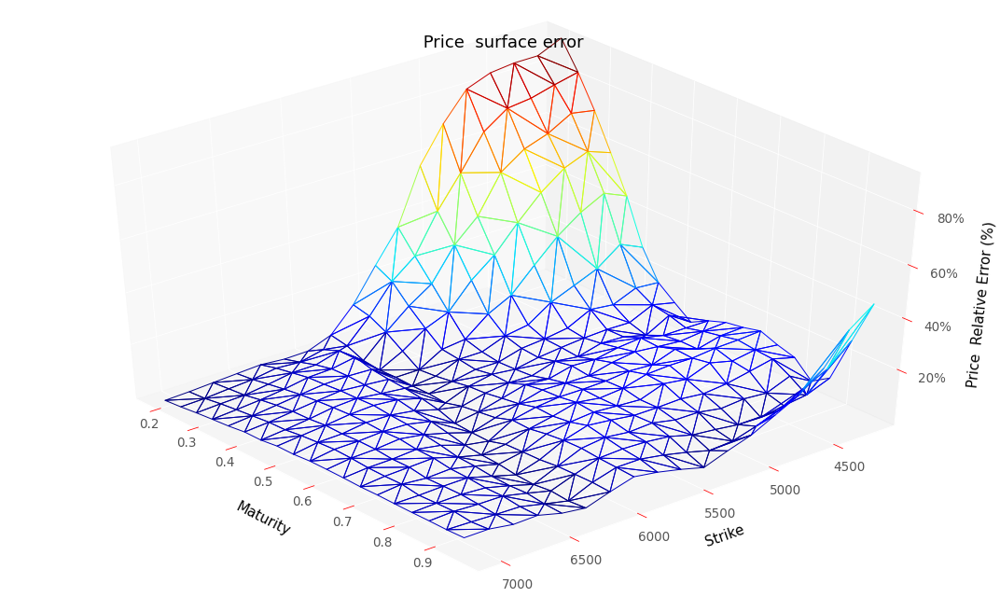

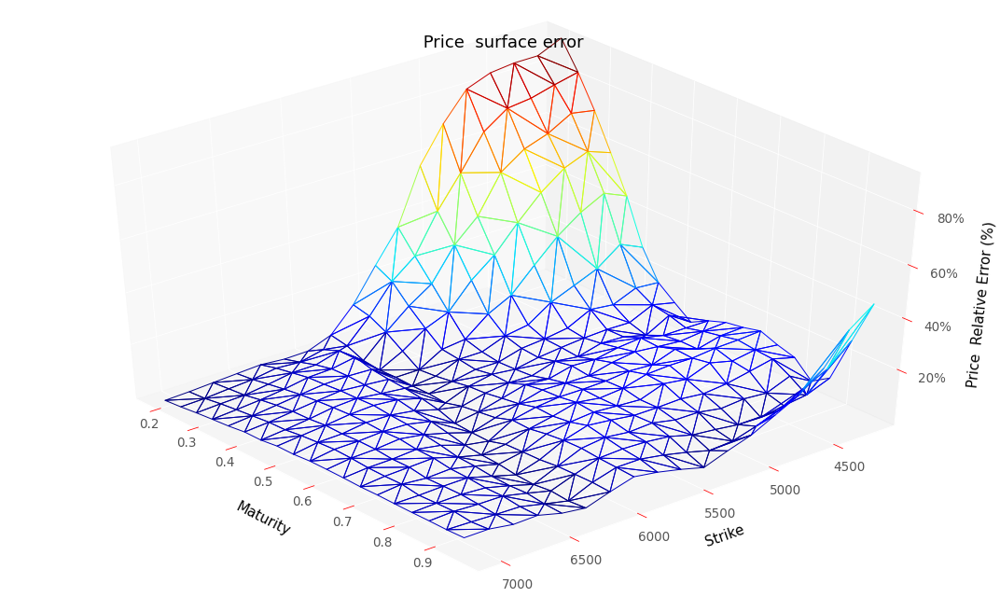

RMSE :  34.97813071719977
RMSE Relative:  0.21651736209711805
RMSE :  34.97813071719977
RMSE Relative:  0.21651736209711805


In [ ]:
plotTools.predictionDiagnosis(mcResVolLocalePrix2["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocalePrix2.to_csv("mcResVolLocaleHardPrix2.csv")

In [50]:
#PDE backtest with cranck-nicolson scheme
pdeResVolLocale2 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale2, bootstrap)
pdeResVolLocale2.head()

Strike   Maturity
4107.46  0.000       0.000000
         0.000       0.000000
         0.200       0.508162
         0.242       1.005944
         0.284       1.939602
dtype: float64

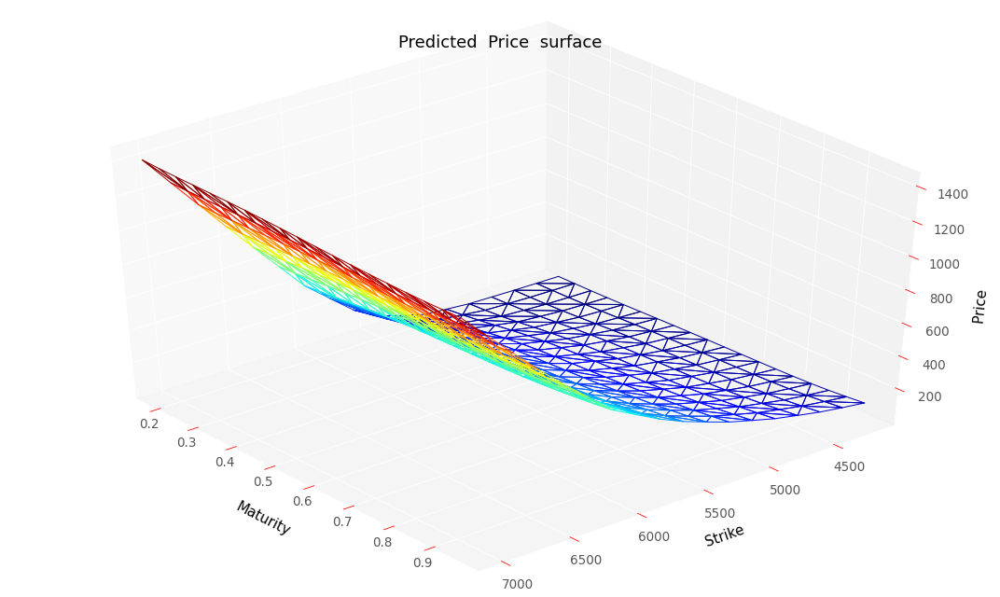

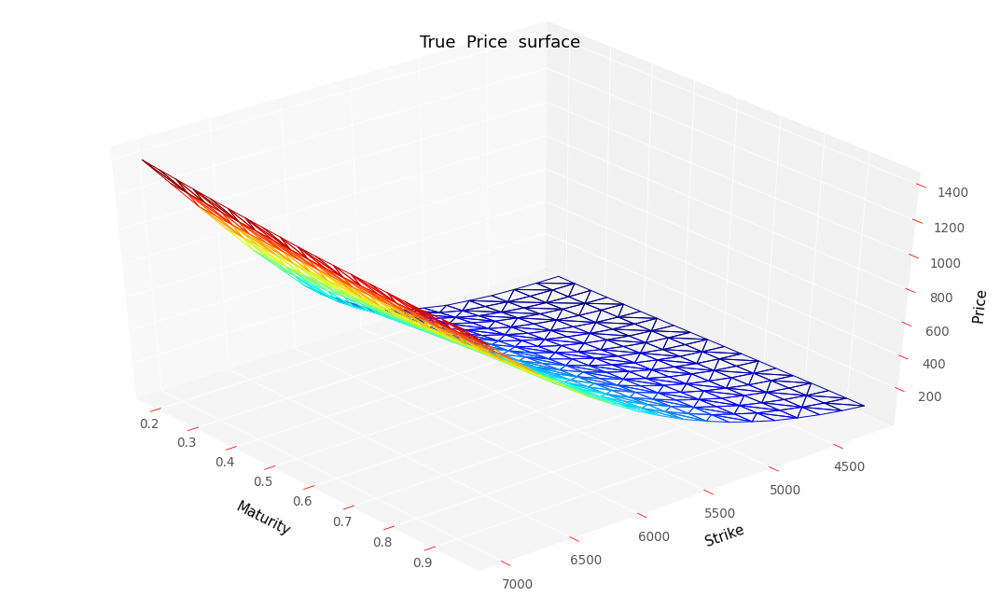

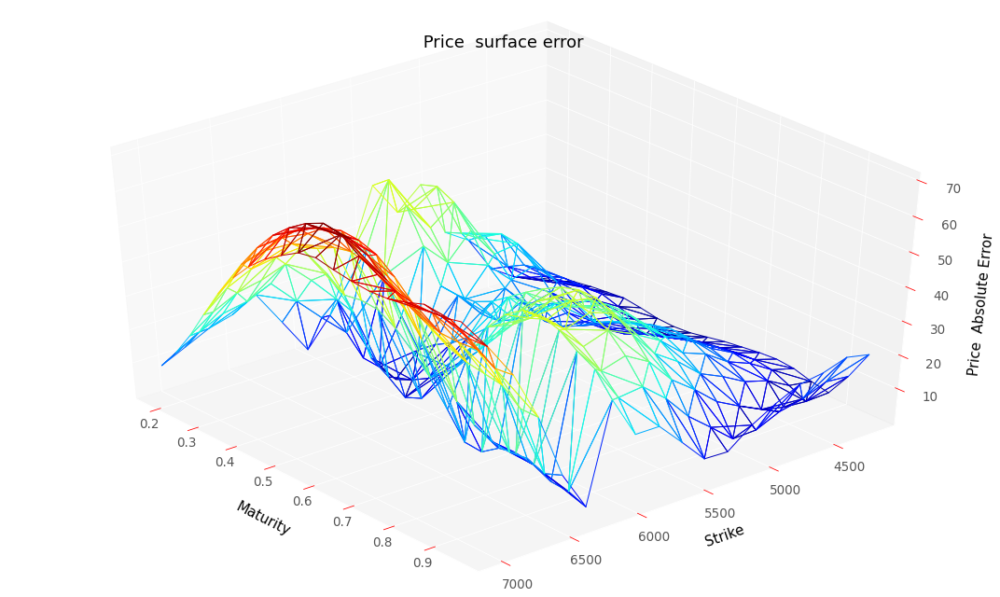

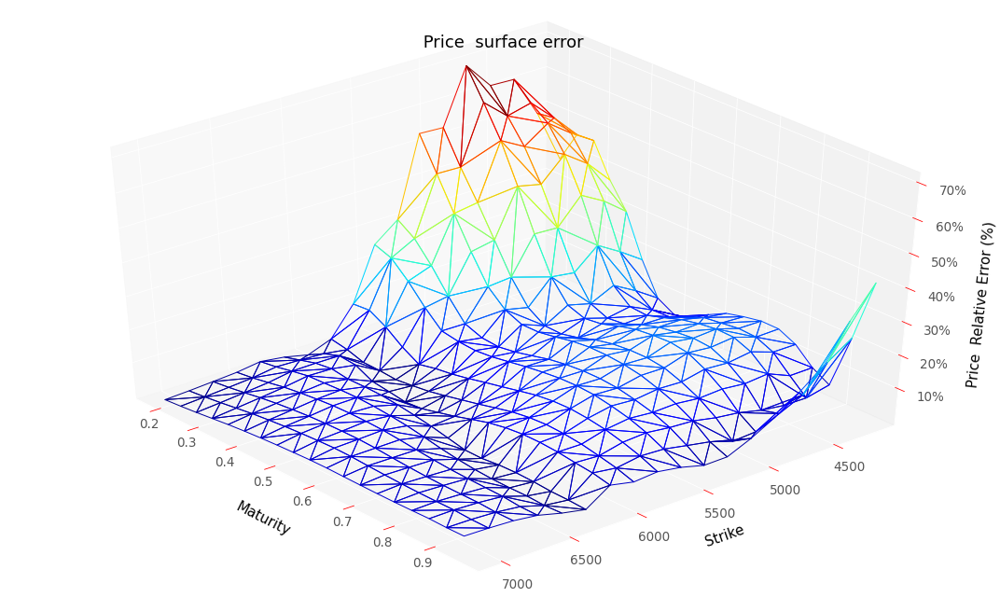

RMSE :  31.94207942562825
RMSE Relative:  0.17697178488851537


In [51]:
plotTools.predictionDiagnosis(pdeResVolLocale2, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [52]:
pdeResVolLocale2.to_csv(workingFolder + "pdeResVolLocaleHard2.csv")